# ChIP AML PiPeline v2

In [17]:
import os
from IPython.display import IFrame
import pandas as pd
import sys
sys.path.insert(0, '../..')
from JKBio.epigenetics import ChIP_helper as chiphelper
from JKBio import Helper as helper
import igv
import numpy as np
import pyBigWig
import itertools
import seaborn as sns
from scipy import stats
from matplotlib import cm
from scipy.cluster.hierarchy import linkage, leaves_list
from matplotlib import pyplot as plt
from sklearn.cluster import AgglomerativeClustering, DBSCAN, KMeans, OPTICS
from sklearn.mixture import GaussianMixture
from bokeh.plotting import *
from sklearn.manifold import MDS, TSNE
from sklearn.decomposition import PCA
from sklearn.preprocessing import scale
from pybedtools import BedTool
output_notebook()
%load_ext autoreload
%autoreload 2

Loading BokehJS ...

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## adding the data bucket to path

In [ ]:
! gcsfuse --only-dir Chip_AML jkobject data/seqs

## processing using Nextflow

In [ ]:
singleend, pairedend = chiphelper.extractPairedSingleEndFrom('data/seqs')

## Pipeline

![](images/gcpjup.png)


- Raw read QC (FastQC)
- Adapter trimming (Trim Galore!)
- Alignment (BWA)
- Mark duplicates (picard)
- Merge alignments from multiple libraries of the same sample (picard)
- Re-mark duplicates (picard)
- Filtering to remove: blacklisted regions, duplicates, primary alignments,unmapped,multiple locations, containing >  4 mismatches, insert size > 2kb, map to different chromosomes 
- Alignment-level QC and estimation of library complexity (picard, Preseq)
- Create normalised bigWig files scaled to 1 million mapped reads (BEDTools, bedGraphToBigWig)
- Generate gene-body meta-profile from bigWig files (deepTools)
- Calculate genome-wide IP enrichment relative to control (deepTools)
- Calculate strand cross-correlation peak and ChIP-seq quality measures including NSC and RSC (phantompeakqualtools)
- Call broad/narrow peaks (MACS2)
- Annotate peaks relative to gene features (HOMER)
- Create consensus peakset across all samples and create tabular file to aid in the filtering of the data (BEDTools)
- Count reads in consensus peaks (featureCounts)

![](images/nfcore.png)


In [ ]:
! nextflow cloud create 'JKcluster' -c 4

In [ ]:
! nextflow cloud create jkcluster -c "nextflow/nextflow.config" 40 && \
nextflow nf-core/chipseq -c "nextflow/nextflow.config" \
--singleEnd \
--seq_center 'DFCI' \
--email 'jkobject@gmail.com' \
--bucket-dir 'gs://jkobject/Chip_AML/nextflow/CHIPprocess_2/' \
--keyfile '~/jkobject-b6f1adaffcb8.json' \
--projectname 'jkobject' \
--zone 'us-east1-b' \
--skipDiffAnalysis \
--narrowPeak \
--design "nextflow/design.csv" \ 
--genome 'GRCh38' \
--profile gcp \
--resume \
--skipPreseq \
--max_cpus 8 && \
nextflow cloud shutdown jkclustert

## Gathering data

In [ ]:
!gsutil -m cp -r gs://amlproject/Chip/results/bwa/mergedLibrary/macs/narrowPeak/ ../data

In [ ]:
!gsutil -m cp -r gs://amlproject/Chip/results/bwa/mergedLibrary/bigwig/ ../../data

In [ ]:
!cp ../../data/narrowPeak/*MV411*.narrowPeak ../../data/MV4narrow

In [110]:
! mkdir ../../data/BroadPeaks/MV411 && mv ../../data/BroadPeaks/MV411_* ../../data/BroadPeaks/MV411/

mv: cannot stat '../../data/BroadPeaks/MV411_*': No such file or directory


In [26]:
bindings = chiphelper.loadPeaks('../../data/MV4narrow/', isMacs=False,skiprows=0)

In [27]:
broadbindings = chiphelper.loadPeaks('../../data/BroadPeaks/MV411/', isMacs=False,skiprows=0)

In [3]:
SEgenes = pd.read_csv('../data/SEgenes.csv')
CTF = pd.read_csv('../data/CTF.csv', header=None)[0].tolist()

In [4]:
CTF.extend(['GATA2','IKZF1','LYL1' ,'PU1','SMC1'])
CTF

['ARID2',
 'CEBPA',
 'CEBPE',
 'E2F3',
 'FLI1',
 'FOSL2',
 'GFI1',
 'GFI1B',
 'HHEX',
 'IRF8',
 'LYL1',
 'MEF2C',
 'MEF2D',
 'MEIS1',
 'MTF1',
 'MYB',
 'MYC',
 'PLAGL2',
 'RUNX1',
 'RUNX2',
 'RXRA',
 'SETDB1',
 'SNAPC5',
 'SP1',
 'SPI1',
 'SREBF1',
 'STAT5B',
 'TERF2',
 'TFAP4',
 'ZEB2',
 'ZFPM1',
 'ZMYND8',
 'LMO2',
 'MAX',
 'ELF2',
 'ETV6',
 'HOXA9',
 'GATA2',
 'GATA2',
 'IKZF1',
 'LYL1',
 'PU1',
 'SMC1']

In [5]:
CTF = list(set(CTF))

In [32]:
peaks = !ls ../../data/MV4narrow/*.narrowPeak
broadpeaks = ! ls ../../data/BroadPeaks/MV411/*.broadPeak
peaks = set([i.split('/')[-1].split('.')[0] for i in broadpeaks]) | set([i.split('/')[-1].split('.')[0] for i in peaks])

## looking at the data and renaming

In [33]:
peaks

{'mp106-MV411-MYB-r1',
 'mp112-MV411-CEBPA-r1',
 'mp115-MV411-PU1-r1',
 'mp116-MV411-MYB-r2',
 'mp117-MV411-POLII-r1',
 'mp118-MV411-SP1-r1',
 'mp129-MV411-RUNX1-r1',
 'mp136-MV411-H3K27ac-r1',
 'mp137-MV411-H3K4me3-r1',
 'mp138-MV411-H3K36me3-r1',
 'mp183-MV411_DMSO-H3K27ac-r1',
 'mp293-MV411-H3K79me2-r1',
 'mp299-MV411-CEBPA-r2',
 'mp300-MV411-RUNX1-r2',
 'mp301-MV411-PU1-r2',
 'mp319-MV411-FLI1-r1',
 'mp320-MV411-ZEB2-r1',
 'mp321-MV411-GFI1-r1',
 'mp324-MV411-MEF2D-r1',
 'mp325-MV411-SP1-r2',
 'mp357-MV411-ZMYND8-r1',
 'mp358-MV411-ZMYND8-r2',
 'mp359-MV411-LMO2-r1',
 'mp424-MV411-RUNX1-r3',
 'mp425-MV411-ETV6-r1',
 'mp426-MV411-SP1-r3',
 'mp427-MV411-LMO2-r2',
 'mp428-MV411-PU1-r3',
 'mp429-MV411-IRF8-r1',
 'mp430-MV411-IRF2BP2-r1',
 'mp431-MV411-IRF2BP2-r2',
 'mp433-MV411-GSE1-r1',
 'mp435-MV411-MED1-r1',
 'mp565-MV411-CDK13-r1',
 'mp568-MV411-ZEB2-r2',
 'mp569-MV411-ETV6-r2',
 'mp570-MV411-CTCF-r1',
 'mp575-MV411-IRF2BP2-r3',
 'mp577-MV411-SMC1-r1',
 'mp581-MV411-MEF2C-r1',
 'mp

In [34]:
set(bindings['name'])

{'mp106-MV411-MYB-r1',
 'mp112-MV411-CEBPA-r1',
 'mp115-MV411-PU1-r1',
 'mp116-MV411-MYB-r2',
 'mp117-MV411-POLII-r1',
 'mp118-MV411-SP1-r1',
 'mp129-MV411-RUNX1-r1',
 'mp136-MV411-H3K27ac-r1',
 'mp137-MV411-H3K4me3-r1',
 'mp138-MV411-H3K36me3-r1',
 'mp183-MV411_DMSO-H3K27ac-r1',
 'mp293-MV411-H3K79me2-r1',
 'mp299-MV411-CEBPA-r2',
 'mp300-MV411-RUNX1-r2',
 'mp301-MV411-PU1-r2',
 'mp319-MV411-FLI1-r1',
 'mp320-MV411-ZEB2-r1',
 'mp321-MV411-GFI1-r1',
 'mp324-MV411-MEF2D-r1',
 'mp325-MV411-SP1-r2',
 'mp357-MV411-ZMYND8-r1',
 'mp358-MV411-ZMYND8-r2',
 'mp359-MV411-LMO2-r1',
 'mp424-MV411-RUNX1-r3',
 'mp425-MV411-ETV6-r1',
 'mp426-MV411-SP1-r3',
 'mp427-MV411-LMO2-r2',
 'mp428-MV411-PU1-r3',
 'mp429-MV411-IRF8-r1',
 'mp430-MV411-IRF2BP2-r1',
 'mp431-MV411-IRF2BP2-r2',
 'mp433-MV411-GSE1-r1',
 'mp435-MV411-MED1-r1',
 'mp565-MV411-CDK13-r1',
 'mp568-MV411-ZEB2-r2',
 'mp569-MV411-ETV6-r2',
 'mp570-MV411-CTCF-r1',
 'mp575-MV411-IRF2BP2-r3',
 'mp577-MV411-SMC1-r1',
 'mp581-MV411-MEF2C-r1',
 'mp

In [35]:
bindings

,chrom,start,end,peak_number,foldchange,-log10pvalue,-log10qvalue,relative_summit_pos,name
0,chr1,9871,10034,MV411_2_325_R1_peak_1,5.57109,8.70544,6.08151,156,mp325-MV411-SP1-r2
1,chr1,9936,10413,MV411_8_765_R1_peak_1,6.76346,16.39293,14.03933,235,mp765-MV411-RUNX2-r4
2,chr1,9949,10426,MV411_7_764_R1_peak_1,4.73735,10.22378,8.08562,236,mp764-MV411-RUNX2-r3
3,chr1,10058,10368,MV411_4_424_R1_peak_1,10.08329,22.67156,19.41437,144,mp424-MV411-RUNX1-r3
4,chr1,10087,10317,MV411_2_614_R1_peak_1,5.91491,10.68008,6.74843,102,mp614-MV411-MEF2C-r2
...,...,...,...,...,...,...,...,...,...
2766768,chrY,56858556,56858723,MV411_2_112_R1_peak_26816,4.44683,10.80341,7.72958,122,mp112-MV411-CEBPA-r1
2766769,chrY,56859773,56859965,MV411_3_299_R1_peak_193743,3.21570,8.50020,6.46514,96,mp299-MV411-CEBPA-r2
2766770,chrY,56876514,56876695,MV411_2_429_R1_peak_66896,4.82272,7.79657,5.37607,56,mp429-MV411-IRF8-r1
2766771,chrY,56876539,56876697,MV411_3_428_R1_peak_117301,5.07913,7.33086,5.12118,25,mp428-MV411-PU1-r3


In [36]:
broadbindings

,chrom,start,end,peak_number,foldchange,-log10pvalue,-log10qvalue,name,relative_summit_pos
0,chr1,10147,10335,MV411_2_88_R1_peak_1,4.14442,5.58136,3.31624,mp88-MV411-H3K27ac-r3,188
1,chr1,180754,181052,MV411_2_88_R1_peak_2,3.16232,4.18591,2.10093,mp88-MV411-H3K27ac-r3,298
2,chr1,181115,181547,MV411_1_639_R1_peak_1,3.85919,4.86421,2.87509,mp639-MV411-MAX-r1,432
3,chr1,181388,181563,MV411_9_718_R1_peak_1,5.08100,7.51516,3.99681,mp718-MV411-IRF2BP2-r4,175
4,chr1,181407,181602,MV411_2_584_R1_peak_1,4.56132,6.24043,3.85907,mp584-MV411-MYC-r1,195
...,...,...,...,...,...,...,...,...,...
800805,chrY,56763402,56763638,MV411_3_575_R1_peak_2363,2.94849,9.23765,4.85923,mp575-MV411-IRF2BP2-r3,236
800806,chrY,56763413,56763628,MV411_1_430_R1_peak_5248,2.41318,5.65123,2.06922,mp430-MV411-IRF2BP2-r1,215
800807,chrY,56822238,56822491,MV411_2_301_R1_peak_112556,3.47139,5.47547,3.32617,mp301-MV411-PU1-r2,253
800808,chrY,56865632,56865780,MV411_9_718_R1_peak_10307,4.01875,6.12669,2.77499,mp718-MV411-IRF2BP2-r4,148


In [38]:
bindings = bindings[~bindings.name.isin(set(broadbindings.name))]

In [40]:
bindings = bindings.append(broadbindings)

/home/jeremie/.local/lib/python3.7/site-packages/pandas/core/frame.py:7138: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,


In [41]:
len(bindings)

2819569

In [42]:
bindings['replicate']= [i.split('-')[-1][-1] for i in bindings['name']]
bindings['tf'] = [i.split('-')[2] for i in bindings['name']]

In [43]:
bindings['peak_number'] = ['_'.join([i.split('_')[2],i.split('_')[5]]) for i in bindings['peak_number']]

In [44]:
bindings

,-log10pvalue,-log10qvalue,chrom,end,foldchange,name,peak_number,relative_summit_pos,start,replicate,tf
0,8.70544,6.08151,chr1,10034,5.57109,mp325-MV411-SP1-r2,325_1,156,9871,2,SP1
1,16.39293,14.03933,chr1,10413,6.76346,mp765-MV411-RUNX2-r4,765_1,235,9936,4,RUNX2
2,10.22378,8.08562,chr1,10426,4.73735,mp764-MV411-RUNX2-r3,764_1,236,9949,3,RUNX2
3,22.67156,19.41437,chr1,10368,10.08329,mp424-MV411-RUNX1-r3,424_1,144,10058,3,RUNX1
4,10.68008,6.74843,chr1,10317,5.91491,mp614-MV411-MEF2C-r2,614_1,102,10087,2,MEF2C
...,...,...,...,...,...,...,...,...,...,...,...
800805,9.23765,4.85923,chrY,56763638,2.94849,mp575-MV411-IRF2BP2-r3,575_2363,236,56763402,3,IRF2BP2
800806,5.65123,2.06922,chrY,56763628,2.41318,mp430-MV411-IRF2BP2-r1,430_5248,215,56763413,1,IRF2BP2
800807,5.47547,3.32617,chrY,56822491,3.47139,mp301-MV411-PU1-r2,301_112556,253,56822238,2,PU1
800808,6.12669,2.77499,chrY,56865780,4.01875,mp718-MV411-IRF2BP2-r4,718_10307,148,56865632,4,IRF2BP2


In [45]:
bindings.to_csv('../temp/bindings.bed',sep='\t',index=False)

In [3]:
bindings= pd.read_csv('../temp/bindings.bed',sep='\t',header=None, index_col=None,
                     names=["-log10pvalue","-log10qvalue", "chrom", "end", "foldchange", "name", "peak_number", "relative_summit_pos", "start", "replicate","tf"])

In [276]:
bindings

,-log10pvalue,-log10qvalue,chrom,end,foldchange,name,peak_number,relative_summit_pos,start,replicate,tf
0,8.70544,6.08151,chr1,10034,5.57109,mp325-MV411-SP1-r2,325_1,156,9871,2,SP1
1,16.39293,14.03933,chr1,10413,6.76346,mp765-MV411-RUNX2-r4,765_1,235,9936,4,RUNX2
2,10.22378,8.08562,chr1,10426,4.73735,mp764-MV411-RUNX2-r3,764_1,236,9949,3,RUNX2
3,22.67156,19.41437,chr1,10368,10.08329,mp424-MV411-RUNX1-r3,424_1,144,10058,3,RUNX1
4,10.68008,6.74843,chr1,10317,5.91491,mp614-MV411-MEF2C-r2,614_1,102,10087,2,MEF2C
...,...,...,...,...,...,...,...,...,...,...,...
2819564,9.23765,4.85923,chrY,56763638,2.94849,mp575-MV411-IRF2BP2-r3,575_2363,236,56763402,3,IRF2BP2
2819565,5.65123,2.06922,chrY,56763628,2.41318,mp430-MV411-IRF2BP2-r1,430_5248,215,56763413,1,IRF2BP2
2819566,5.47547,3.32617,chrY,56822491,3.47139,mp301-MV411-PU1-r2,301_112556,253,56822238,2,PU1
2819567,6.12669,2.77499,chrY,56865780,4.01875,mp718-MV411-IRF2BP2-r4,718_10307,148,56865632,4,IRF2BP2


In [20]:
from gsheets import Sheets
sheets = Sheets.from_files('~/.client_secret.json', '~/.storage.json')
url="https://docs.google.com/spreadsheets/d/1yFLjYB1McU530JnLgL0QIMAKIkVl3kl0_LCHje2gk8U"
gsheet = sheets.get(url).sheets[2].to_frame()
gsheet

,id,cell line,replicate,protein,quality,matching input name,processed,name,previous name,bigwig,...,ratio to droso,unique mapped reads(droso),scaling factor,Total QC,folderNarrow,folderCompensated,folderQC,folderBroad,folder Bigwig,folder diffPeaks
0,mp100,U937,1,INPUT,NaN,NaN,Y,mp100-U937-INPUT-r1,NaN,https://console.cloud.google.com/storage/brows...,...,NaN,NaN,NaN,https://storage.cloud.google.com/amlproject/Ch...,https://console.cloud.google.com/storage/brows...,NaN,https://console.cloud.google.com/storage/brows...,https://console.cloud.google.com/storage/brows...,https://console.cloud.google.com/storage/brows...,NaN
1,mp101,NOMO1,1,INPUT,NaN,NaN,Y,mp101-NOMO1-INPUT-r1,NaN,https://console.cloud.google.com/storage/brows...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,mp102,UT7,1,INPUT,NaN,NaN,Y,mp102-UT7-INPUT-r1,NaN,https://console.cloud.google.com/storage/brows...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,mp106,MV411,1,MYB,x,INPUT_MV411,Y,mp106-MV411-MYB-r1,NaN,https://console.cloud.google.com/storage/brows...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,mp109,M6,1,CEBPA,x,INPUT_M6,Y,mp109-M6-CEBPA-r1,NaN,https://console.cloud.google.com/storage/brows...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
281,mp853,MV411_IRF2BP_VHL_6h,5,MED1,NaN,INPUT_MV411,NaN,mp853-MV411_IRF2BP_VHL_6h-MED1-r5,20200302_8_MP7868_S58_R1_001,https://console.cloud.google.com/storage/brows...,...,0.033200,912539.0,0.902119,NaN,NaN,NaN,NaN,NaN,NaN,NaN
282,mp854,MV411_IRF2BP_VHL_6h,3,FLAG_IRF2BP2,NaN,INPUT_MV411,NaN,mp854-MV411_IRF2BP_VHL_6h-FLAG_IRF2BP2-r3,20200302_9_MP7868_S59_R1_001,https://console.cloud.google.com/storage/brows...,...,0.043080,920224.0,0.186965,NaN,NaN,NaN,NaN,NaN,NaN,NaN
283,mp855,MV411_IRF2BP_VHL_6h,3,POLII_total,NaN,INPUT_MV411,NaN,mp855-MV411_IRF2BP_VHL_6h-POLII_total-r3,20200302_10_MP7868_S60_R1_001,https://console.cloud.google.com/storage/brows...,...,0.022331,601143.0,0.550032,NaN,NaN,NaN,NaN,NaN,NaN,NaN
284,mp856,MV411_IRF2BP_VHL_6h,3,POLII_S2,NaN,INPUT_MV411,NaN,mp856-MV411_IRF2BP_VHL_6h-POLII_S2-r3,20200302_11_MP7868_S61_R1_001,https://console.cloud.google.com/storage/brows...,...,0.021828,464172.0,0.604606,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [21]:
bw = ! ls ../../data/bigwig
bw

['IGG_MV411_R1.mLb.clN.bigWig',
 'INPUT_MV411_R1.mLb.clN.bigWig',
 'mp106-MV411-MYB-r1.mLb.clN.bigWig',
 'mp112-MV411-CEBPA-r1.mLb.clN.bigWig',
 'mp115-MV411-PU1-r1.mLb.clN.bigWig',
 'mp116-MV411-MYB-r2.mLb.clN.bigWig',
 'mp117-MV411-POLII-r1.mLb.clN.bigWig',
 'mp118-MV411-SP1-r1.mLb.clN.bigWig',
 'mp129-MV411-RUNX1-r1.mLb.clN.bigWig',
 'mp136-MV411-H3K27ac-r1.mLb.clN.bigWig',
 'mp137-MV411-H3K4me3-r1.mLb.clN.bigWig',
 'mp138-MV411-H3K36me3-r1.mLb.clN.bigWig',
 'mp183-MV411_DMSO-H3K27ac-r1.mLb.clN.bigWig',
 'mp293-MV411-H3K79me2-r1.mLb.clN.bigWig',
 'mp299-MV411-CEBPA-r2.mLb.clN.bigWig',
 'mp300-MV411-RUNX1-r2.mLb.clN.bigWig',
 'mp301-MV411-PU1-r2.mLb.clN.bigWig',
 'mp319-MV411-FLI1-r1.mLb.clN.bigWig',
 'mp320-MV411-ZEB2-r1.mLb.clN.bigWig',
 'mp321-MV411-GFI1-r1.mLb.clN.bigWig',
 'mp324-MV411-MEF2D-r1.mLb.clN.bigWig',
 'mp325-MV411-SP1-r2.mLb.clN.bigWig',
 'mp357-MV411-ZMYND8-r1.mLb.clN.bigWig',
 'mp358-MV411-ZMYND8-r2.mLb.clN.bigWig',
 'mp359-MV411-LMO2-r1.mLb.clN.bigWig',
 'mp424-MV4

In [46]:
len(set(bindings.name))

84

In [25]:
len(bw)

86

In [48]:
# ONE off
for i in bw[2:]:
    a = gsheet[gsheet.id=='mp'+i.split('_')[2]].name.values[0]
    i = '../../data/bigwig/'+i
    a = '../../data/bigwig/'+a+'.mLb.clN.bigWig'
    ! mv $i $a
    print(a)

IndexError: list index out of range

In [22]:
set(bindings.name)

{'mp106-MV411-MYB-r1',
 'mp112-MV411-CEBPA-r1',
 'mp115-MV411-PU1-r1',
 'mp116-MV411-MYB-r2',
 'mp117-MV411-POLII-r1',
 'mp118-MV411-SP1-r1',
 'mp129-MV411-RUNX1-r1',
 'mp136-MV411-H3K27ac-r1',
 'mp137-MV411-H3K4me3-r1',
 'mp138-MV411-H3K36me3-r1',
 'mp183-MV411_DMSO-H3K27ac-r1',
 'mp293-MV411-H3K79me2-r1',
 'mp299-MV411-CEBPA-r2',
 'mp300-MV411-RUNX1-r2',
 'mp301-MV411-PU1-r2',
 'mp319-MV411-FLI1-r1',
 'mp320-MV411-ZEB2-r1',
 'mp321-MV411-GFI1-r1',
 'mp324-MV411-MEF2D-r1',
 'mp325-MV411-SP1-r2',
 'mp357-MV411-ZMYND8-r1',
 'mp358-MV411-ZMYND8-r2',
 'mp359-MV411-LMO2-r1',
 'mp424-MV411-RUNX1-r3',
 'mp425-MV411-ETV6-r1',
 'mp426-MV411-SP1-r3',
 'mp427-MV411-LMO2-r2',
 'mp428-MV411-PU1-r3',
 'mp429-MV411-IRF8-r1',
 'mp430-MV411-IRF2BP2-r1',
 'mp431-MV411-IRF2BP2-r2',
 'mp433-MV411-GSE1-r1',
 'mp435-MV411-MED1-r1',
 'mp565-MV411-CDK13-r1',
 'mp568-MV411-ZEB2-r2',
 'mp569-MV411-ETV6-r2',
 'mp570-MV411-CTCF-r1',
 'mp575-MV411-IRF2BP2-r3',
 'mp577-MV411-SMC1-r1',
 'mp581-MV411-MEF2C-r1',
 'mp

In [ ]:
replicates = chiphelper.findReplicates(folder='data/seqs/results/bwa/', sep='_', namings='_R([0-9])',namepos=0)

## Visual inspection of the features and and look at QCs

### [igv tracks](https://igv.org/app/?sessionURL=blob:3Z3rU9rcFsb_lU6.vO.Zg0EIcvGbolinYB0vp5czHSeEGFIhscmOaJ3.790hwMbzsrZZ9rTJIx.YAfIk62HxY7Mfcnk0IvfajdzAcY3dR8MfGbvG2Kt1jIoR2FP5nPE2mdrBm7.7Z92x1aqmr_1Lvnhtx8K.POuniwtxG.9Wq7FljhJ7Ip93bswk3nLlIls1057a38PAnsWmE06rvndnDqPQHvlBLHyRCNcMI6_quUE4deNq7H6bb2J.Z843IjfmByP3_o9sTN77coPOgwiHdjD6jdtMN7EvN2GKe2H8qBiT0EliY_e_hj2ZGF8qhojkVtInHg3xcJs2QkqTeZ8qRhiN3MjYlRtvdVrNjlWzGu1m3arttNx_W9tt2bvw_NYPgnQhESXuj8qjkUQTuRIvNfL1Jhx.dR1R7Y7926u9Qb8auXEyEXF1OLOrUzfy3FHfH0Z29FAd.t7M96q9_nHt6qxmTvtD05mcmPLpD773pDdBMpmsSttefX5IpRNOQrmkEXnDv7cr25Vaq51.suyJ6G5.Zez63lgYu5ZcuZ2I8NyxJ3ILqcGKMZOFhLNeEjjCDwMpnrp2IEV3fuwP_YkvHj7Ml5CvbNXk85PQW.ivZUvlCv7nLZMfcX_iPuchDpPIcS.yBqWCFI0wmtqyTCN76.QziwZmD9LKY1U5qzWBHUXh7NS1b5YNubqVD2JTvUC3pLZqyV9T28mEf_1KH.pP.7B4H__RCCdMAqHpRI43fpNL7VufLZmq1NtvB0Eo7HlRFWNq35.FM8nXzrZ0IeXCjdJ1zRF0xlE4DWMJrFxSkusaX36doKMej6D6ql2kEogg0kNxBC1KYhBkARKkcYlG0PHJ6eUFB6HGql.0FIgh2sQfhmhjdwaHvfoBpzs7q.7QUqDu0CaK.4pb1sT4jmsCfsfpbKJ9yZ1esn4ltFbtooRACFEWigMoq4iBTzr3QsOHNokGz_kpC56amhJRSiB6KAvF0ZNVxJmiqkkPDj60SzR8Ph_u11n8qAkRKQUCiPRQHEGLkjgIqUkPDkIam2gMdQ_3T_dYEKl5EK0Foog2URxGy5o4HCFOhHQ.QUGq5wdJzYVoLR5IG0wUDlKdAxLilEjnEw6ki26PNSB1FEeUFAkjykOBFGUlMSBKP_J4ENE20Rg6GJy_v2qPr95a7.ot.f5z_sdTIUOetQCRlcdOcZD9szoOb4hBRD7HqOgN9j6ysFPZxHNrAESOslI8blllHNQQA4vn3UJi9pLhTcUXz64CDbQSD2wvG9UQM40cdtFYO.z3WDl7XSUbpBSILdJDcUwtSuKwhBhraGxiMpQ_HayrVIOUwjFUqmxwURJnf0rEVENjE46hi_80OeOQpaIMUorEEOWhQIaykjgMISYVGpuYDOUfhyyVS5BSOIbKNQ5lJXEYQowgNDYxGbLyM6QyB1IKx9AGD0UzZHEYQswWNDbhDi_bu9hjhQqWChVoLdIRZqSJAg8xW9TE4QgxV9D5BAWJ8YtOJQu0Fg.kUv2mW9bEAKmBGC7ofMKBdH7IOhqjodIFUoqEEeWhQIqykjgQIaYLGpuYDOUfixoqXSClcAyVayTKSuIwhJguaGyiMfSCnRoaKmB4JfszlHNXhhftxdBATBpe1w4Mx0dHLJxU1EApkU7DQVgoDqOsIg5CiCED7RIOn3efe7ypkYoYaC0SQqSJAiFa1MTAaAcxYtD5BAUp__xoR2UMtBYPpFLNkJY1cUBCjBl0PuFAOuvV909Z_x_tqKhBp0aCSWOjQJxWVXGAQswc9E5hkWKMTip20KkRkSrXCLWqioMUYuygdwqLVP5dhXbWogeNGhGpUu0wpKriIAUZQ2idwiLVyI_UWhihUSMitcFGCZBqcE7fChlJaJ0CItXmTKSaa5kEJcWCabOHQklKS.JgBBlI0DbRGOoP3rPCiKYKI0gpEEOkh.IYWpTEYQgxg9DYxGQof_rQVOkDKYVjqFS5w6IkDkOIoYPGJhxDn_qsP2qbKm4gpUgMUR4KZCgricMQYsqgsYnGEPPEXU0VL7yCE3aV70Rd7BN0tRAjhddzYq7B4QHvijAqTiClUJdVIjwUeVWleUkchBDjBI1NPIZ69S4LIpUn0Fqwi5NtNlHsxcnSmjgcIUYKOp.gIOUPFVpPr_K3WYsHUqlihWVNHJBQL_NH.QQFKf.ODC2VLNBaPJBKtRPDsiYOSIjhgs4nHkjH57z50Vq.QGqhQKJMFAlSVhPnwpmQKYPGJxxIn_Y5GLXXYgZCiQQRYaFAhOYVcQCCzBhIl5D45J8XtdcCBkKJhk.55kTzijj4QEYLpEs8fFj5XHstViCUUPiULpubV8TBBzJQIF1C4sMYfdbCBEKJhk_JRh9mHteGjBFIl2j4nL7vHx.zxh8VItBaIIRoE8VBtKyJgVEHMUTQ.UQD6ezy5CMrjeuoGIHWAoFEmygOpGVNHJAQwwSdT0SQWEdAdFSgQGvBQCrbMRDLmjggIcYKOp9oIJ0PurwBSSULpBQII9JDcRQtSuJAhBguaGyiMfT5cJ91JFFHxQukFIgh0kNxDC1K4jCEmDBobMIxNPh0csA6LryjMgaNGIkj2kWBJC2LYrBUSz80eDDpnKLilH9Qqm2rqEGjBuTpt41My.mAex27394cydbF6.uJ3Ot5OyuLXo6FuE3bGVvmKJHlC9u5MZN4y7VjsVUz7an9PQzsWWw64bTqe3dmGHmmXIP8ZMTVsVfryLZfp1sx4zAS7sgU98L0vj9p6e_aiCmG_sa.bMlPTeROwzt7uNYW9UWQ3vRtokxt6tH_Ba4vP34C)

### [multiQC](http://35.184.213.1:8888/view/data/results/multiqc/multiqc_report.html)

### process: 

look at all t with a very low frip score as noted by encode. 

look at all peaks tracks together and see for location of intense co binding. 

- if we can discern peaks and if, for some reasons, some good peaks are not called by macs. 
- if looks good and we can see a lot of peaks. 
- if a lot of noise but seems consistent with replicates. 
- if just seems to have very few peaks.

Validate still but flag as potentially bad.

Else remove.

### results:

In [7]:
bad=[
"mp168",
"mp129",
"mp128",
"mp773",
"mp774",
"mp575",
"mp614",
"mp714",
"mp433",
"mp156",
"mp650",
"mp604",
"mp27",
"mp627",
"mp117",
"mp771",
"mp118",
"mp431",
"mp430",
"mp324",
"mp565",
"mp569",
"mp125",
"mp627",
"mp568",
"mp427",
"mp124",
"mp716",
"mp581",
"mp589",
"mp321",
"mp601",
"mp745",
"mp772",
"mp770",
"mp590",
"mp623",
"mp718"]

## merging duplicates

/!/ should only be passed peaks with at least one good replicate
merging H3K27ac peaks
finish first overlaps lookup


/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:15: UserWarning: `get_labels()` is retained for backwards compatibility; use `generate_petal_labels()` or the higher level `venn()` instead
  warn((
/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:30: UserWarning: `venn6()` is retained for backwards compatibility; use `venn()` instead
  warn((


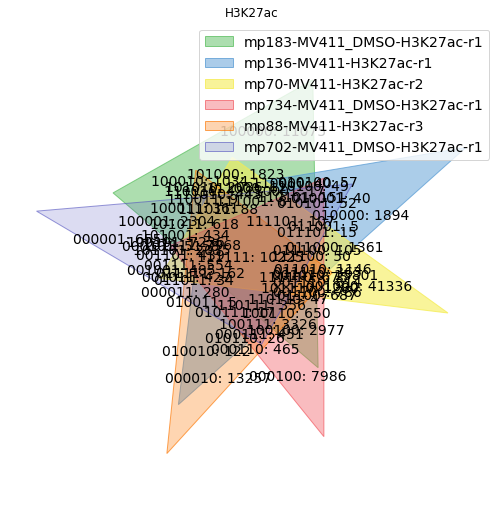

found total peak for this replicate set: [58264 17774 92422 55269 63133 49918]


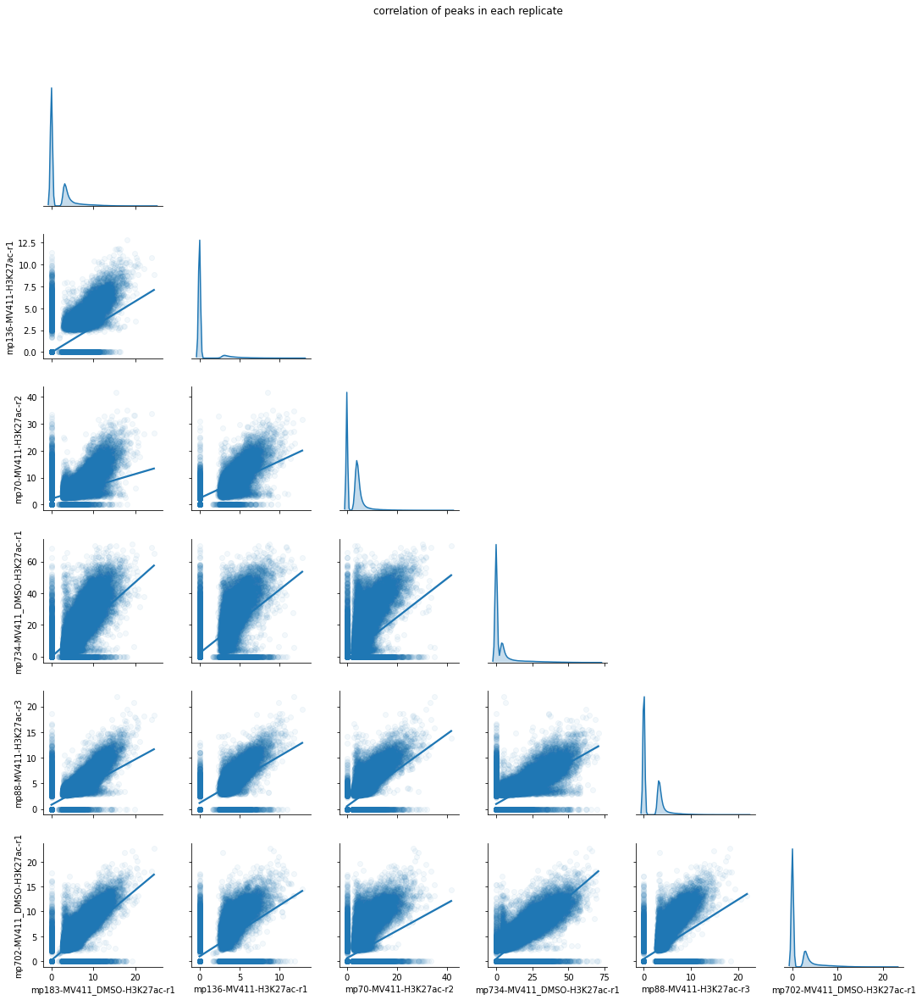

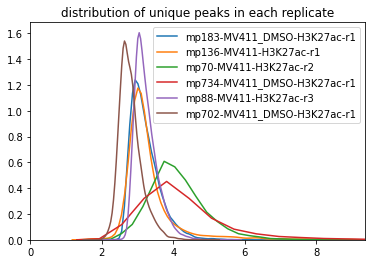

main rep is: mp70-MV411-H3K27ac-r2
mp88-MV411-H3K27ac-r3
overlap: 46.18380904979334%


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in 

4.566751159767021 59.99586699238654 []
enough overlap


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in 

3.9836066952883655 31.04046550469226
we have recovered 4454 peaks, equal to 4.728087215906076% of the peaks in main replicate
mp183-MV411_DMSO-H3K27ac-r1
overlap: 30.93311116400857%


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in 

4.0431644289418145 71.2581424171932 []
enough overlap
we have recovered 11237 peaks, equal to 11.928494846236319% of the peaks in main replicate
not enough overlap to advice to merge the bams.
oldnew overlap: 37.062513932677305%
                            new overlap: 37.062513932677305%
mp734-MV411_DMSO-H3K27ac-r1
overlap: 28.418558351907553%


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: divide by zero encountered in log
  bw = pyBigWig.open(filepath)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2644: RuntimeWarning: invalid value encountered in double_scalars
  if (fx2 - fval) > delta:
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2653: RuntimeWarning: invalid value encountered in double_scalars
  if 2.0 * (fx - fval) <= bnd:
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in power
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Pow

0.15521763999621374 126.36395110755977 []
enough overlap
we have recovered 35561 peaks, equal to 37.749328577646146% of the peaks in main replicate
mp702-MV411_DMSO-H3K27ac-r1
overlap: 25.539373742182597%


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in 

0.17103892143839006 101.35630092319843 []
enough overlap
we have recovered 52509 peaks, equal to 55.74026304894748% of the peaks in main replicate
mp136-MV411-H3K27ac-r1
overlap: 16.066520958213413%
not enough overlap


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in 

5.893623734901306 66.31397446936982 []
we did not had enough initial overlap.
enough overlap
we have recovered 52810 peaks, equal to 56.05978578176916% of the peaks in main replicate
enough from small overlap to advice to merge the peaks


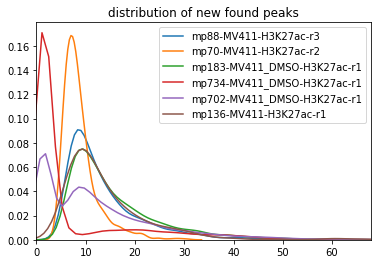

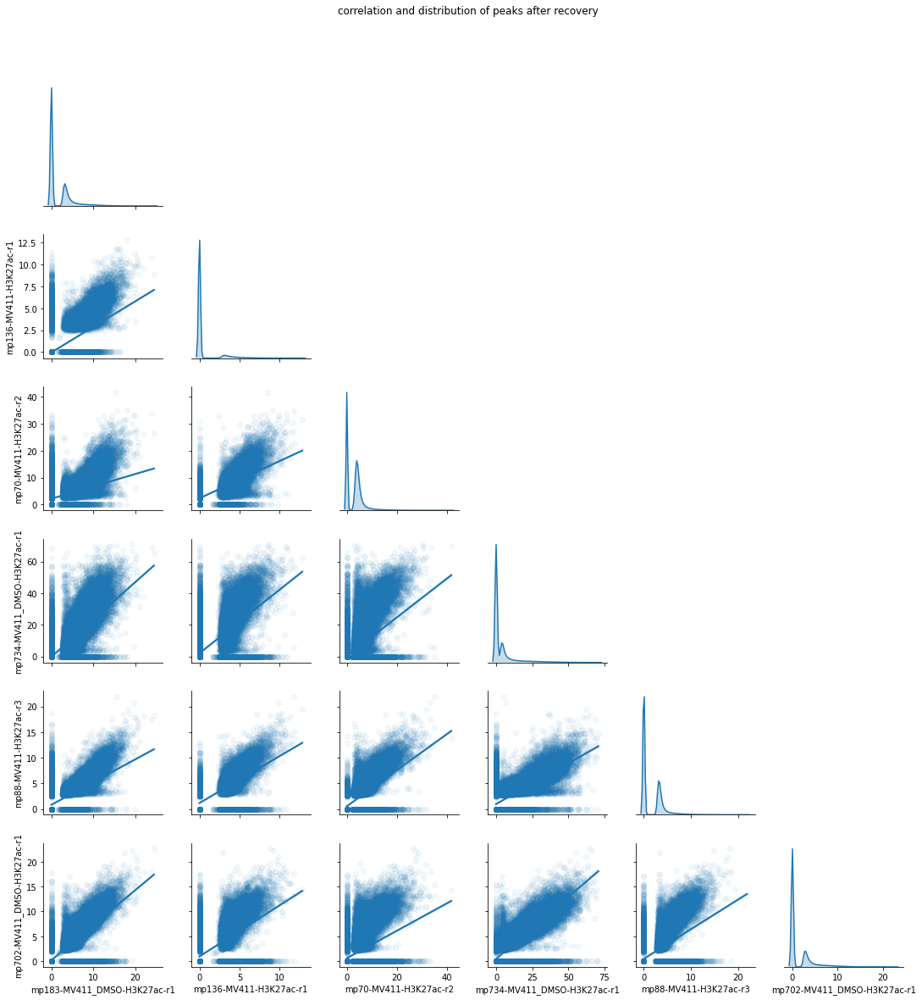

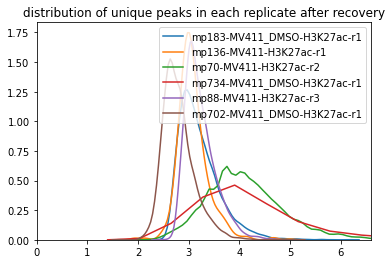

/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:15: UserWarning: `get_labels()` is retained for backwards compatibility; use `generate_petal_labels()` or the higher level `venn()` instead
  warn((
/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:30: UserWarning: `venn6()` is retained for backwards compatibility; use `venn()` instead
  warn((


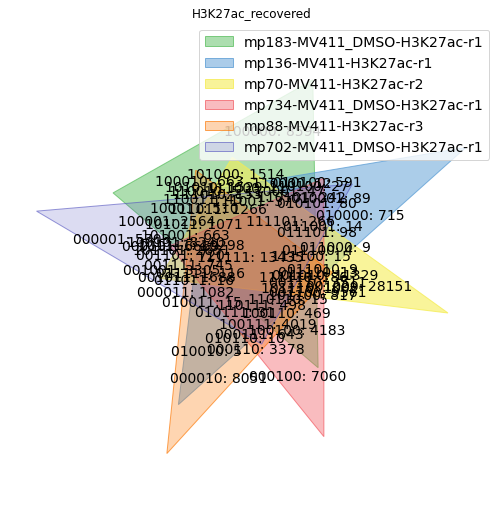

H3K27ac 128335
merging JUND peaks
finish first overlaps lookup


/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:30: UserWarning: `venn2()` is retained for backwards compatibility; use `venn()` instead
  warn((


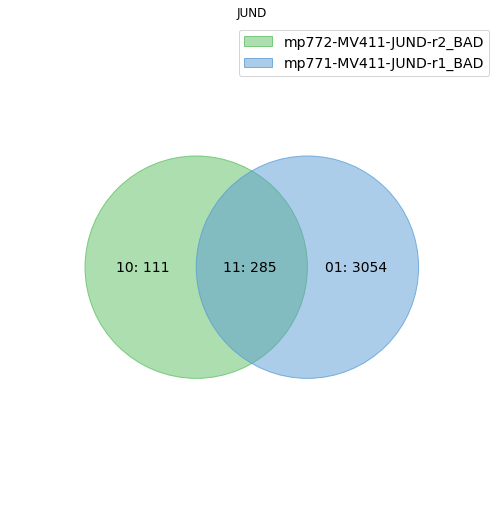

found total peak for this replicate set: [ 396 3339]
no peaks were good enough quality
wrong TF: JUND


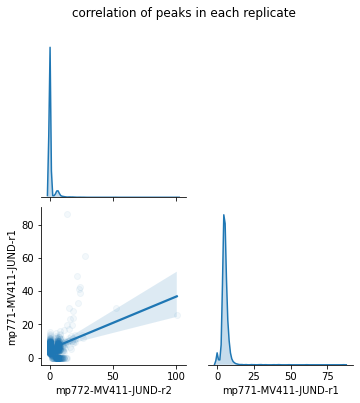

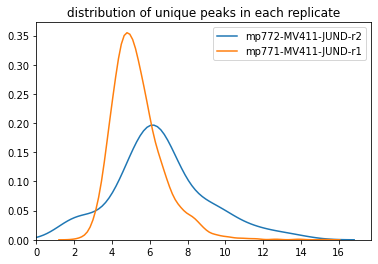

main rep is: mp772-MV411-JUND-r2
mp771-MV411-JUND-r1
overlap: 71.96969696969697%


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: divide by zero encountered in log
  bw = pyBigWig.open(filepath)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2644: RuntimeWarning: invalid value encountered in double_scalars
  if (fx2 - fval) > delta:
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2653: RuntimeWarning: invalid value encountered in double_scalars
  if 2.0 * (fx - fval) <= bnd:
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflo

6.447604368774627 79.70097316269296 []
enough overlap


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in 

5.553420101735967 26.166475217490035
we have recovered 401 peaks, equal to 52.213541666666664% of the peaks in main replicate


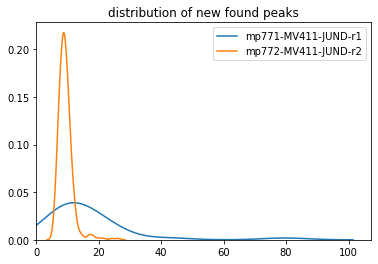

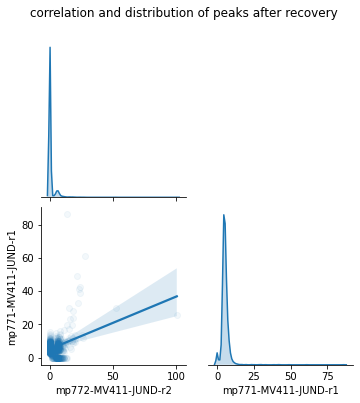

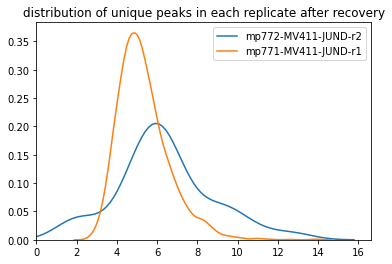

merging MYB peaks
finish first overlaps lookup


/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:15: UserWarning: `get_labels()` is retained for backwards compatibility; use `generate_petal_labels()` or the higher level `venn()` instead
  warn((
/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:30: UserWarning: `venn2()` is retained for backwards compatibility; use `venn()` instead
  warn((


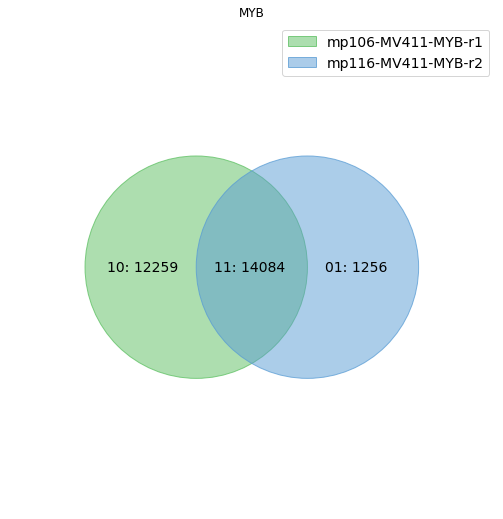

found total peak for this replicate set: [26343 15340]


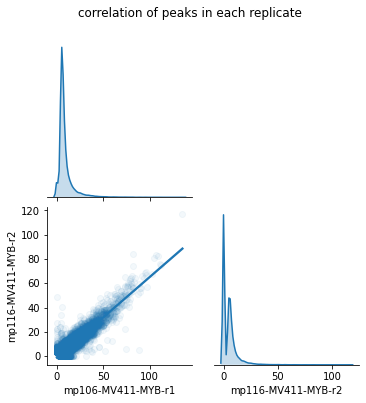

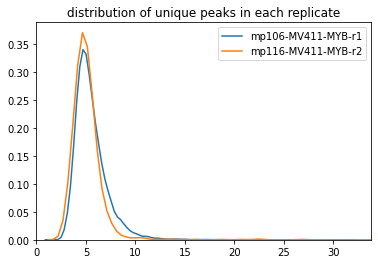

main rep is: mp106-MV411-MYB-r1
mp116-MV411-MYB-r2
overlap: 53.46391830846904%


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))
../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: divide by zero encountered in log
  bw = pyBigWig.open(filepath)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2644: RuntimeWarning: invalid value encountered in double_scalars
  if (fx2 - fval) > delta:
/home/jeremie/.local/lib/python3.8/site-packages/scipy/opti

1.6217497332710058 52.193216210232755 []
enough overlap


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: divide by zero encountered in log
  bw = pyBigWig.open(filepath)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2644: RuntimeWarning: invalid value encountered in double_scalars
  if (fx2 - fval) > delta:
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2653: RuntimeWarning: invalid value encountered in double_scalars
  if 2.0 * (fx - fval) <= bnd:
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflo

1.8599135382961507 66.08142568799634
we have recovered 669 peaks, equal to 2.528822528822529% of the peaks in main replicate


../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))


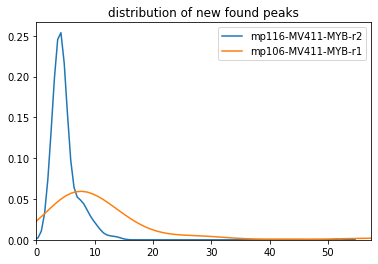

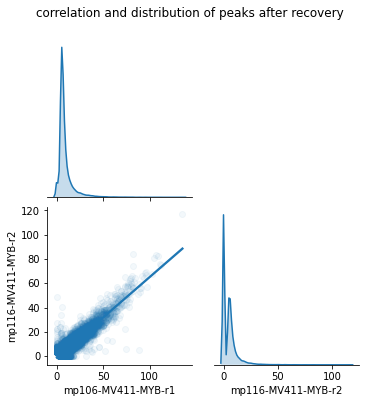

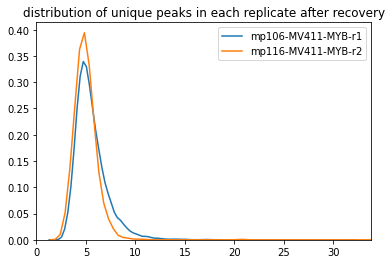

/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:15: UserWarning: `get_labels()` is retained for backwards compatibility; use `generate_petal_labels()` or the higher level `venn()` instead
  warn((
/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:30: UserWarning: `venn2()` is retained for backwards compatibility; use `venn()` instead
  warn((


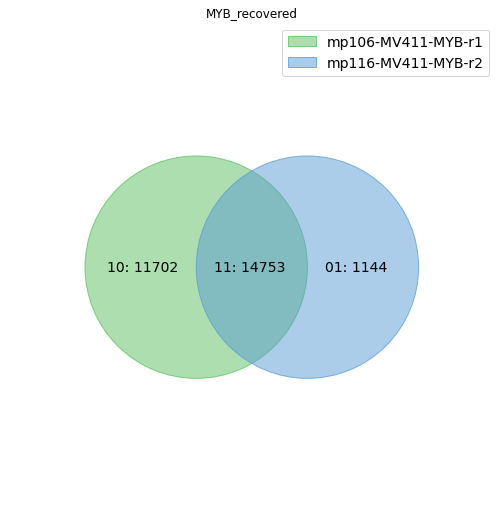

MYB 26455
merging GATA2 peaks
finish first overlaps lookup


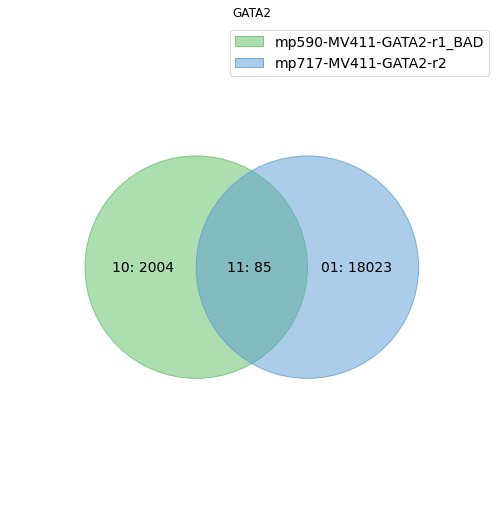

found total peak for this replicate set: [ 2089 18108]


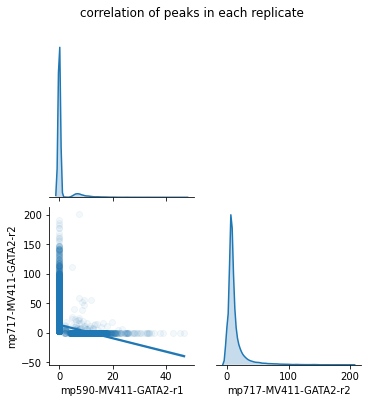

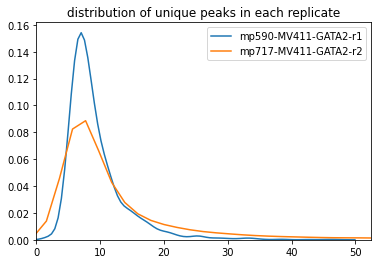

main rep is: mp717-MV411-GATA2-r2
mp590-MV411-GATA2-r1
overlap: 0.46940578749723877%
not enough overlap
not using this replicate from the peakmatrix


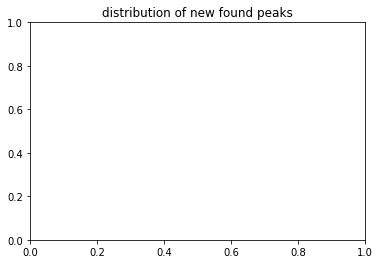

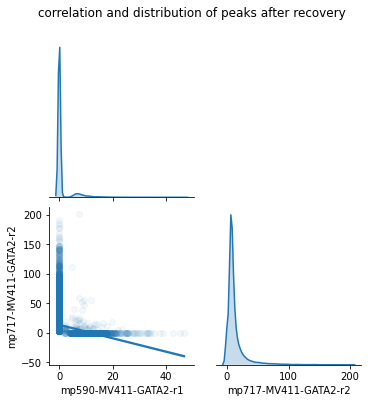

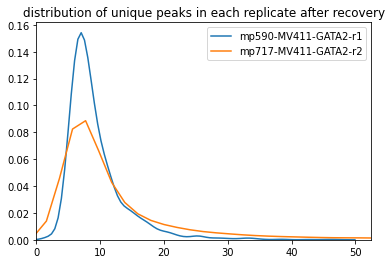

/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:15: UserWarning: `get_labels()` is retained for backwards compatibility; use `generate_petal_labels()` or the higher level `venn()` instead
  warn((
/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:30: UserWarning: `venn2()` is retained for backwards compatibility; use `venn()` instead
  warn((


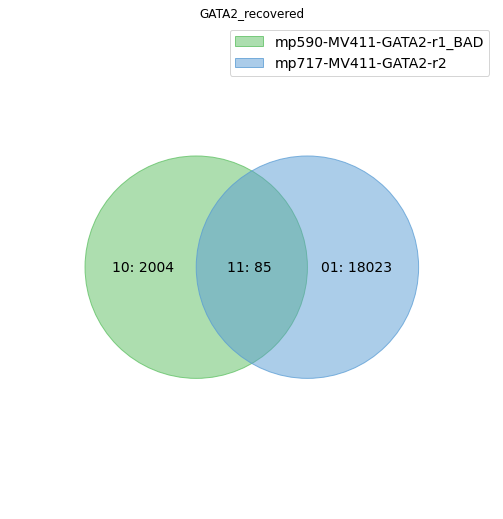

GATA2 18108
merging HOXA9 peaks
finish first overlaps lookup


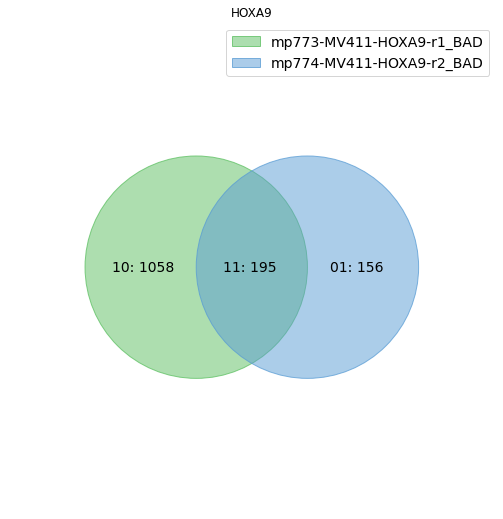

found total peak for this replicate set: [1253  351]
no peaks were good enough quality
wrong TF: HOXA9


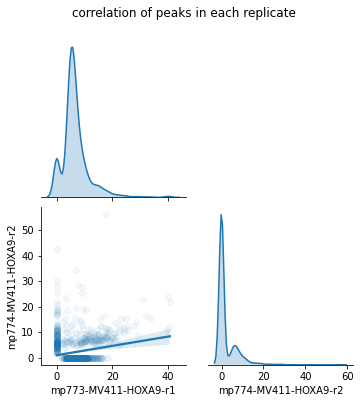

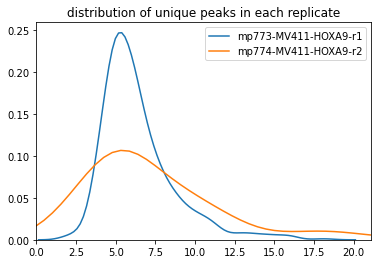

main rep is: mp774-MV411-HOXA9-r2
mp773-MV411-HOXA9-r1
overlap: 55.55555555555556%


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return

5.616635313077553 69.07236248863505 []
enough overlap


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in 

7.4967794810971 38.29559308369546
we have recovered 108 peaks, equal to 27.1356783919598% of the peaks in main replicate


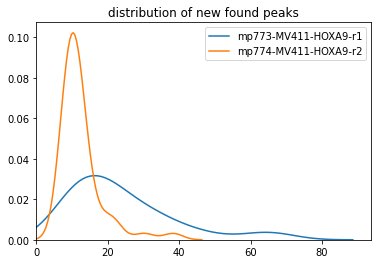

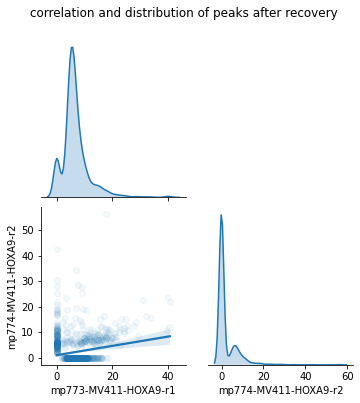

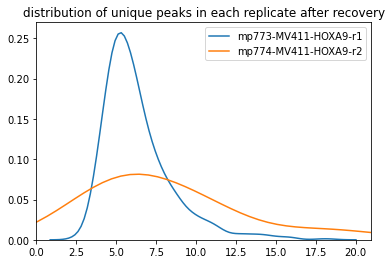

merging LMO2 peaks
finish first overlaps lookup


/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:15: UserWarning: `get_labels()` is retained for backwards compatibility; use `generate_petal_labels()` or the higher level `venn()` instead
  warn((
/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:30: UserWarning: `venn2()` is retained for backwards compatibility; use `venn()` instead
  warn((


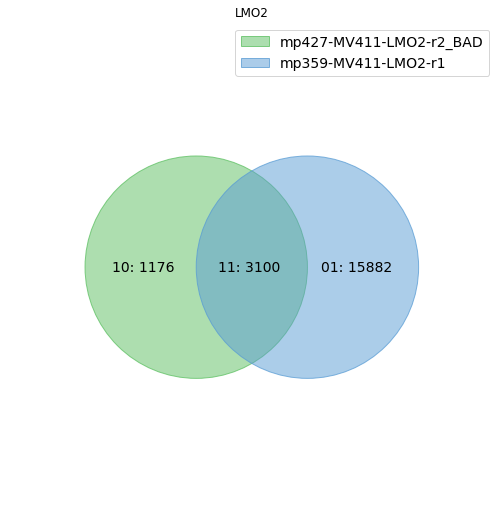

found total peak for this replicate set: [ 4276 18982]


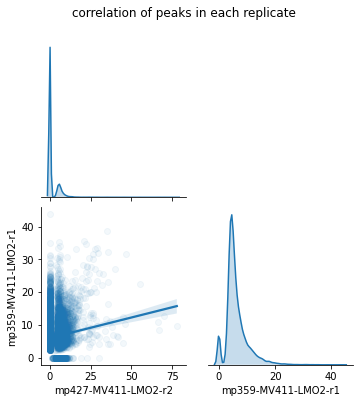

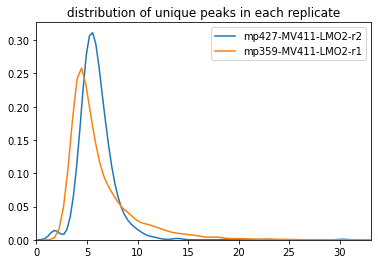

main rep is: mp359-MV411-LMO2-r1
mp427-MV411-LMO2-r2
overlap: 16.33126119481614%
not enough overlap


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in 

6.428105372122856 15.98414903939718 []
we did not had enough initial overlap.
enough overlap


../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2644: RuntimeWarning: invalid value encountered in double_scalars
  if (fx2 - fval) > delta:
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2653: RuntimeWarning: invalid value encountered in double_scalars
  if 2.0 * (fx - fval) <= bnd:
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(pa

9.917975744529173 59.029113963084804
we have recovered 74 peaks, equal to 0.38898233809924304% of the peaks in main replicate
not enough overlap to advice to merge the bams.
oldnew overlap: 16.499841955536823%
                            new overlap: 16.684188393608075%


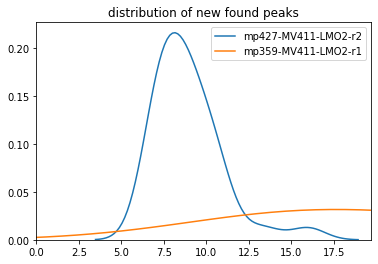

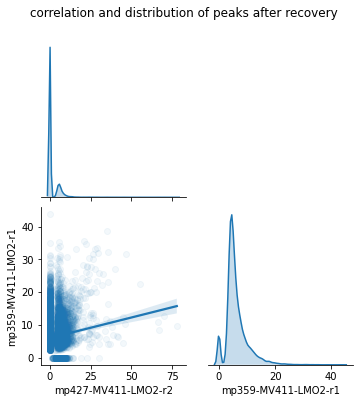

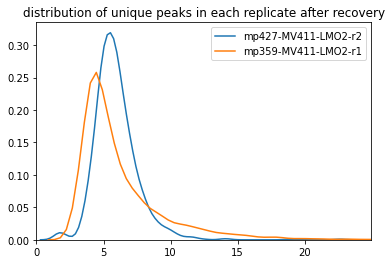

/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:15: UserWarning: `get_labels()` is retained for backwards compatibility; use `generate_petal_labels()` or the higher level `venn()` instead
  warn((
/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:30: UserWarning: `venn2()` is retained for backwards compatibility; use `venn()` instead
  warn((


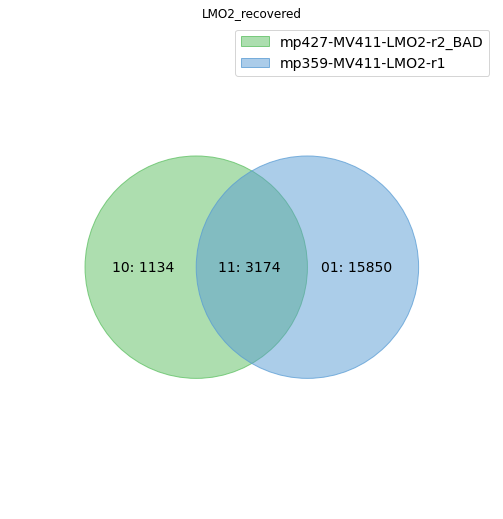

LMO2 19024
we only have one replicate for LYL1 .. pass
merging ETV6 peaks
finish first overlaps lookup


/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:30: UserWarning: `venn3()` is retained for backwards compatibility; use `venn()` instead
  warn((


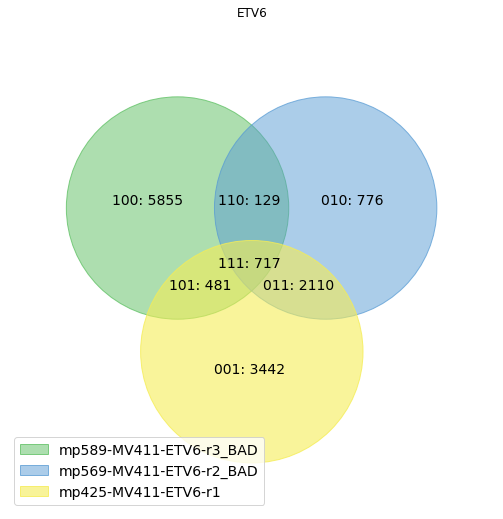

found total peak for this replicate set: [7182 3732 6750]


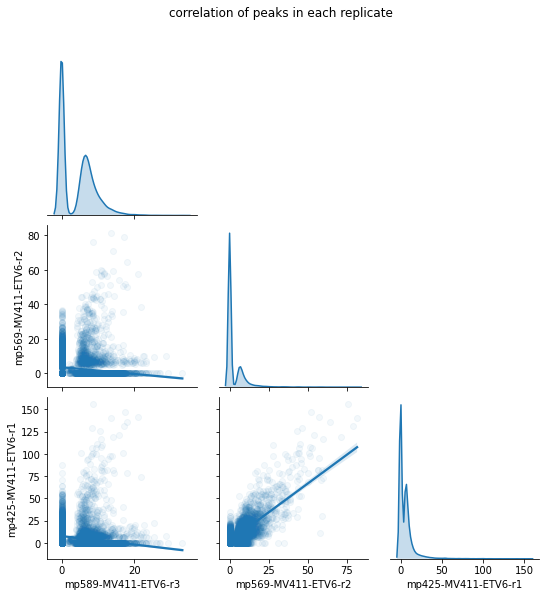

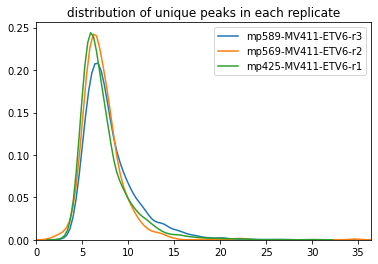

main rep is: mp425-MV411-ETV6-r1
mp589-MV411-ETV6-r3
overlap: 17.74814814814815%
not enough overlap
not using this replicate from the peakmatrix
mp569-MV411-ETV6-r2
overlap: 41.88148148148148%


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in 

7.917139199532557 152.28127083248265 []
enough overlap


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in 

11.52933130168157 30.10431222953313
we have recovered 33 peaks, equal to 0.48859934853420195% of the peaks in main replicate


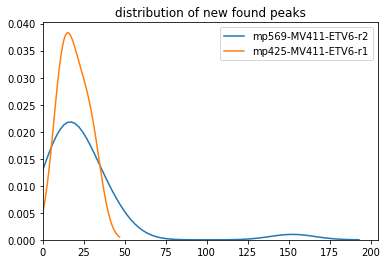

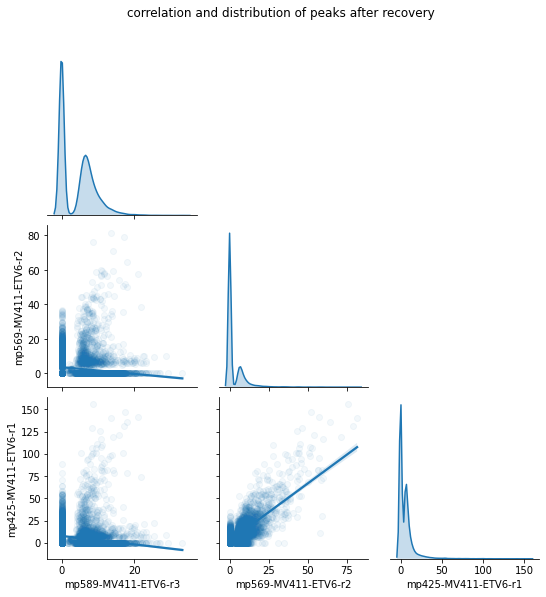

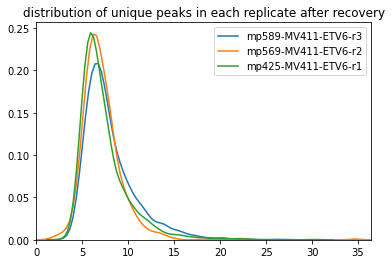

/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:15: UserWarning: `get_labels()` is retained for backwards compatibility; use `generate_petal_labels()` or the higher level `venn()` instead
  warn((
/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:30: UserWarning: `venn3()` is retained for backwards compatibility; use `venn()` instead
  warn((


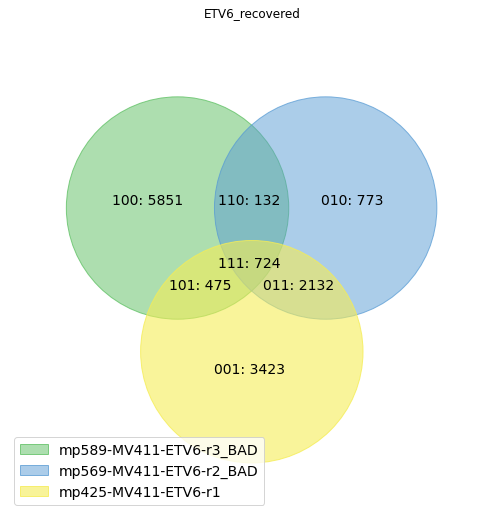

ETV6 6754
merging MEF2C peaks
finish first overlaps lookup


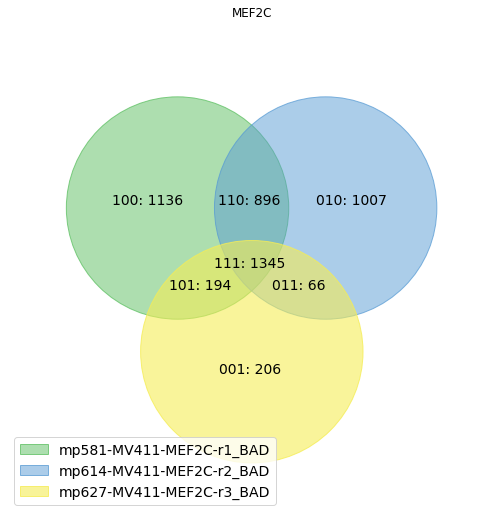

found total peak for this replicate set: [3571 3314 1811]
no peaks were good enough quality
wrong TF: MEF2C


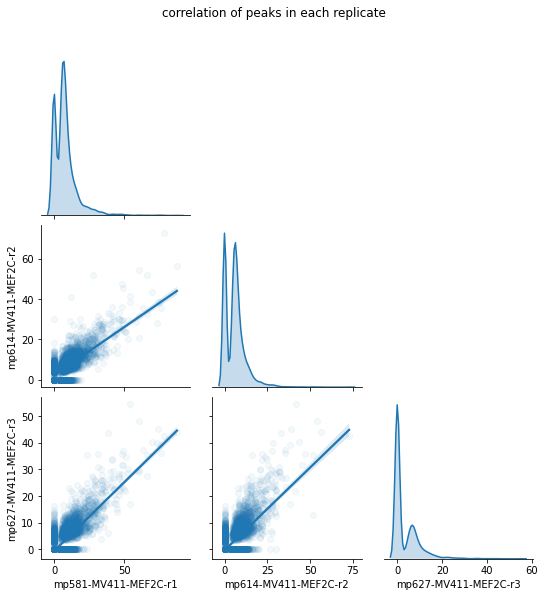

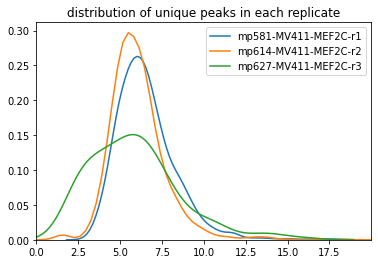

main rep is: mp627-MV411-MEF2C-r3
mp581-MV411-MEF2C-r1
overlap: 84.98067366096079%


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in 

1.111457451589632 70.81722184291493 []
enough overlap


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))
../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: divide by zero encountered in log
  bw = pyBigWig.open(filepath)


6.469333753967152 13.84877848055114
we have recovered 266 peaks, equal to 13.768115942028986% of the peaks in main replicate
mp614-MV411-MEF2C-r2
overlap: 77.91275538376587%


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return

6.134014378741286 73.15781831306433 []
enough overlap
we have recovered 390 peaks, equal to 20.18633540372671% of the peaks in main replicate


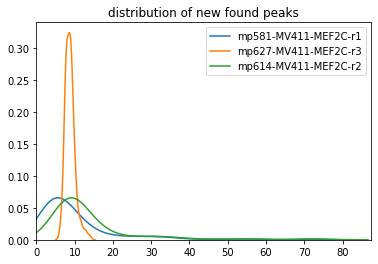

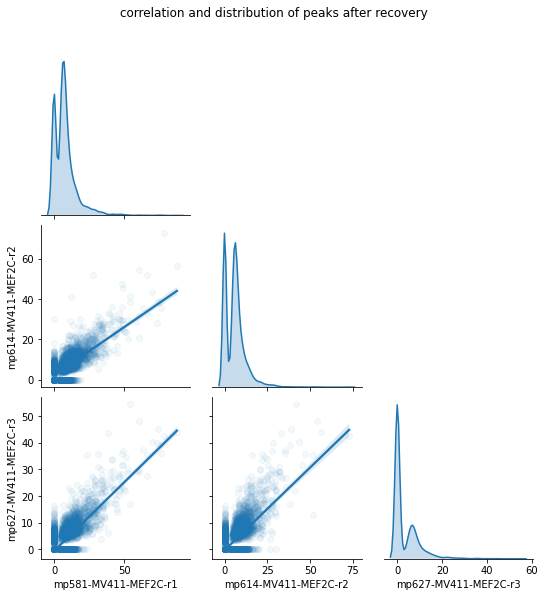

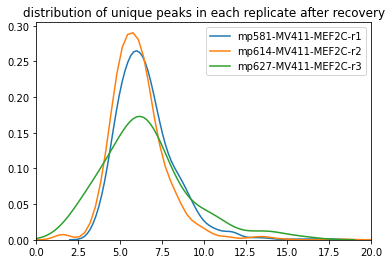

merging MEF2D peaks
finish first overlaps lookup
!TF has less than 1000 PEAKS!


/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:15: UserWarning: `get_labels()` is retained for backwards compatibility; use `generate_petal_labels()` or the higher level `venn()` instead
  warn((
/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:30: UserWarning: `venn2()` is retained for backwards compatibility; use `venn()` instead
  warn((


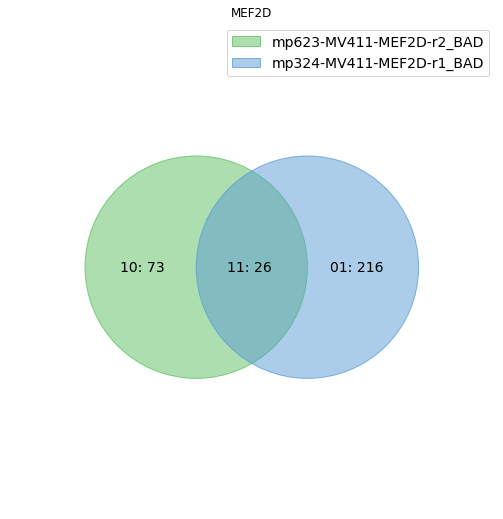

found total peak for this replicate set: [ 99 242]
no peaks were good enough quality
wrong TF: MEF2D


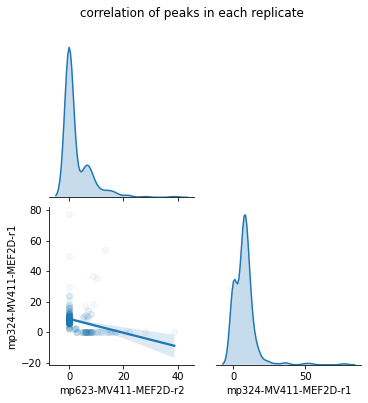

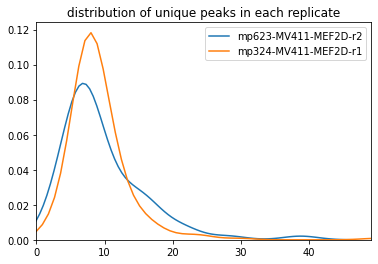

main rep is: mp623-MV411-MEF2D-r2
mp324-MV411-MEF2D-r1
overlap: 26.262626262626267%


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in 

8.208587603073378 13.853039087055434 []
enough overlap


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: divide by zero encountered in log
  bw = pyBigWig.open(filepath)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)


7.9227475226570725 30.800091255147418
we have recovered 44 peaks, equal to 31.428571428571427% of the peaks in main replicate


../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))


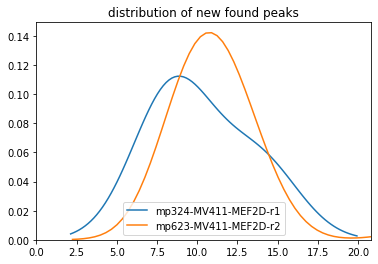

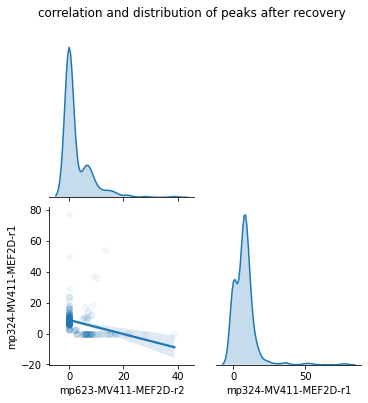

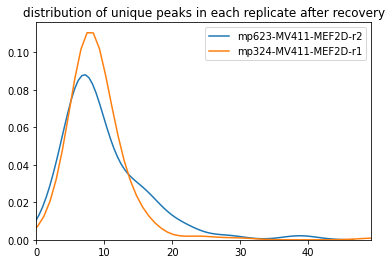

we only have one replicate for IRF2BP2_FLAG .. pass
we only have one replicate for MED1 .. pass
merging RUNX2 peaks
finish first overlaps lookup


/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:15: UserWarning: `get_labels()` is retained for backwards compatibility; use `generate_petal_labels()` or the higher level `venn()` instead
  warn((
/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:30: UserWarning: `venn4()` is retained for backwards compatibility; use `venn()` instead
  warn((


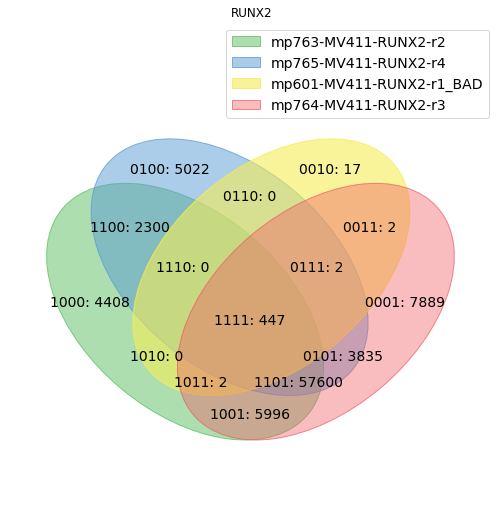

found total peak for this replicate set: [70753 69206   470 75773]


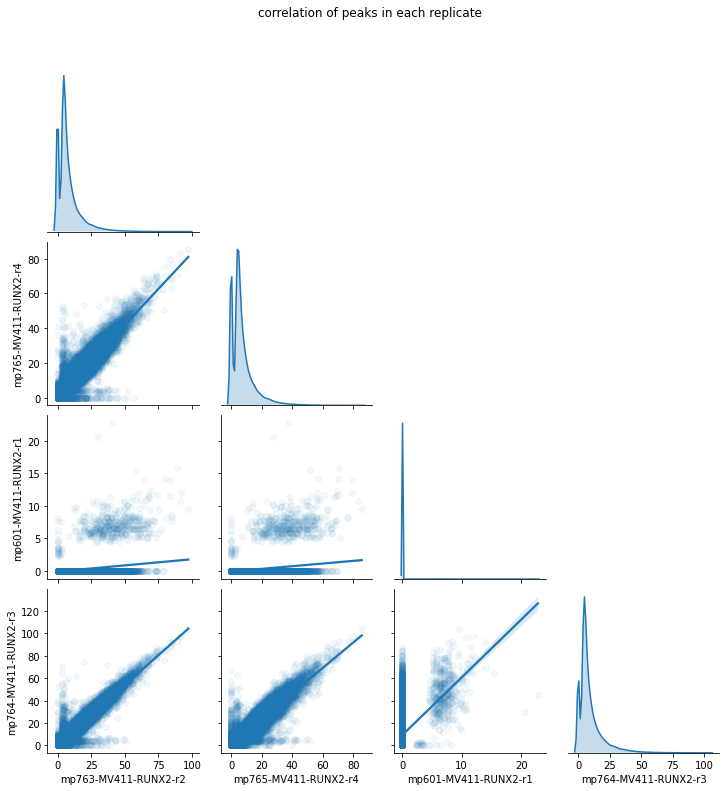

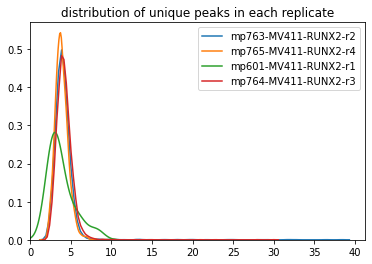

main rep is: mp764-MV411-RUNX2-r3
mp763-MV411-RUNX2-r2
overlap: 84.52219128185502%


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: divide by zero encountered in log
  bw = pyBigWig.open(filepath)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2644: RuntimeWarning: invalid value encountered in double_scalars
  if (fx2 - fval) > delta:
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2653: RuntimeWarning: invalid value encountered in double_scalars
  if 2.0 * (fx - fval) <= bnd:
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflo

0.7196078886424635 82.36721645920606 []
enough overlap


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: divide by zero encountered in log
  bw = pyBigWig.open(filepath)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2644: RuntimeWarning: invalid value encountered in double_scalars
  if (fx2 - fval) > delta:
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2653: RuntimeWarning: invalid value encountered in double_scalars
  if 2.0 * (fx - fval) <= bnd:
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in power
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Pow

0.6342788987161722 96.87099533805838
we have recovered 9996 peaks, equal to 12.43670295489891% of the peaks in main replicate
mp765-MV411-RUNX2-r4
overlap: 81.67025193670568%


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: divide by zero encountered in log
  bw = pyBigWig.open(filepath)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2644: RuntimeWarning: invalid value encountered in double_scalars
  if (fx2 - fval) > delta:
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2653: RuntimeWarning: invalid value encountered in double_scalars
  if 2.0 * (fx - fval) <= bnd:
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in power
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Pow

0.9561759992880259 82.77871117095 []
enough overlap
we have recovered 12852 peaks, equal to 15.9900466562986% of the peaks in main replicate
mp601-MV411-RUNX2-r1
overlap: 0.5978382801261662%
not enough overlap


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return

9.295258862699995 42.36290990891203 []
we did not had enough initial overlap.
enough overlap
we have recovered 12862 peaks, equal to 16.00248833592535% of the peaks in main replicate
enough from small overlap to advice to merge the peaks


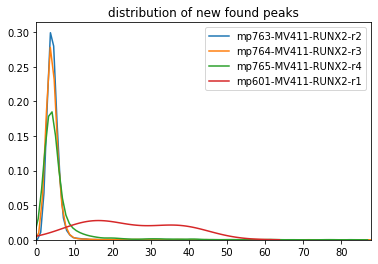

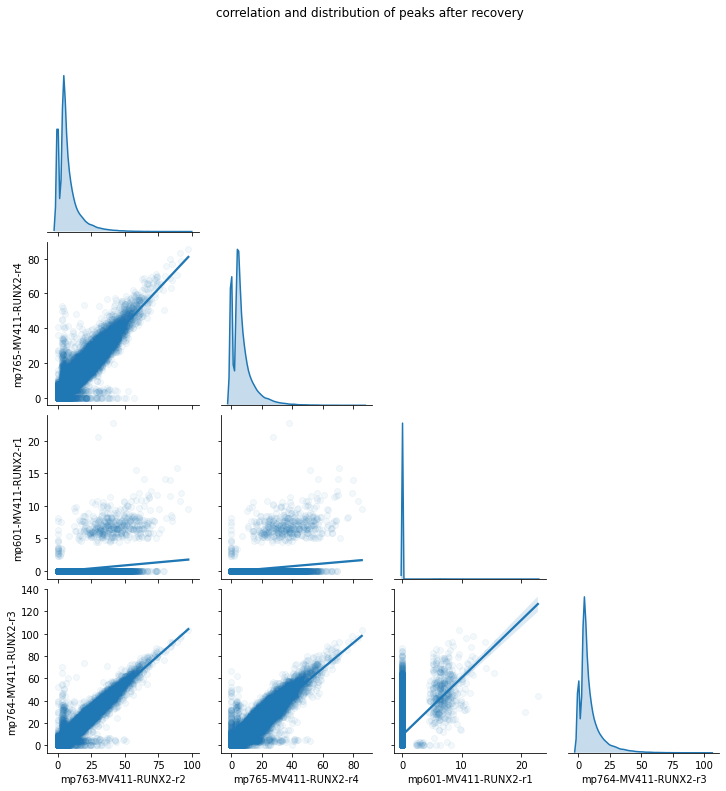

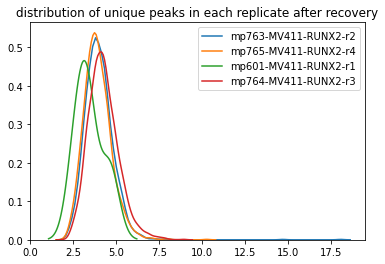

/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:15: UserWarning: `get_labels()` is retained for backwards compatibility; use `generate_petal_labels()` or the higher level `venn()` instead
  warn((
/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:30: UserWarning: `venn4()` is retained for backwards compatibility; use `venn()` instead
  warn((


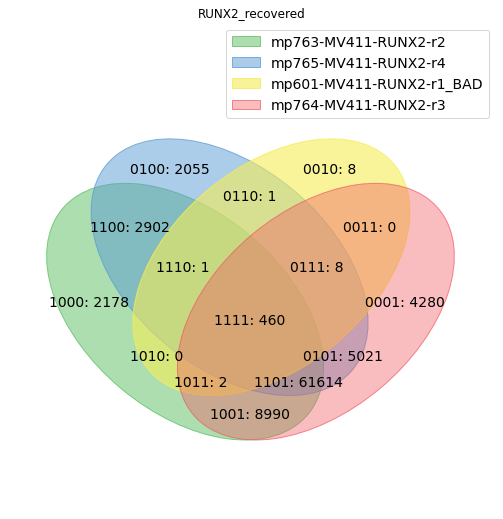

RUNX2 83278
we only have one replicate for POLII .. pass
we only have one replicate for GFI1 .. pass
merging MYC peaks
finish first overlaps lookup


/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:30: UserWarning: `venn3()` is retained for backwards compatibility; use `venn()` instead
  warn((


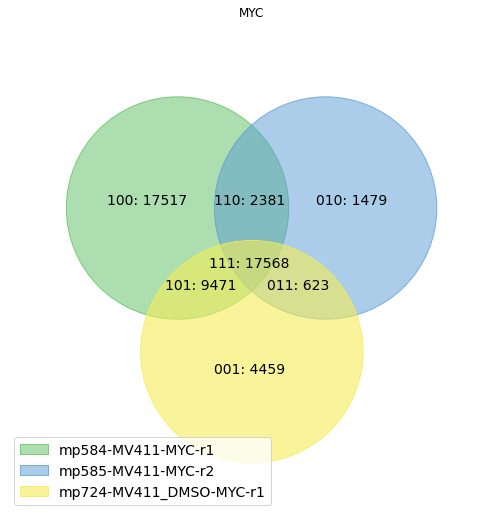

found total peak for this replicate set: [46937 22051 32121]


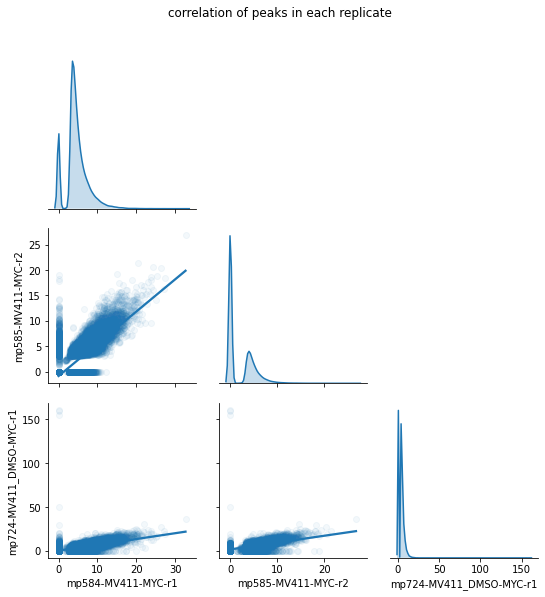

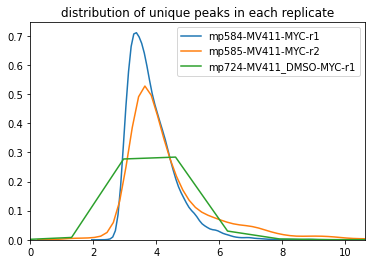

main rep is: mp584-MV411-MYC-r1
mp724-MV411_DMSO-MYC-r1
overlap: 57.60700513454204%


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: divide by zero encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/h

5.561909418907015 75.35384888520299 []
enough overlap


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in power
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): retu

0.5366007178714792 116.62135367600375
we have recovered 1920 peaks, equal to 3.9498045669615305% of the peaks in main replicate
mp585-MV411-MYC-r2
overlap: 42.50165114941304%


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in 

7.351515257846612 25.936917199782712 []
enough overlap
we have recovered 1960 peaks, equal to 4.032092162106562% of the peaks in main replicate


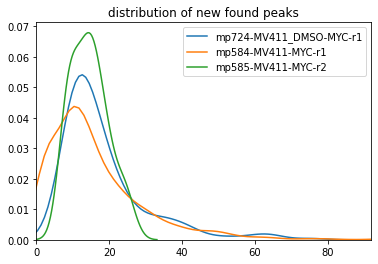

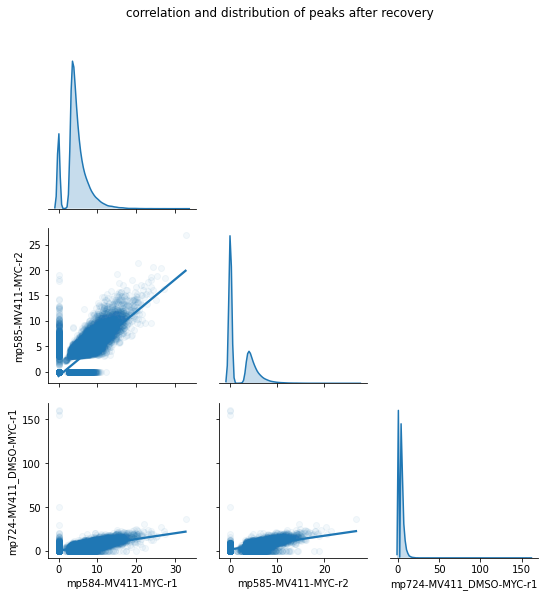

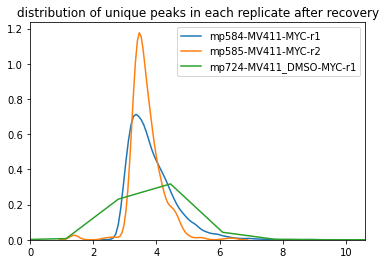

/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:15: UserWarning: `get_labels()` is retained for backwards compatibility; use `generate_petal_labels()` or the higher level `venn()` instead
  warn((
/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:30: UserWarning: `venn3()` is retained for backwards compatibility; use `venn()` instead
  warn((


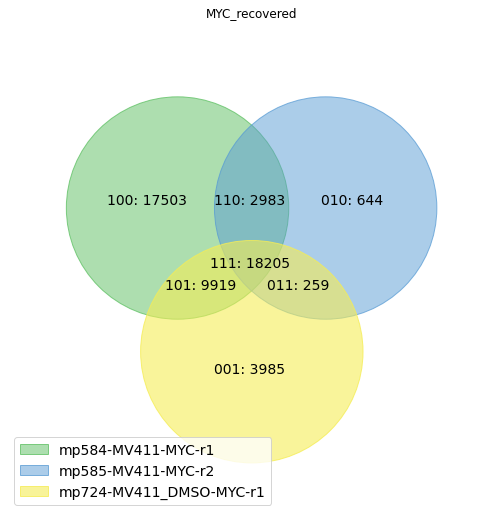

MYC 48869
we only have one replicate for FLI1 .. pass
we only have one replicate for IRF8 .. pass
merging IKZF1 peaks
finish first overlaps lookup


/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:30: UserWarning: `venn2()` is retained for backwards compatibility; use `venn()` instead
  warn((


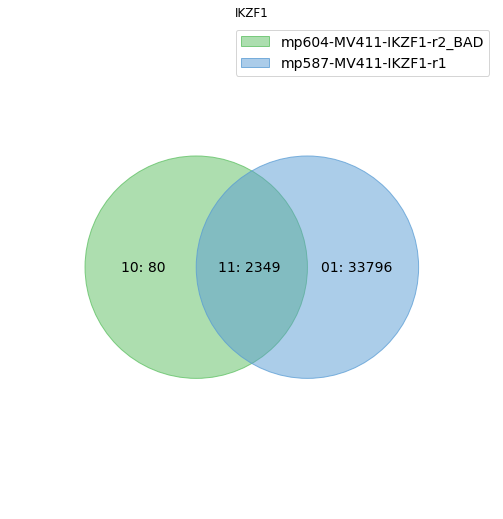

found total peak for this replicate set: [ 2429 36145]


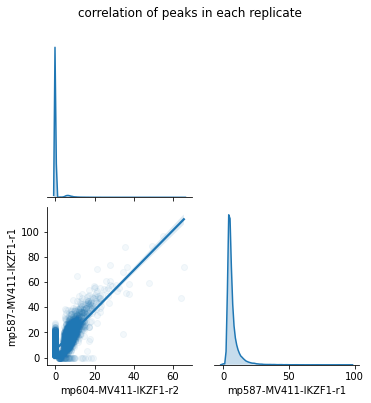

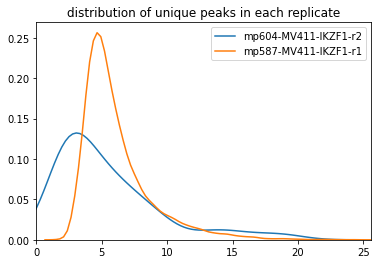

main rep is: mp587-MV411-IKZF1-r1
mp604-MV411-IKZF1-r2
overlap: 6.4988241803845614%
not enough overlap


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in 

6.777888672671017 30.58047930489978 []
we did not had enough initial overlap.
enough overlap


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: divide by zero encountered in log
  bw = pyBigWig.open(filepath)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2644: RuntimeWarning: invalid value encountered in double_scalars
  if (fx2 - fval) > delta:
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2653: RuntimeWarning: invalid value encountered in double_scalars
  if 2.0 * (fx - fval) <= bnd:
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in power
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Pow

13.007377917857431 113.94384245604697
we have recovered 221 peaks, equal to 0.6104297867638935% of the peaks in main replicate
enough from small overlap to advice to merge the peaks


../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))


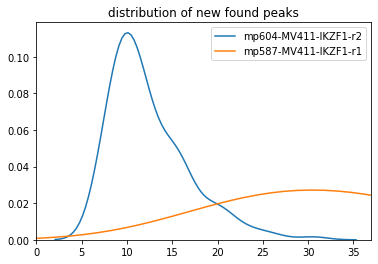

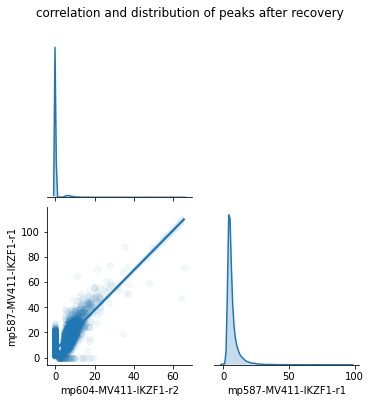

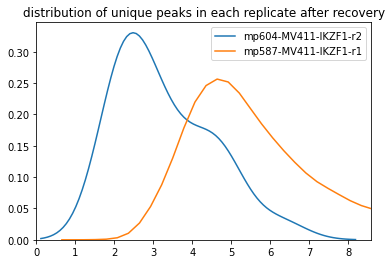

/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:15: UserWarning: `get_labels()` is retained for backwards compatibility; use `generate_petal_labels()` or the higher level `venn()` instead
  warn((
/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:30: UserWarning: `venn2()` is retained for backwards compatibility; use `venn()` instead
  warn((


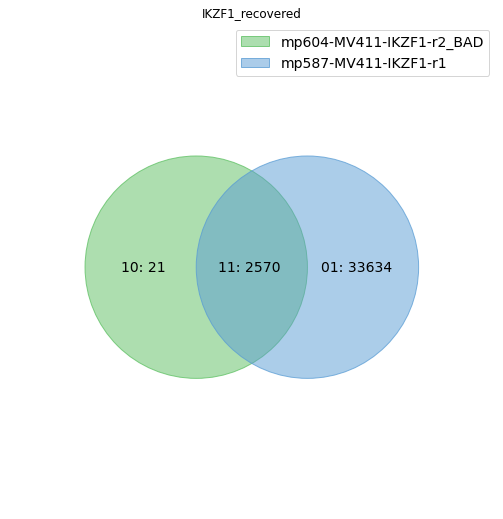

IKZF1 36204
merging PU1 peaks
finish first overlaps lookup


/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:30: UserWarning: `venn3()` is retained for backwards compatibility; use `venn()` instead
  warn((


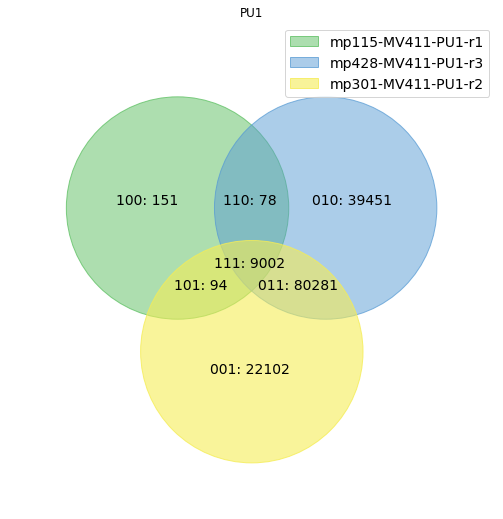

found total peak for this replicate set: [  9325 128812 111479]


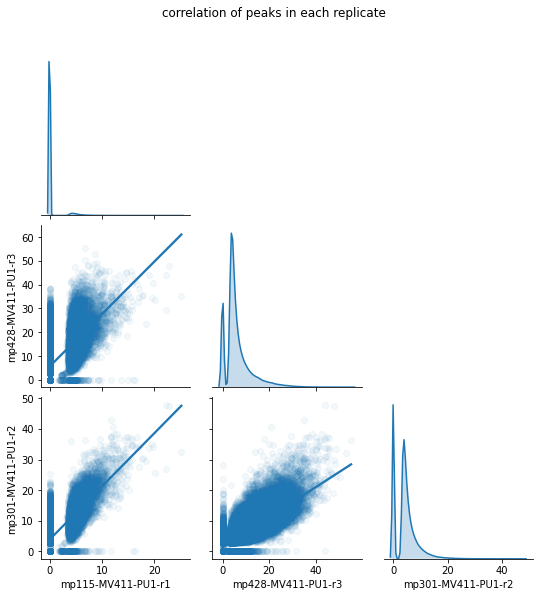

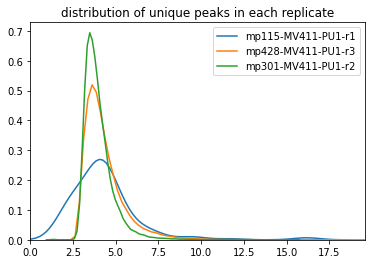

main rep is: mp428-MV411-PU1-r3
mp301-MV411-PU1-r2
overlap: 69.31264167934664%


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: divide by zero encountered in log
  bw = pyBigWig.open(filepath)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2644: RuntimeWarning: invalid value encountered in double_scalars
  if (fx2 - fval) > delta:
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2653: RuntimeWarning: invalid value encountered in double_scalars
  if 2.0 * (fx - fval) <= bnd:
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflo

0.4358339084557014 159.04109771999094 []
enough overlap


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return

0.3210624373993328 159.20566713198377
we have recovered 8956 peaks, equal to 6.543005135922969% of the peaks in main replicate
mp115-MV411-PU1-r1
overlap: 7.04903269881688%
not enough overlap


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in 

15.893177484194874 29.407618109102074 []
we did not had enough initial overlap.
enough overlap
we have recovered 8959 peaks, equal to 6.5451968526947155% of the peaks in main replicate
enough from small overlap to advice to merge the peaks


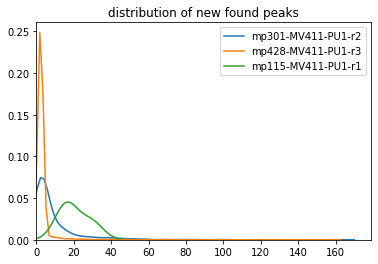

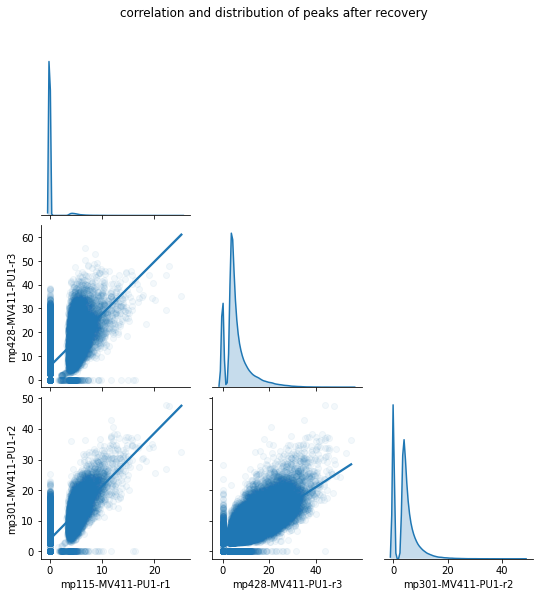

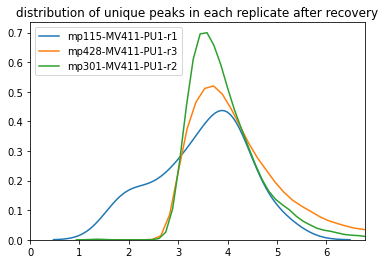

/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:15: UserWarning: `get_labels()` is retained for backwards compatibility; use `generate_petal_labels()` or the higher level `venn()` instead
  warn((
/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:30: UserWarning: `venn3()` is retained for backwards compatibility; use `venn()` instead
  warn((


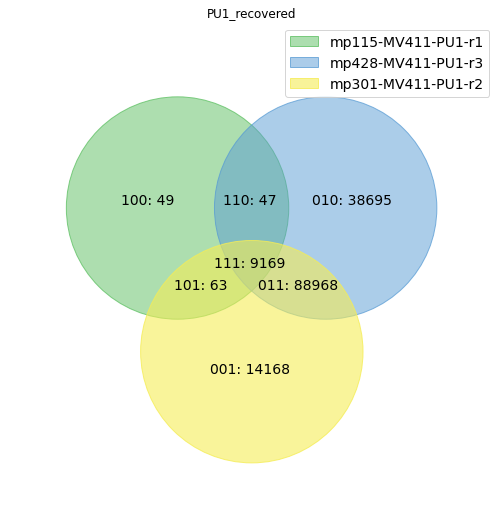

PU1 136942
merging ZMYND8 peaks
finish first overlaps lookup


/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:30: UserWarning: `venn2()` is retained for backwards compatibility; use `venn()` instead
  warn((


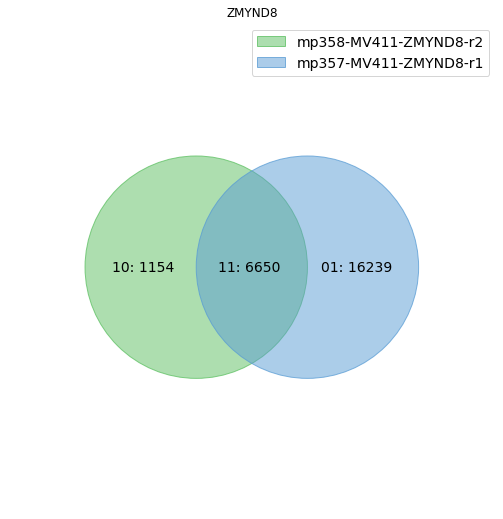

found total peak for this replicate set: [ 7804 22889]


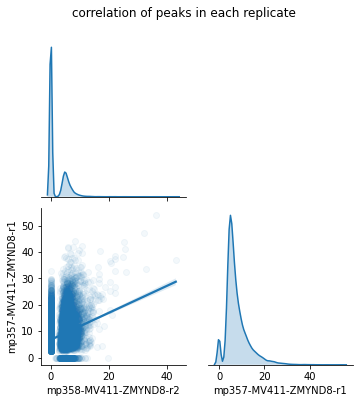

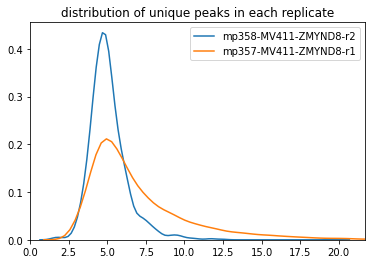

main rep is: mp357-MV411-ZMYND8-r1
mp358-MV411-ZMYND8-r2
overlap: 29.05325702302416%


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in 

6.141529978669944 23.58823795843151 []
enough overlap


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in power
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2672: RuntimeWarning: invalid value encountered in double_s

4.59371136519243 56.3274184418172
we have recovered 313 peaks, equal to 1.3534549857303468% of the peaks in main replicate
enough from small overlap to advice to merge the peaks


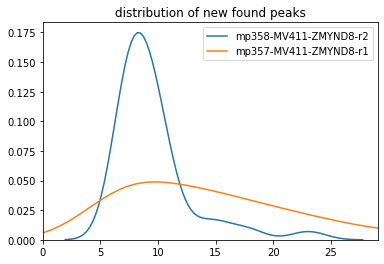

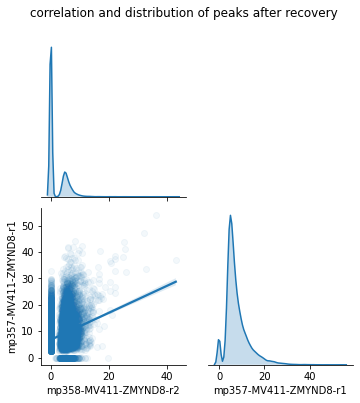

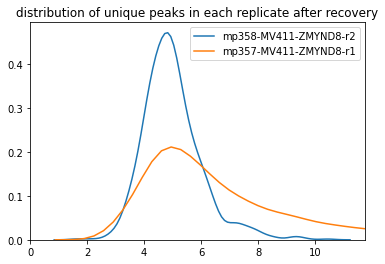

/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:15: UserWarning: `get_labels()` is retained for backwards compatibility; use `generate_petal_labels()` or the higher level `venn()` instead
  warn((
/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:30: UserWarning: `venn2()` is retained for backwards compatibility; use `venn()` instead
  warn((


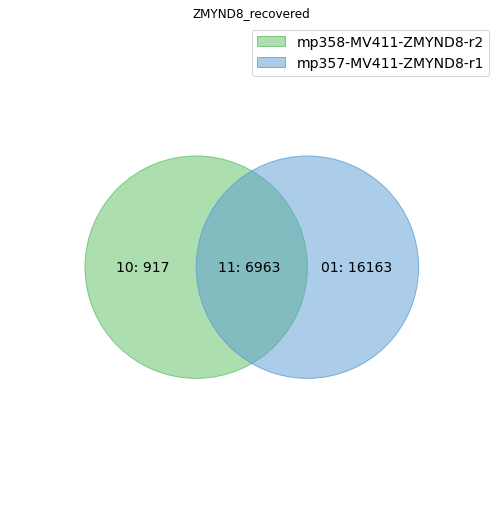

ZMYND8 23126
merging ELF2 peaks
finish first overlaps lookup


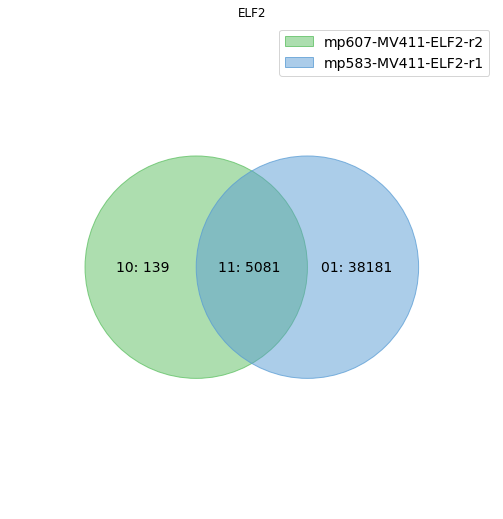

found total peak for this replicate set: [ 5220 43262]


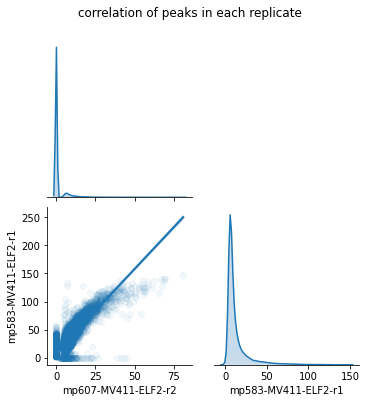

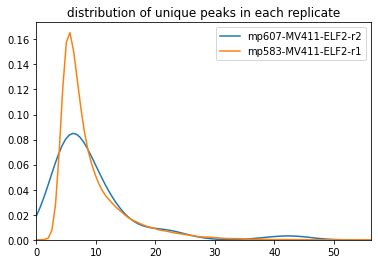

main rep is: mp583-MV411-ELF2-r1
mp607-MV411-ELF2-r2
overlap: 11.744718228468402%
not enough overlap


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in 

8.660037108107248 46.186857002214666 []
we did not had enough initial overlap.
enough overlap


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: divide by zero encountered in log
  bw = pyBigWig.open(filepath)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2644: RuntimeWarning: invalid value encountered in double_scalars
  if (fx2 - fval) > delta:
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2653: RuntimeWarning: invalid value encountered in double_scalars
  if 2.0 * (fx - fval) <= bnd:
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in power
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Pow

0.9465838259926627 191.78091218569563
we have recovered 70 peaks, equal to 0.16160310277957338% of the peaks in main replicate
enough from small overlap to advice to merge the peaks


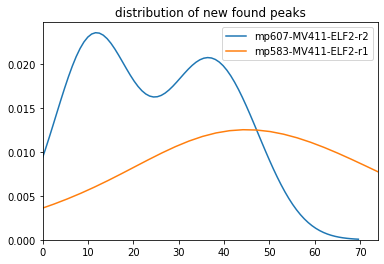

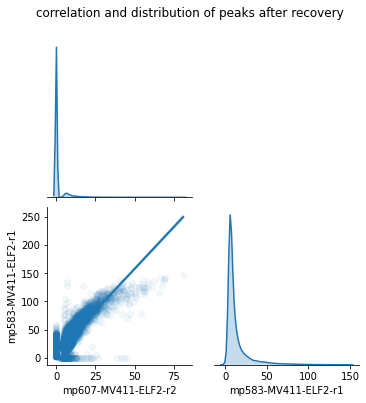

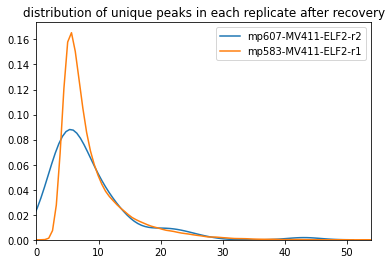

/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:15: UserWarning: `get_labels()` is retained for backwards compatibility; use `generate_petal_labels()` or the higher level `venn()` instead
  warn((
/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:30: UserWarning: `venn2()` is retained for backwards compatibility; use `venn()` instead
  warn((


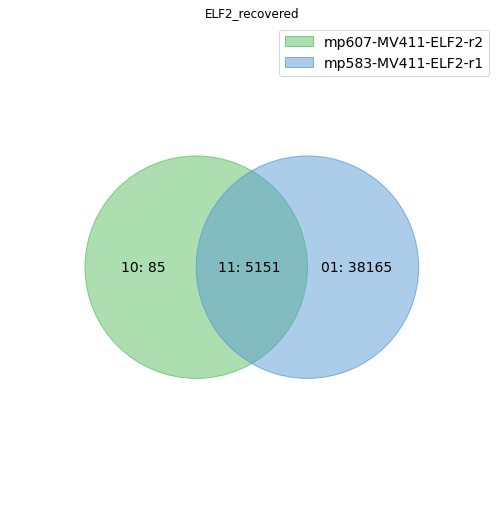

ELF2 43316
we only have one replicate for SMC1 .. pass
we only have one replicate for MEIS1 .. pass
merging ZEB2 peaks
finish first overlaps lookup


/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:30: UserWarning: `venn4()` is retained for backwards compatibility; use `venn()` instead
  warn((


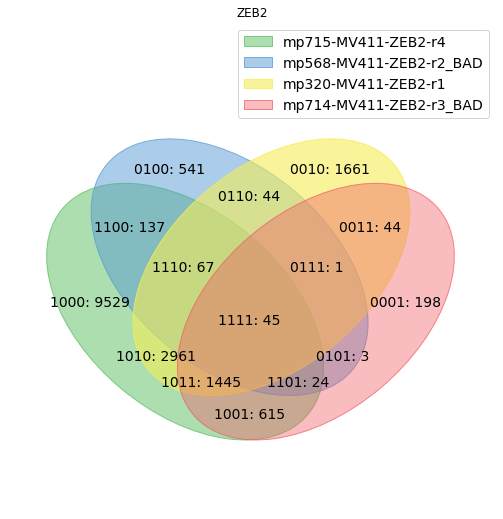

found total peak for this replicate set: [14823   862  6268  2375]


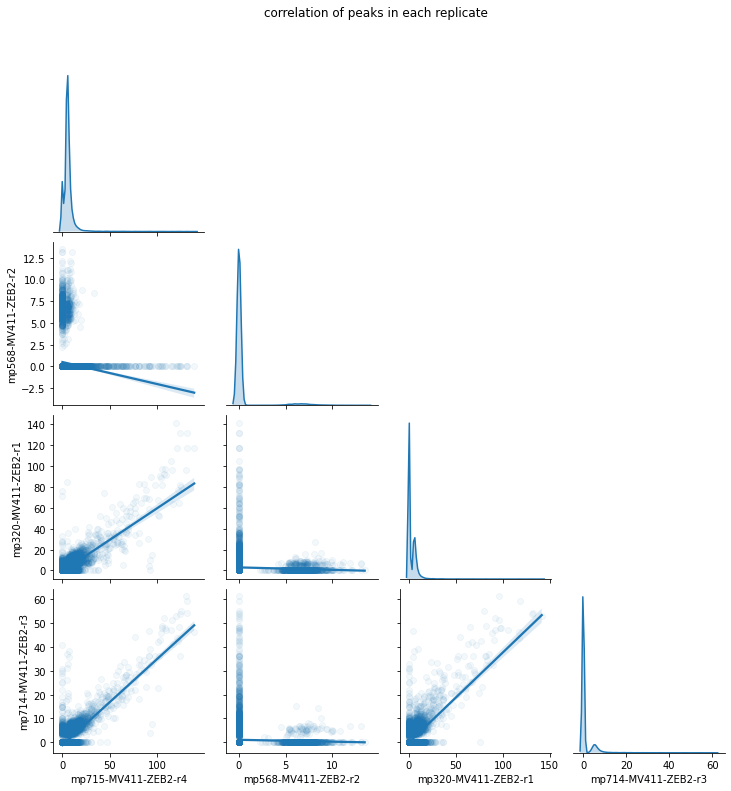

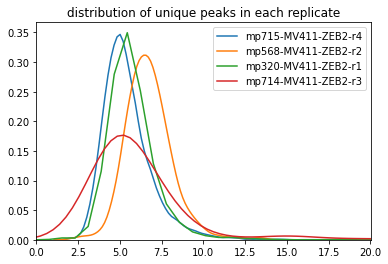

main rep is: mp715-MV411-ZEB2-r4
mp320-MV411-ZEB2-r1
overlap: 30.47965998785671%


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2644: RuntimeWarning: invalid value encountered in double_scalars
  if (fx2 - f

0.5282218551997994 57.23591820760516 []
enough overlap


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: divide by zero encountered in log
  bw = pyBigWig.open(filepath)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2644: RuntimeWarning: invalid value encountered in double_scalars
  if (fx2 - fval) > delta:
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2653: RuntimeWarning: invalid value encountered in double_scalars
  if 2.0 * (fx - fval) <= bnd:
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflo

1.4891481661903925 123.58472899387124
we have recovered 1449 peaks, equal to 9.680005344378381% of the peaks in main replicate
mp714-MV411-ZEB2-r3
overlap: 14.362814544963905%
not enough overlap


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: divide by zero encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in power
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/jere

1.0501958629598303 60.518031100427045 []
enough overlap
we have recovered 4190 peaks, equal to 27.991181775669716% of the peaks in main replicate
enough from small overlap to advice to merge the peaks
mp568-MV411-ZEB2-r2
overlap: 1.841732442825339%
not enough overlap


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return

we did not had enough initial overlap.
enough overlap
we have recovered 4190 peaks, equal to 27.991181775669716% of the peaks in main replicate
not enough overlap to advice to merge the bams.
oldnew overlap: 2.0308637851559888%
                            new overlap: 2.0308637851559888%


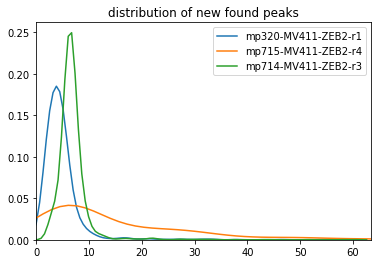

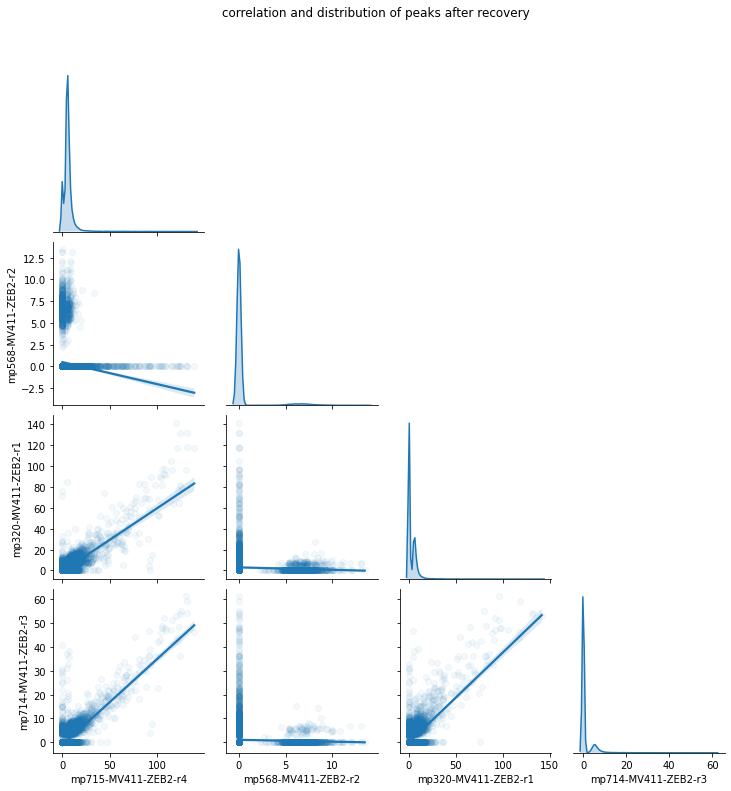

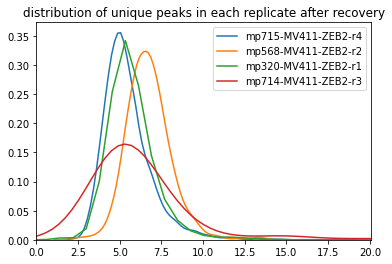

/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:15: UserWarning: `get_labels()` is retained for backwards compatibility; use `generate_petal_labels()` or the higher level `venn()` instead
  warn((
/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:30: UserWarning: `venn4()` is retained for backwards compatibility; use `venn()` instead
  warn((


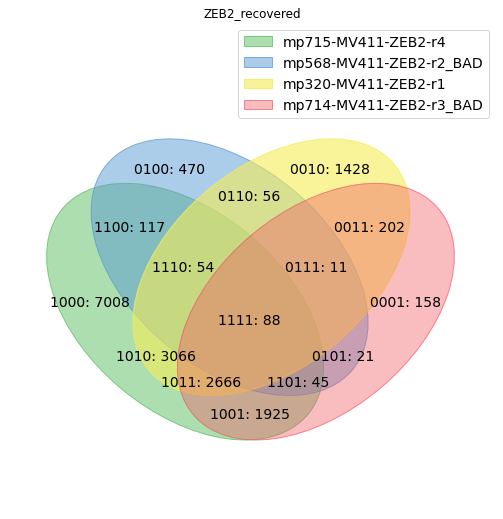

ZEB2 14969
we only have one replicate for CTCF .. pass
merging SP1 peaks
finish first overlaps lookup


/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:30: UserWarning: `venn3()` is retained for backwards compatibility; use `venn()` instead
  warn((


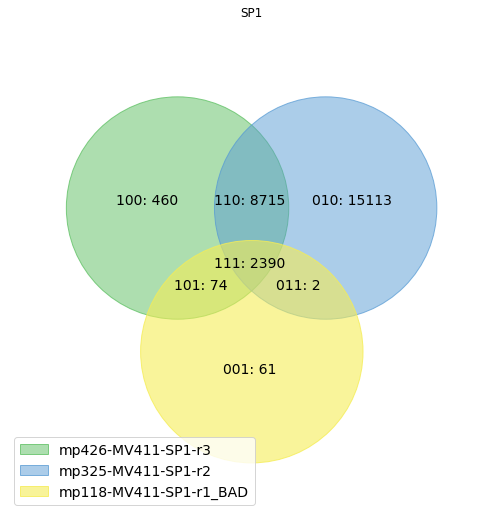

found total peak for this replicate set: [11639 26220  2527]


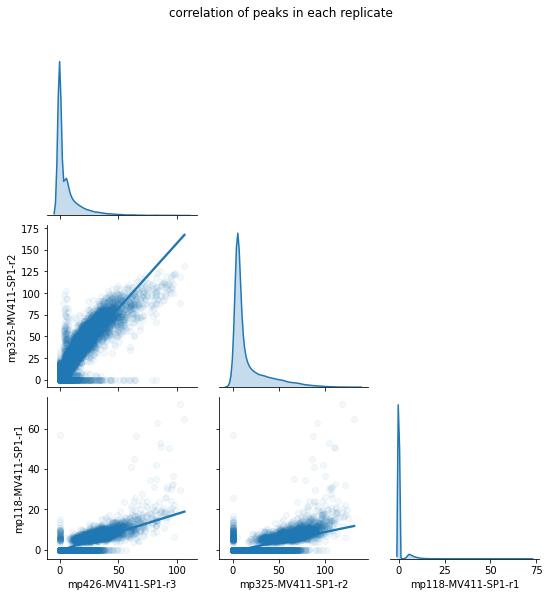

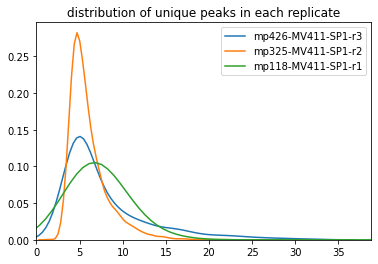

main rep is: mp325-MV411-SP1-r2
mp426-MV411-SP1-r3
overlap: 42.353165522501904%


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: divide by zero encountered in log
  bw = pyBigWig.open(filepath)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2644: RuntimeWarning: invalid value encountered in double_scalars
  if (fx2 - fval) > delta:
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2653: RuntimeWarning: invalid value encountered in double_scalars
  if 2.0 * (fx - fval) <= bnd:
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflo

5.881477669540173 144.22503590935503 []
enough overlap


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: divide by zero encountered in log
  bw = pyBigWig.open(filepath)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2644: RuntimeWarning: invalid value encountered in double_scalars
  if (fx2 - fval) > delta:
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2653: RuntimeWarning: invalid value encountered in double_scalars
  if 2.0 * (fx - fval) <= bnd:
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in power
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Pow

0.7976536047545938 171.48645496721602
we have recovered 400 peaks, equal to 1.5080113100848256% of the peaks in main replicate
mp118-MV411-SP1-r1
overlap: 9.12280701754386%
not enough overlap


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in 

10.426587146701502 14.660956341575323 []
we did not had enough initial overlap.
enough overlap
we have recovered 407 peaks, equal to 1.53440150801131% of the peaks in main replicate
enough from small overlap to advice to merge the peaks


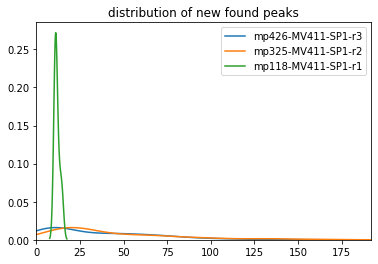

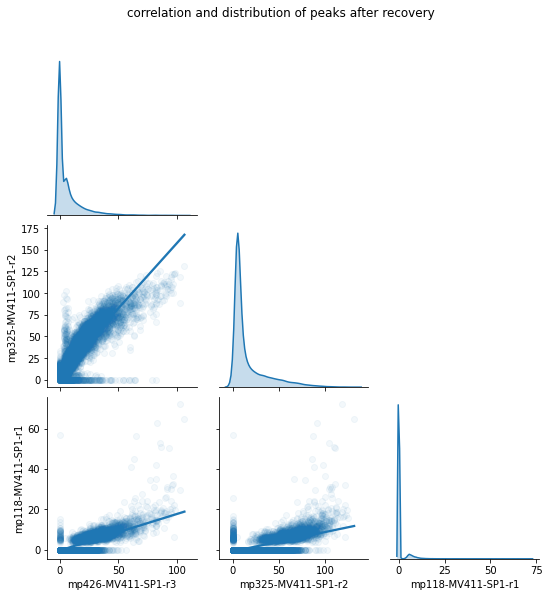

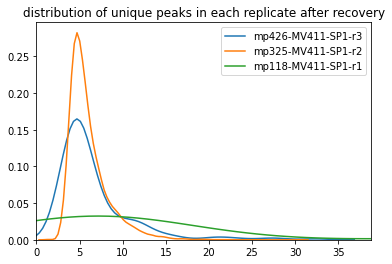

/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:15: UserWarning: `get_labels()` is retained for backwards compatibility; use `generate_petal_labels()` or the higher level `venn()` instead
  warn((
/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:30: UserWarning: `venn3()` is retained for backwards compatibility; use `venn()` instead
  warn((


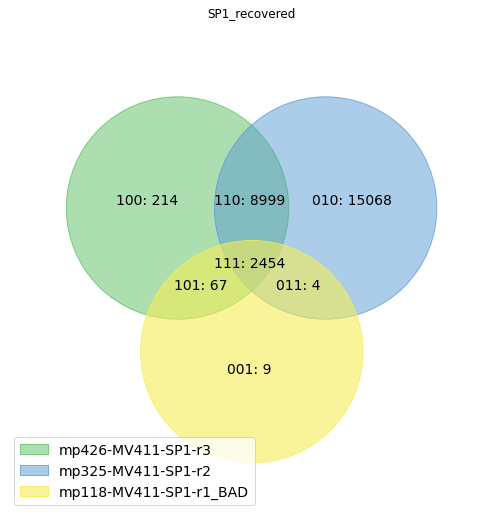

SP1 26525
we only have one replicate for MYBL2 .. pass
we only have one replicate for CDK13 .. pass
we only have one replicate for H3K27me3 .. pass
merging CEBPA peaks
finish first overlaps lookup


/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:30: UserWarning: `venn4()` is retained for backwards compatibility; use `venn()` instead
  warn((


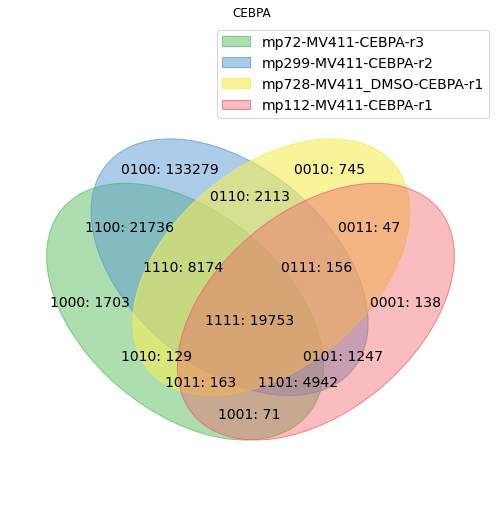

found total peak for this replicate set: [ 56671 191400  31280  26517]


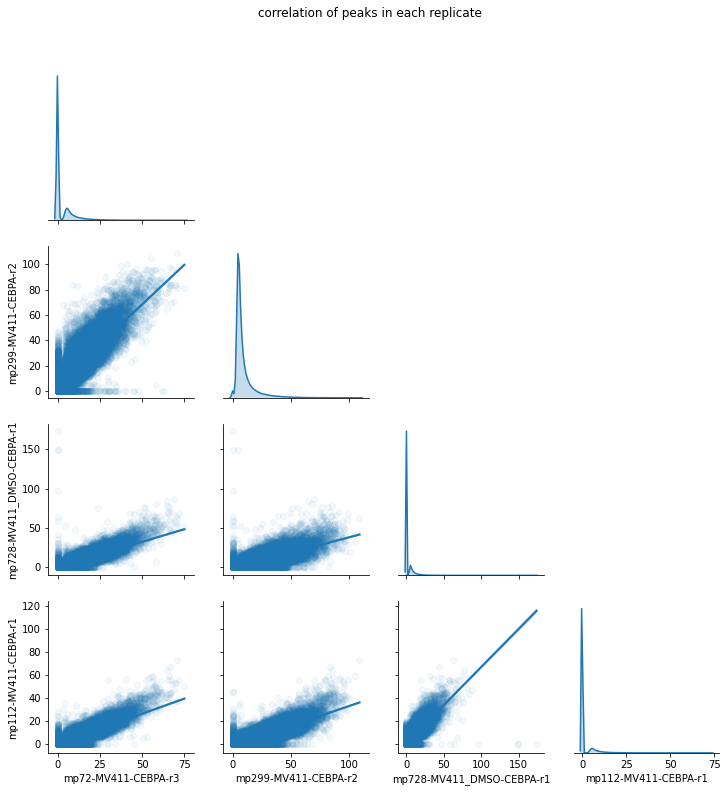

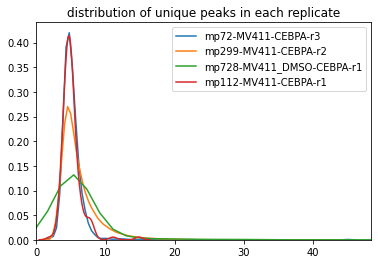

main rep is: mp299-MV411-CEBPA-r2
mp72-MV411-CEBPA-r3
overlap: 28.529258098223615%


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in 

6.152746782969362 53.410173862691714 []
enough overlap


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: divide by zero encountered in log
  bw = pyBigWig.open(filepath)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2644: RuntimeWarning: invalid value encountered in double_scalars
  if (fx2 - fval) > delta:
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2653: RuntimeWarning: invalid value encountered in double_scalars
  if 2.0 * (fx - fval) <= bnd:
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in power
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Pow

0.31197820519098823 102.39042875267754
we have recovered 1196 peaks, equal to 0.6214601195115614% of the peaks in main replicate
enough from small overlap to advice to merge the peaks
mp728-MV411_DMSO-CEBPA-r1
overlap: 15.776384535005224%
not enough overlap


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: divide by zero encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/h

8.064517310805096 8.833976613747126 []
we did not had enough initial overlap.
enough overlap
we have recovered 1198 peaks, equal to 0.6224993504806443% of the peaks in main replicate
enough from small overlap to advice to merge the peaks
mp112-MV411-CEBPA-r1
overlap: 13.635318704284222%
not enough overlap


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in 

6.966794009968104 60.32500524641245 []
we did not had enough initial overlap.
enough overlap
we have recovered 1256 peaks, equal to 0.6526370485840478% of the peaks in main replicate
enough from small overlap to advice to merge the peaks


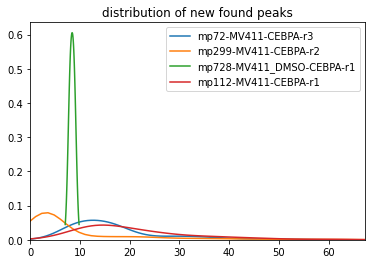

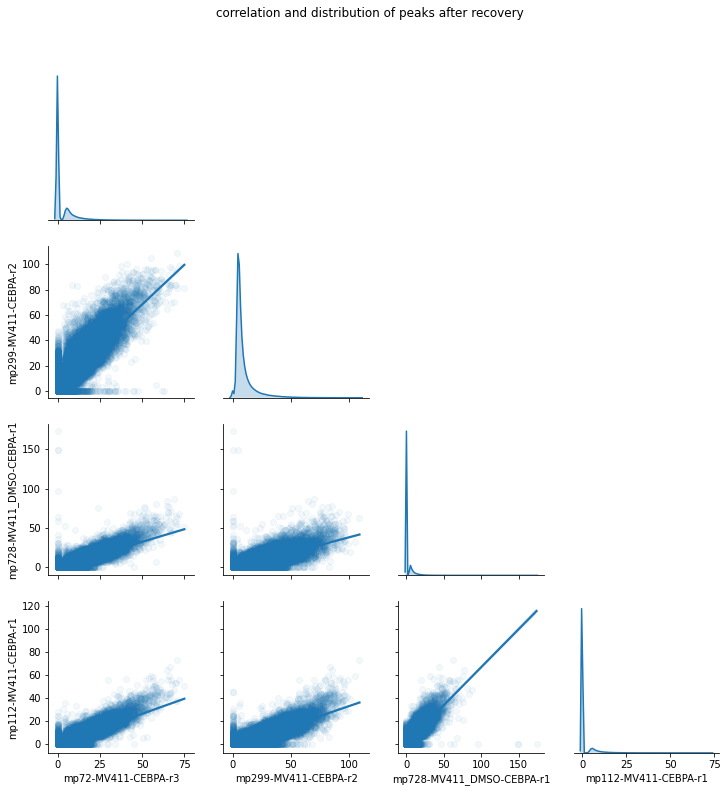

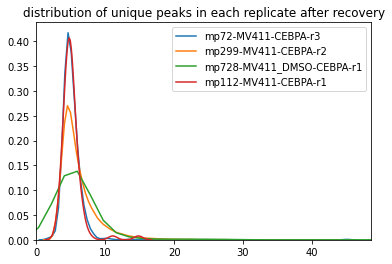

/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:15: UserWarning: `get_labels()` is retained for backwards compatibility; use `generate_petal_labels()` or the higher level `venn()` instead
  warn((
/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:30: UserWarning: `venn4()` is retained for backwards compatibility; use `venn()` instead
  warn((


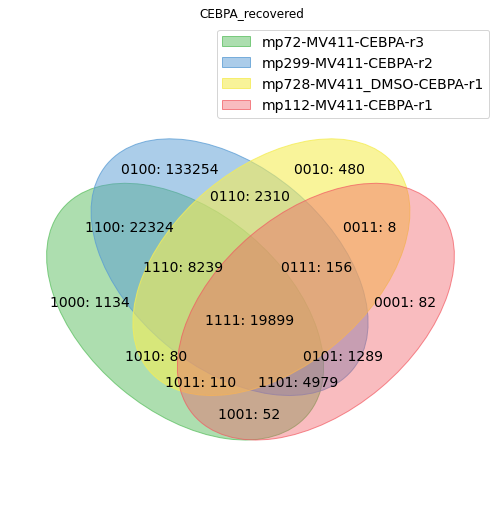

CEBPA 192700
we only have one replicate for MAX .. pass
merging FOXP1 peaks
finish first overlaps lookup


/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:30: UserWarning: `venn2()` is retained for backwards compatibility; use `venn()` instead
  warn((


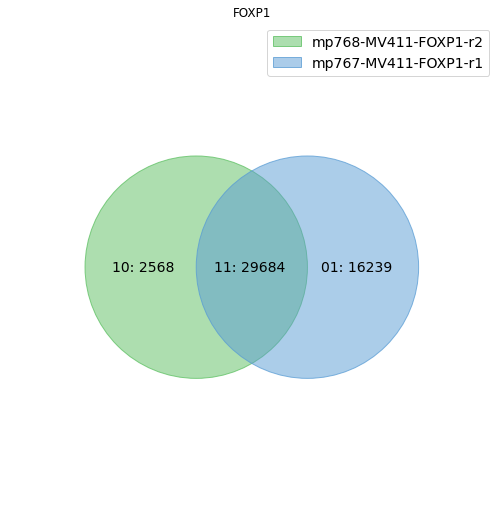

found total peak for this replicate set: [32252 45923]


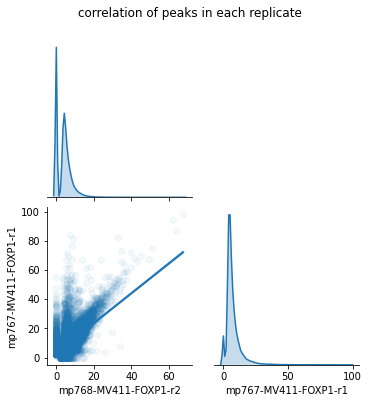

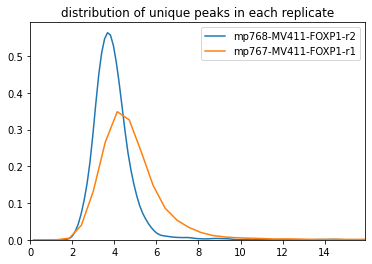

main rep is: mp767-MV411-FOXP1-r1
mp768-MV411-FOXP1-r2
overlap: 64.63863423556823%


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: divide by zero encountered in log
  bw = pyBigWig.open(filepath)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2644: RuntimeWarning: invalid value encountered in double_scalars
  if (fx2 - fval) > delta:
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2653: RuntimeWarning: invalid value encountered in double_scalars
  if 2.0 * (fx - fval) <= bnd:
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflo

1.313552415345718 101.09725006794116 []
enough overlap


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: divide by zero encountered in log
  bw = pyBigWig.open(filepath)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2644: RuntimeWarning: invalid value encountered in double_scalars
  if (fx2 - fval) > delta:
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2653: RuntimeWarning: invalid value encountered in double_scalars
  if 2.0 * (fx - fval) <= bnd:
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflo

1.6468184971500788 82.57614260622178
we have recovered 2323 peaks, equal to 5.014354480108792% of the peaks in main replicate


../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))


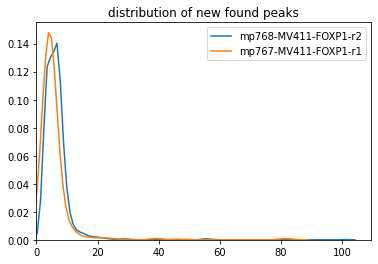

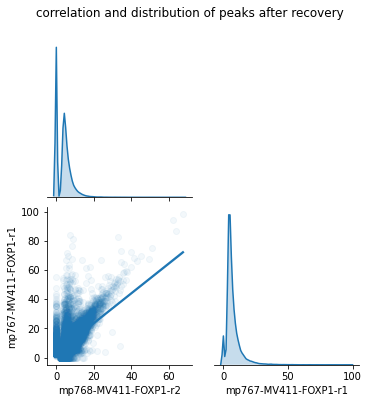

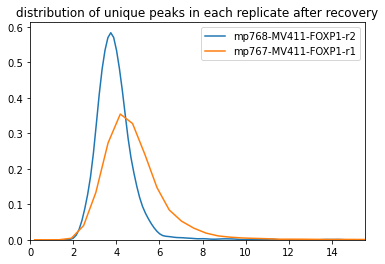

/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:15: UserWarning: `get_labels()` is retained for backwards compatibility; use `generate_petal_labels()` or the higher level `venn()` instead
  warn((
/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:30: UserWarning: `venn2()` is retained for backwards compatibility; use `venn()` instead
  warn((


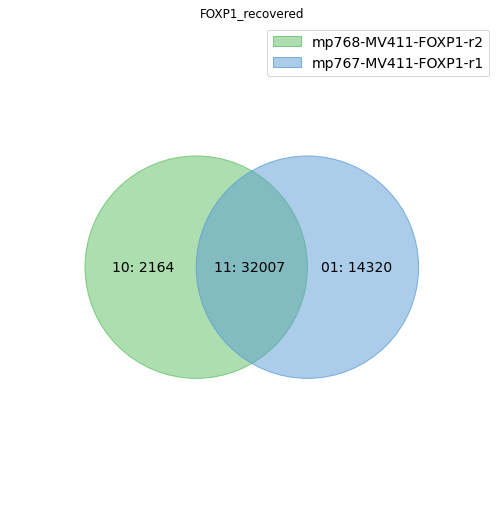

FOXP1 46327
merging GSE1 peaks
finish first overlaps lookup
!TF has less than 1000 PEAKS!


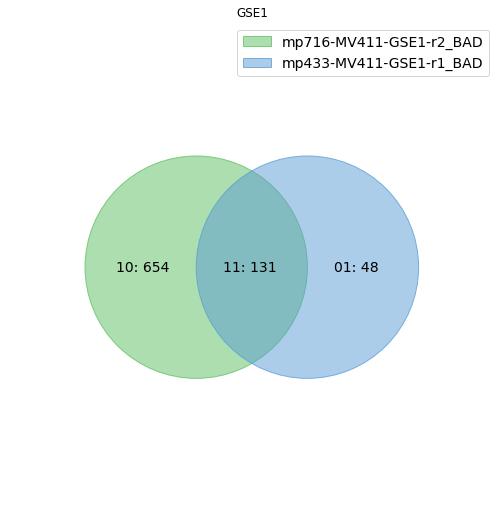

found total peak for this replicate set: [785 179]
no peaks were good enough quality
wrong TF: GSE1


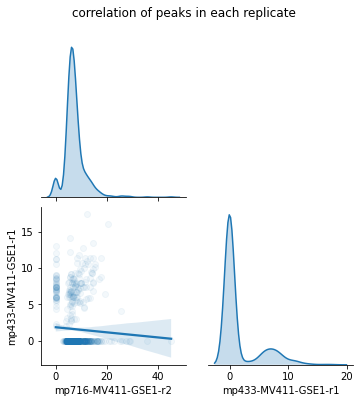

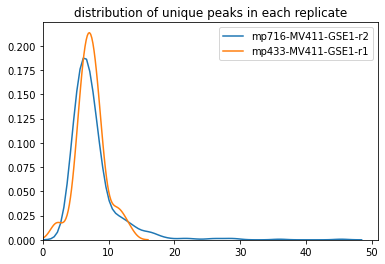

main rep is: mp433-MV411-GSE1-r1
mp716-MV411-GSE1-r2
overlap: 73.18435754189943%


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in 

enough overlap


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return

6.8258870411537815 66.2275190278784
we have recovered 159 peaks, equal to 47.0414201183432% of the peaks in main replicate


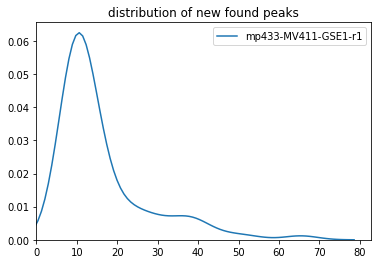

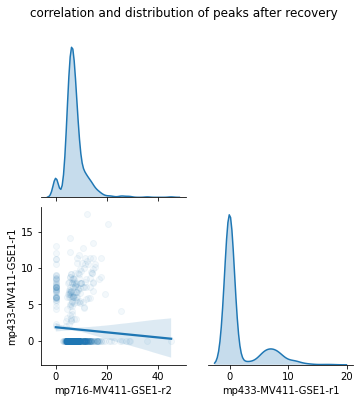

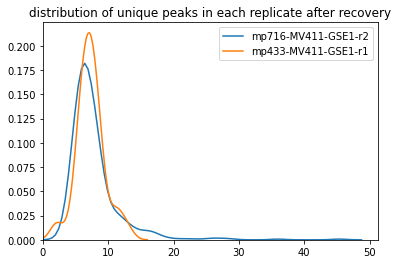

merging IRF2BP2 peaks
finish first overlaps lookup


/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:15: UserWarning: `get_labels()` is retained for backwards compatibility; use `generate_petal_labels()` or the higher level `venn()` instead
  warn((
/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:30: UserWarning: `venn4()` is retained for backwards compatibility; use `venn()` instead
  warn((


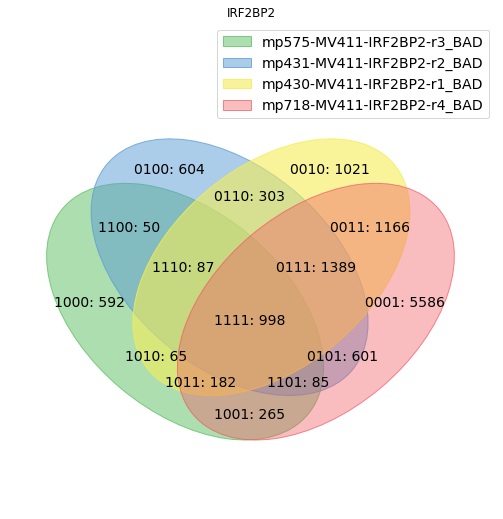

found total peak for this replicate set: [ 2324  4117  5211 10272]
no peaks were good enough quality
wrong TF: IRF2BP2


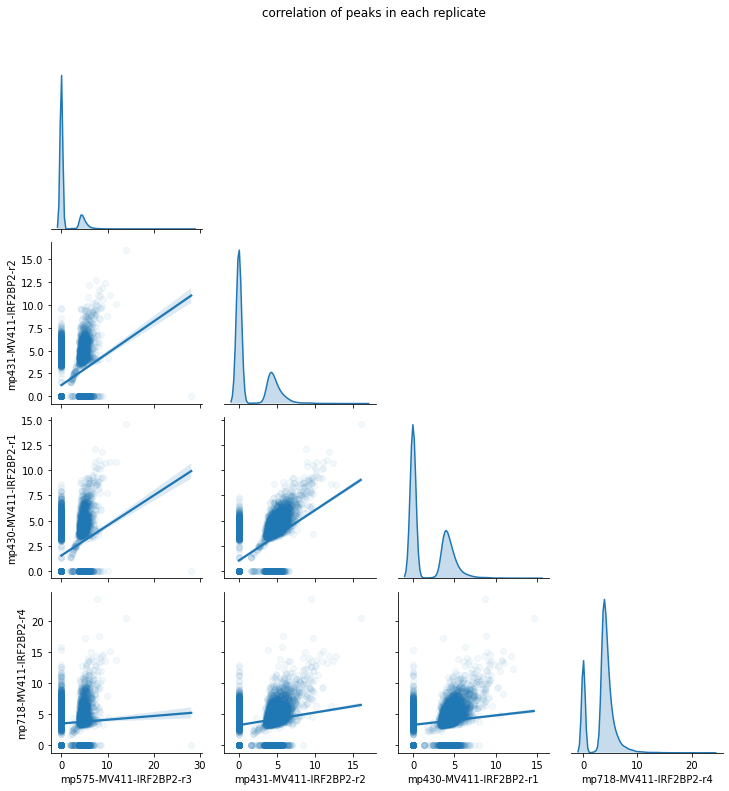

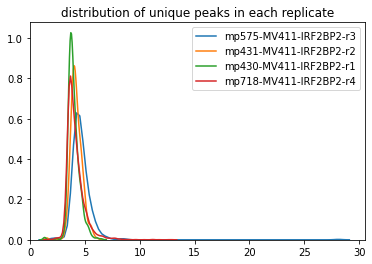

main rep is: mp575-MV411-IRF2BP2-r3
mp718-MV411-IRF2BP2-r4
overlap: 65.83476764199656%


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2644: RuntimeWarning: invalid value encountered in double_scalars
  if (fx2 - f

6.561096283218694 95.2656348730189 []
enough overlap


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in 

7.178695758636794 37.3130776115444
we have recovered 143 peaks, equal to 6.054191363251482% of the peaks in main replicate
mp430-MV411-IRF2BP2-r1
overlap: 57.31497418244407%


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in 

5.377302341753139 74.54312104621668 []
enough overlap
we have recovered 304 peaks, equal to 12.870448772226926% of the peaks in main replicate
mp431-MV411-IRF2BP2-r2
overlap: 52.49569707401033%


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in 

5.577425461226521 39.09551385417364 []
enough overlap
we have recovered 447 peaks, equal to 18.92464013547841% of the peaks in main replicate


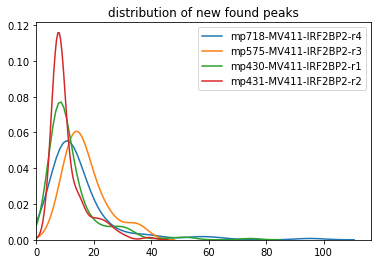

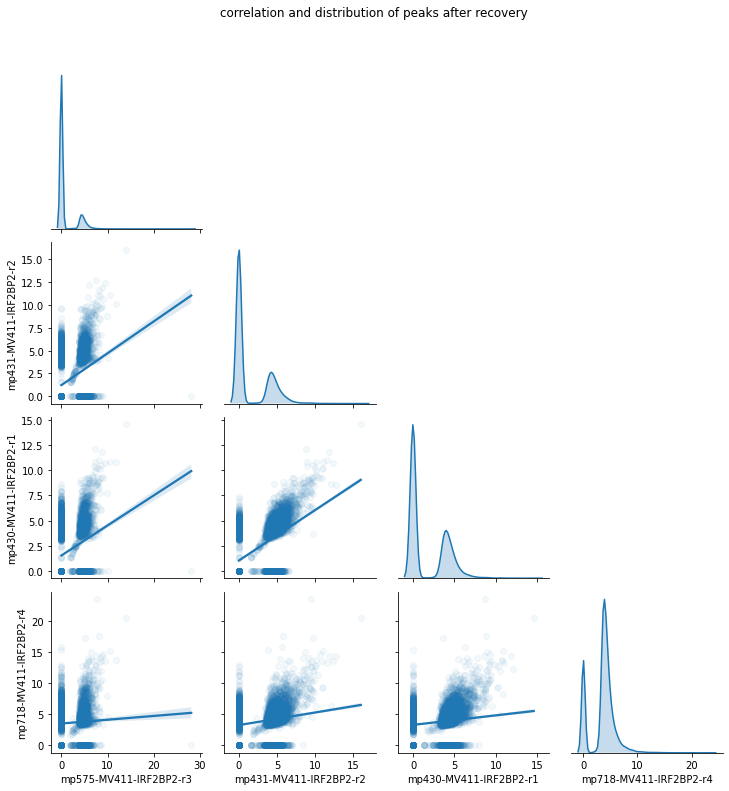

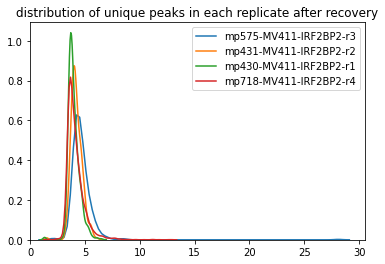

we only have one replicate for LDB1 .. pass
we only have one replicate for H3K79me2 .. pass
merging H3K36me3 peaks
finish first overlaps lookup


/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:15: UserWarning: `get_labels()` is retained for backwards compatibility; use `generate_petal_labels()` or the higher level `venn()` instead
  warn((
/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:30: UserWarning: `venn2()` is retained for backwards compatibility; use `venn()` instead
  warn((


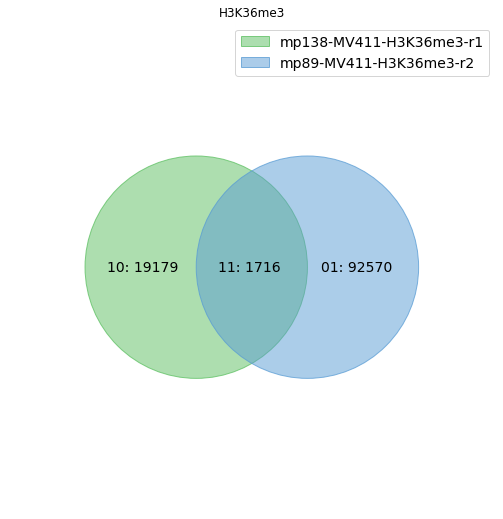

found total peak for this replicate set: [20895 94286]


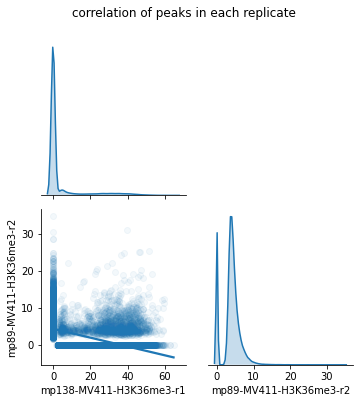

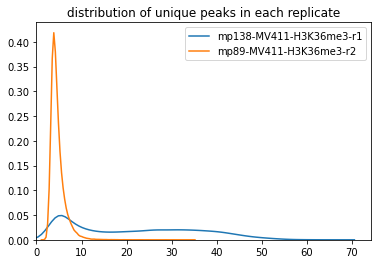

main rep is: mp89-MV411-H3K36me3-r2
mp138-MV411-H3K36me3-r1
overlap: 1.8199944848651974%
not enough overlap
Wrong TF: H3K36me3


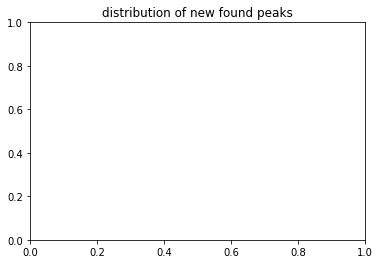

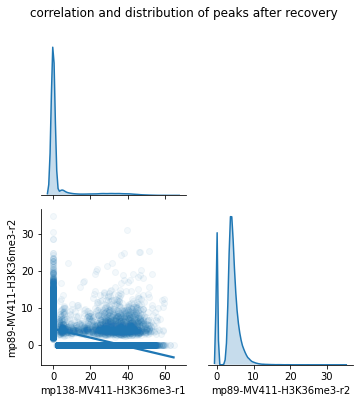

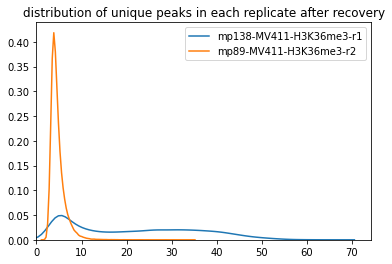

we only have one replicate for PU1_FLAG .. pass
we only have one replicate for MEF2D_FLAG .. pass
we only have one replicate for H3K4me3 .. pass
merging RUNX1 peaks
finish first overlaps lookup


/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:15: UserWarning: `get_labels()` is retained for backwards compatibility; use `generate_petal_labels()` or the higher level `venn()` instead
  warn((
/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:30: UserWarning: `venn3()` is retained for backwards compatibility; use `venn()` instead
  warn((


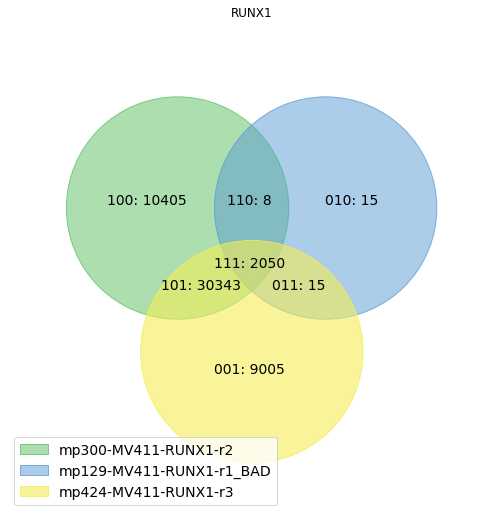

found total peak for this replicate set: [42806  2088 41413]


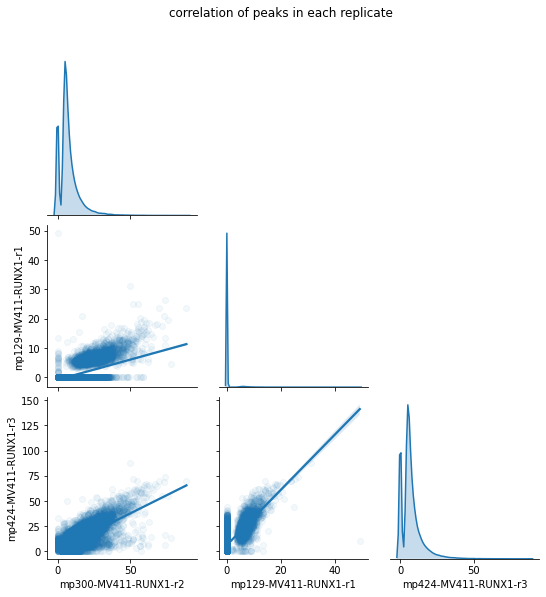

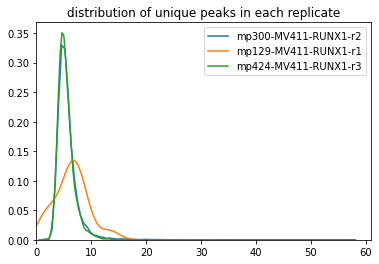

main rep is: mp300-MV411-RUNX1-r2
mp424-MV411-RUNX1-r3
overlap: 75.67397093865345%


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in power
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered i

5.45480585254389 81.10407436970999 []
enough overlap


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in 

5.1343263875435055 79.10158571081898
we have recovered 309 peaks, equal to 0.7187718073970691% of the peaks in main replicate
mp129-MV411-RUNX1-r1
overlap: 4.807737233098164%
not enough overlap


../../JKBio/epigenetics/ChIP_helper.py:780: RuntimeWarning: invalid value encountered in log
  bw = pyBigWig.open(filepath)
../../JKBio/epigenetics/ChIP_helper.py:778: RuntimeWarning: invalid value encountered in log
  def negLogLikelihood(params, data): return - np.sum(np.log(poisson(data, params[0])))
../../JKBio/epigenetics/ChIP_helper.py:779: RuntimeWarning: overflow encountered in exp
  def poissonFit(data): return float(minimize(negLogLikelihood,x0=np.ones(1),args=(data,),method='Powell').x)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:2371: RuntimeWarning: invalid value encountered in double_scalars
  w = xb - ((xb - xc) * tmp2 - (xb - xa) * tmp1) / denom
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1984: RuntimeWarning: invalid value encountered in double_scalars
  tmp1 = (x - w) * (fx - fv)
/home/jeremie/.local/lib/python3.8/site-packages/scipy/optimize/optimize.py:1985: RuntimeWarning: invalid value encountered in 

8.2009771553283 76.22653286177888 []
we did not had enough initial overlap.
enough overlap
we have recovered 328 peaks, equal to 0.7629681321237497% of the peaks in main replicate
enough from small overlap to advice to merge the peaks


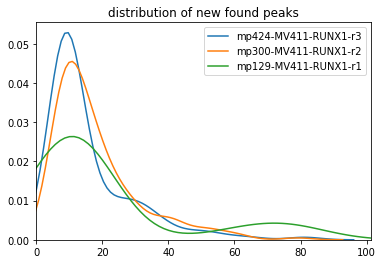

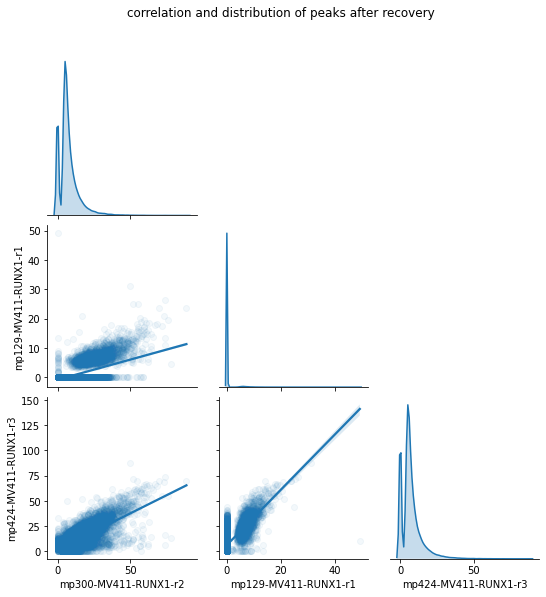

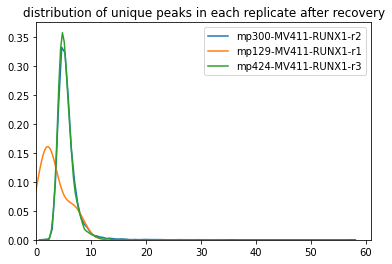

/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:15: UserWarning: `get_labels()` is retained for backwards compatibility; use `generate_petal_labels()` or the higher level `venn()` instead
  warn((
/home/jeremie/.local/lib/python3.8/site-packages/venn/_backwards_compatibility.py:30: UserWarning: `venn3()` is retained for backwards compatibility; use `venn()` instead
  warn((


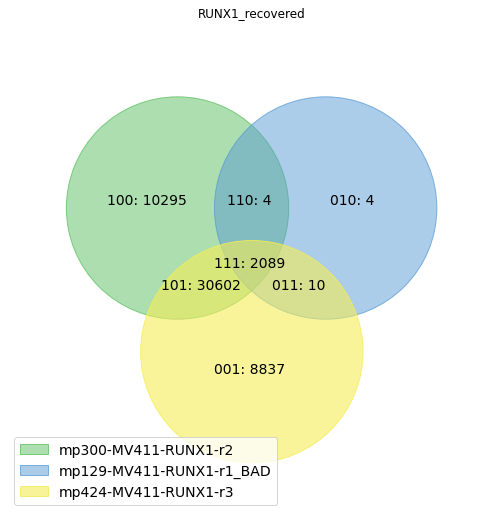

RUNX1 42990


ValueError: If using all scalar values, you must pass an index

In [6]:
%matplotlib inline
mergedpeak, tomergebam, remove, ratiosofunique = chiphelper.mergeReplicatePeaks(bindings,'../../data/bigwig/',markedasbad=bad, window=150, mincov=4, doPlot=True, minKL=10, cov={}, use='poisson', MINOVERLAP=0.25,lookeverywhere=True, only='',saveloc='')

In [ ]:
tomergebam

In [ ]:
mergedpeak = mergedpeak[mergedpeak.columns[[2,9,3,5,6,4,0,1,7,10]]]

In [ ]:
mergedpeak.to_csv('../temp/merged_replicates.csv')

In [2]:
mergedpeak = pd.read_csv('../temp/merged_replicates.csv', index_col=0)

/home/jeremie/.local/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3062: DtypeWarning: Columns (5) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,
/home/jeremie/.local/lib/python3.8/site-packages/numpy/lib/arraysetops.py:569: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  mask |= (ar1 == a)


## show replicates overlap

## sorting and removing samples

In [7]:
bigwigs=os.listdir('../../data/bigwig/')
for val in bigwigs:
    for v in remove + toremove + ['scale','POLII','IGG','CTCF','INPUT']:
        if v in val:
            bigwigs.remove(val)
            break
bigwigs = ['data/bigwig/'+ i for i in bigwigs]

NameError: name 'remove' is not defined

In [62]:
set(mergedpeak.tf)

{'CDK13',
 'CEBPA',
 'CTCF',
 'ELF2',
 'ETV6',
 'FLI1',
 'FOXP1',
 'GATA2',
 'GFI1',
 'H3K27ac',
 'H3K27me3',
 'H3K4me3',
 'H3K79me2',
 'IKZF1',
 'IRF2BP2_FLAG',
 'IRF8',
 'LDB1',
 'LMO2',
 'LYL1',
 'MAX',
 'MED1',
 'MEF2D_FLAG',
 'MEIS1',
 'MYB',
 'MYBL2',
 'MYC',
 'POLII',
 'PU1',
 'PU1_FLAG',
 'RUNX1',
 'RUNX2',
 'SMC1',
 'SP1',
 'ZEB2',
 'ZMYND8'}

In [63]:
mergedpeak.foldchange.min()

1.1767

In [ ]:
mergedpeak['name']=mergedpeak.tf

In [ ]:
## Removing bad ChIP protein
mergedpeak = mergedpeak[~mergedpeak['name'].isin(['CDK13','GSE1'])]

## Create a consensus set

In [ ]:
merged = chiphelper.simpleMergePeaks(mergedpeak[~mergedpeak.tf.isin(['MED1','SMC1','CTCF','POLII','IRF2BP2_FLAG','IRF2BP2', 'H3K27ac', 'H3K27me3', 'H3K4me3', 'H3K79me2',])], window=150)

In [49]:
len(merged)

401964

In [8]:
len(mergedpeak)

1795655

In [53]:
merged

,chrom,start,end,peak_number,foldchange,-log10pvalue,-log10qvalue,relative_summit_pos,ZEB2,PU1,...,RUNX2,FOXP1,MYB,ETV6,MAX,MEIS1,FLI1,LYL1,MEF2D_FLAG,ELF2
0,chr1,9871,10426,0,5.660748,167.597710,113.516687,236,0.0,0.00000,...,5.750405,0.00000,0.0,0.0,0.00000,0.00000,0.0,0.0,0.0,0.0
1,chr1,181115,181583,1,5.582072,13.719270,10.515070,432,0.0,0.00000,...,0.000000,0.00000,0.0,0.0,3.85919,6.42691,0.0,0.0,0.0,0.0
2,chr1,267795,268177,2,7.898975,448.796925,351.318955,200,0.0,0.00000,...,7.898975,0.00000,0.0,0.0,0.00000,0.00000,0.0,0.0,0.0,0.0
3,chr1,271061,271390,3,5.825944,4270.465248,1288.072707,224,0.0,3.69205,...,5.431833,0.00000,0.0,0.0,4.44630,0.00000,0.0,0.0,0.0,0.0
4,chr1,274361,274524,4,3.919940,4.925860,2.932390,163,0.0,0.00000,...,0.000000,0.00000,0.0,0.0,3.91994,0.00000,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
401959,chrY,56853053,56853501,401959,8.004440,45.614230,43.286370,189,0.0,0.00000,...,0.000000,0.00000,0.0,0.0,0.00000,0.00000,0.0,0.0,0.0,0.0
401960,chrY,56858512,56858723,401960,6.185595,519.925882,350.663218,154,0.0,0.00000,...,0.000000,0.00000,0.0,0.0,0.00000,0.00000,0.0,0.0,0.0,0.0
401961,chrY,56859773,56859965,401961,3.215700,8.500200,6.465140,96,0.0,0.00000,...,0.000000,0.00000,0.0,0.0,0.00000,0.00000,0.0,0.0,0.0,0.0
401962,chrY,56876514,56876799,401962,4.175505,7.796570,5.376070,56,0.0,3.52829,...,0.000000,0.00000,0.0,0.0,0.00000,0.00000,0.0,0.0,0.0,0.0


In [ ]:
merged.to_csv('../temp/merged.bed', sep='\t',index=None)

In [2]:
merged = pd.read_csv('../temp/merged.bed', sep='\t')

ValueError: Axes instance argument was not found in a figure

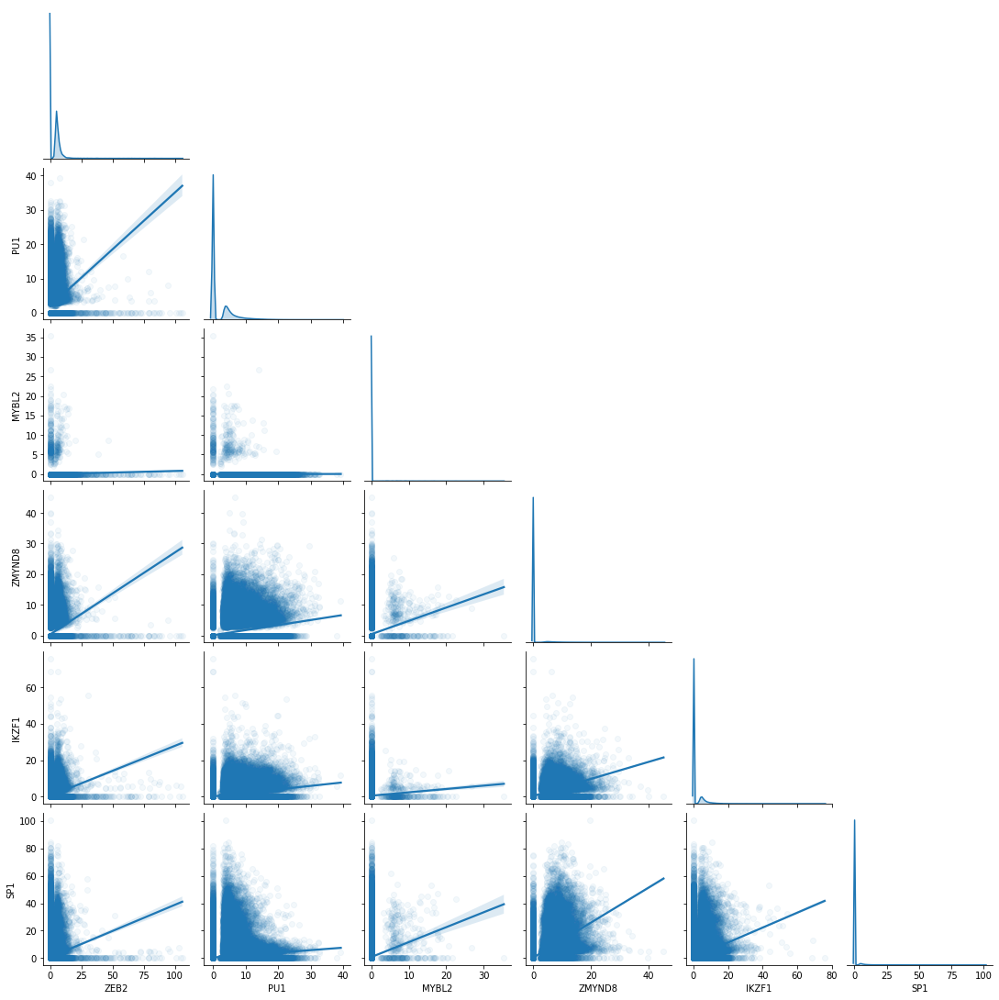

In [13]:
fig = sns.pairplot(merged[merged.columns[8:14]], corner=True, diag_kind="kde", kind="reg", plot_kws ={"scatter_kws":{"alpha":.05}})
def col_nan_scatter(x,y, **kwargs):
    df = pd.DataFrame({'x':x[:],'y':y[:]})
    df = df[df.sum(0)!=0]
    x = df['x']
    y = df['y']
    plt.gca()
    plt.scatter(x,y)
def col_nan_kde_histo(x, **kwargs):
    df = pd.DataFrame({'x':x[:]})
    df = df[df['x']!=0]
    x = df['x']
    plt.gca()
    sns.kdeplot(x)
fig = fig.map_upper(col_nan_scatter)
fig = fig.map_upper(col_nan_kde_histo)
fig.savefig('../results/cobinding/pairplot_experiments.pdf')
plt.show()
counts,val = np.unique(merged[merged.columns[8:]].astype(bool).sum(1).values, return_counts=True)
fig = sns.barplot(data=pd.DataFrame(val, index=counts,columns=['counts']).T).set_yscale("log")
fig.savefig('../results/cobinding/pairplot_experiments.pdf')
plt.show()
i = merged[merged.columns[8:]].astype(bool).sum(1)
print(i.max(),i.mean(),i.min())

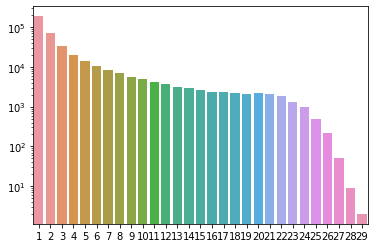

In [28]:
counts,val = np.unique(merged[merged.columns[8:]].astype(bool).sum(1).values, return_counts=True)
fig = sns.barplot(data=pd.DataFrame(val, index=counts,columns=['counts']).T).set_yscale("log")
fig.savefig("../results/cobinding/cobinding_distribution.pdf")

In [3]:
len(merged)

401964

## Random distribution compare

### computation:

we are evalutating each event's probability 1 binding, 2 binding, n binding.., as a binomial over the amount of proability p_i with n retries corresponding to the size of the conscensus peak set.
the probability p_i of this binomial is the sum of probabilities of having tf a binding with b for all possible combination of tf. 
the number of combination is k amongst n, n being 33, k going from 1 to 29
we compute 

$p(a & b) = p(a)\*p(b) =p(ab)$

and 

$p(a & b) | p(a & c) = p(ab) + p(ac) - p(abc)$

for a,b,c,d:

$p(ab) + p(ac) + p(ad) + p(bc) + p(bd) + p(cd) - {3\choose 2}*(p(abc) - p(abd) - p(bcd) - p(acd)) - {4\choose 2}*p(abcd)$

In [9]:
proba = merged[merged.columns[8:]].astype(bool).sum(0)/len(merged)
sums = {i:0 for i in range(1,30)}

In [45]:
#sums = {i:0 for i in range(1,30)}
for i in range(29,0,-1):
    print(i)
    if sums[i]> 0:
        continue
    print(helper.combin(33,i))
    for j in itertools.combinations(proba, i):
        sums[i]+=np.prod(j) 

29
40920
28
237336
27
1107568
26
4272048
25
13884156
24
38567100
23
92561040
22
193536720
21
354817320
20
573166440
19
818809200
18
1037158320
17
1166803110
16
1166803110
15
1037158320
14
818809200
13
573166440
12
354817320
11
193536720
10
92561040
9
38567100
8
13884156
7
4272048
6
1107568
5
237336
4
40920
3
5456
2
528
1
33


In [25]:
sums = helper.fileToDict('sums.json')
sums

{'1': 3.564197291299719,
 '2': 5.947767094926423,
 '3': 6.193912229381676,
 '4': 4.526211082329878,
 '5': 2.474013034404779,
 '6': 1.0527317472780933,
 '7': 0.35829715644081034,
 '8': 0.09943938818272037,
 '9': 0.022825381481644175,
 '10': 0.004379413021252811,
 '11': 0.00070792759386874,
 '12': 9.697816157595999e-05,
 '13': 1.130513900179171e-05,
 '14': 1.1245418897924897e-06,
 '15': 9.558680206339548e-08,
 '16': 6.944613188988552e-09,
 '17': 4.308465164466324e-10,
 '18': 2.2776987855529827e-11,
 '19': 1.0225495417396802e-12,
 '20': 3.879502794987101e-14,
 '21': 1.235755790273511e-15,
 '22': 3.2767005948973246e-17,
 '23': 7.152743413724904e-19,
 '24': 1.2670744860664492e-20,
 '25': 1.7876238259716017e-22,
 '26': 1.959177088958401e-24,
 '27': 1.6123818958693174e-26,
 '28': 9.500138862026422e-29,
 '29': 3.736153334366771e-31}

In [26]:
for i in range(29,0,-1):
    for j in range(i+1,30):
        icomb = helper.combin(j,i)
        sums[str(i)] -= icomb*sums[str(j)]

In [27]:
sums

{'1': 0.08018545980941805,
 '2': 0.17624101729305602,
 '3': 0.23649718994952393,
 '4': 0.2184692643756451,
 '5': 0.14845650385772652,
 '6': 0.07739412989917571,
 '7': 0.03185917213742954,
 '8': 0.01057268945222497,
 '9': 0.0028723352317763418,
 '10': 0.0006462599891400417,
 '11': 0.00012147764926434383,
 '12': 1.9201641160238405e-05,
 '13': 2.564417228900678e-06,
 '14': 2.902951061659037e-07,
 '15': 2.790582264404235e-08,
 '16': 2.2793450152477172e-09,
 '17': 1.580914936526954e-10,
 '18': 9.293291541027129e-12,
 '19': 4.615221117102491e-13,
 '20': 1.9272162593710218e-14,
 '21': 6.723376115661141e-16,
 '22': 1.9429691428243096e-17,
 '23': 4.59985132825406e-19,
 '24': 8.793156463935868e-21,
 '25': 1.3318088792740753e-22,
 '26': 1.5583793115437678e-24,
 '27': 1.3615467902701066e-26,
 '28': 8.416654395060058e-29,
 '29': 3.736153334366771e-31}

In [12]:
from scipy.stats import binom
for i in range(29,0,-1):
    print(i,binom.mean(len(merged), sums[str(i)]),binom.var(len(merged), sums[str(i)]))
    sums[str(i)] = [binom.mean(len(merged), sums[str(i)]),binom.var(len(merged), sums[str(i)])]

29 1.5017991388954048e-25 1.5017991388954048e-25
28 3.383192067255921e-23 3.383192067255921e-23
27 5.472927940041331e-21 5.472927940041331e-21
26 6.264123815853791e-19 6.264123815853791e-19
25 5.353392243485244e-17 5.353392243485244e-17
24 3.5345323448695175e-15 3.5345323448695175e-15
23 1.848974639310315e-13 1.848974639310315e-13
22 7.810036485262307e-12 7.810036485262307e-12
21 2.7025551569556153e-10 2.7025551569556137e-10
20 7.746715564818134e-09 7.746715564817985e-09
19 1.8551527411149854e-07 1.855152741114129e-07
18 3.7355686409974288e-06 3.7355686409627127e-06
17 6.354708915461204e-05 6.354708914456579e-05
16 0.0009162146397090334 0.0009162146376206641
15 0.011217136093289838 0.011217135780266427
14 0.11668818205487132 0.11668814818086312
13 1.030803406997832 1.0308007635878156
12 7.71836848733407 7.718220281992034
11 48.8296418088927 48.82371009879134
10 259.7732502746877 259.6053692167863
9 1154.5753591057455 1151.2590316240453
8 4249.840542974158 4204.9082986918165
7 12806.240

In [13]:
data = pd.DataFrame(sums).T.rename(columns={0:'mean',1:'var'})

In [24]:
merged[merged.columns[8:]].astype(bool).sum().sum()

1432679

In [37]:
(val*counts).sum()

1432679

In [48]:
int((data['mean'] * data.index.astype(int)).sum())

1432679

In [16]:
data.sum()

mean    395266.309560
var     326805.810475
dtype: float64

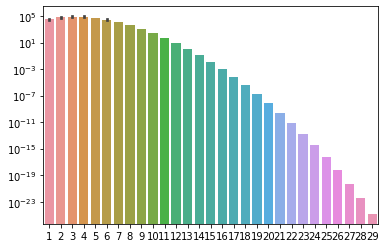

In [90]:
fig = sns.barplot(data=data.T).set_yscale("log")
fig.savefig("../results/cobinding/expected_cobinding_distribution.pdf")

In [74]:
res = pd.DataFrame()
res['change']=val/data['mean']
res['count']=list(res.index)

In [75]:
res

,change,count
1,5.887378e+00,1
2,1.020728e+00,2
3,3.632420e-01,3
4,2.317211e-01,4
5,2.371713e-01,5
6,3.374837e-01,6
7,6.490586e-01,7
8,1.618178e+00,8
9,4.964596e+00,9
10,1.905893e+01,10


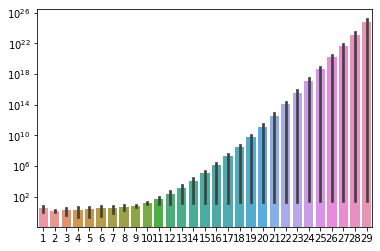

In [76]:
fig = sns.barplot(data=res.T).set_yscale("log")
fig.savefig("../results/cobinding/cobinding_enrichment.pdf")

In [35]:
res.T

NameError: name 'res' is not defined

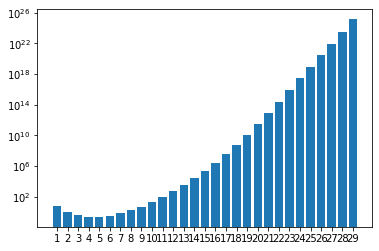

In [102]:
fig = plt.bar(res['count'],res['change'],log=True)
fig.savefig("../results/cobinding/correlation_onoverlap.pdf")
plt.show()

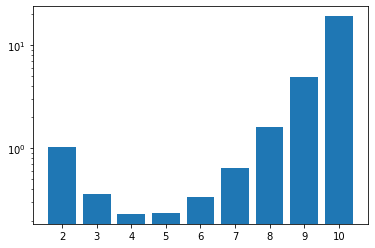

In [105]:
fig = plt.bar(ares['count'],ares['change'],log=True)
fig.savefig("../results/cobinding/cobinding_enrichment_zoomed.pdf")
plt.show()

## Correlation over consensus set

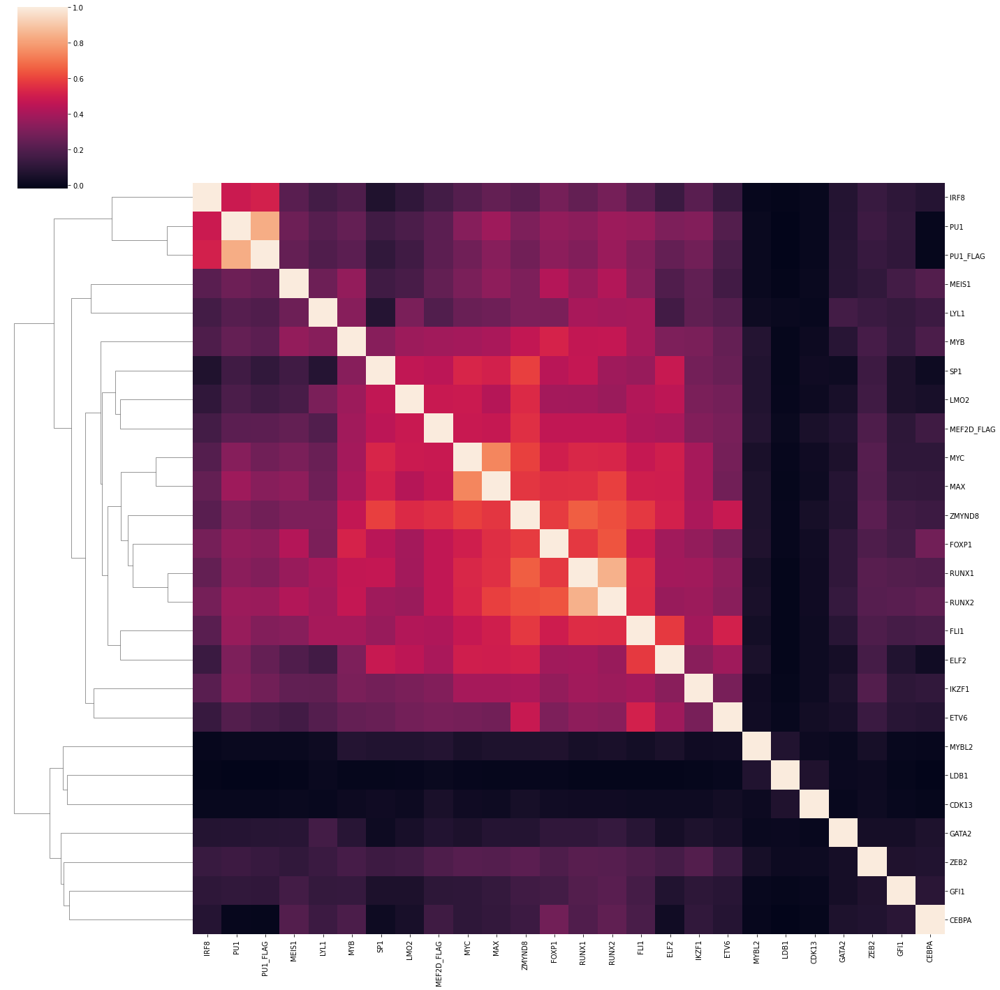

In [38]:
sns.clustermap(np.corrcoef(stats.zscore(merged[merged.columns[8:]].values.T, axis=1)), figsize=(20, 20), xticklabels=merged.columns[8:], yticklabels=merged.columns[8:]).ax_col_dendrogram.set_visible(False)
fig.savefig("../results/cobinding/correlation_cobinding_regular.pdf")

In [445]:
merged[merged.columns[:8]].to_csv('../temp/conscensus.bed',sep='\t',index=None, columns=None)

## annotatePeaks

In [181]:
additional = {}
additional['activation'] = chiphelper.simpleMergePeaks(mergedpeak[mergedpeak.tf.isin(["H3K27ac",'H3K79me2','H3K36me3','H3K4me3'])], window=10, mergedFold="max")
additional['repression'] = mergedpeak[mergedpeak.tf=='H3K27me3']
additional['IRF2BP2'] = mergedpeak[mergedpeak.tf=='IRF2BP2_FLAG']
additional['MED1'] = mergedpeak[mergedpeak.tf=='MED1']
additional['SMC1'] = mergedpeak[mergedpeak.tf=='SMC1']
additional['CTCF'] = mergedpeak[mergedpeak.tf=='CTCF']
additional['POLII'] = mergedpeak[mergedpeak.tf=='POLII']

0.0030390512230328093

0.00972184293683923

0.012581437990090899

0.018998946670307805

0.04155970818866305

0.04432957515702415

0.04732571294815277

0.053567666679670736

0.05687980337845746

0.06009831077127141

0.06331291694300316

0.06635977060820036

0.06972262318105567

0.07300745133226699

0.07904654156751063

0.08206608668513245

0.08522997698279562

0.10326142082471813

0.10662817461865563

0.11273358561229666

0.1159481917840284

0.1224008114539851

0.12552959076190848

0.12870518472281825

0.1355674326064058

0.1386571997035072

0.14171185581086881

0.1451293254788749

0.14879647329614168

0.1515858463699138

0.1546014902664534

0.1577107634689658

0.16082393789256036

0.16419849412866228

0.17045605274450903

0.17989310654234775

0.18948230796239224

0.19276713611360355

0.198743806811532

0.20195061054109936

0.2082588850310147

0.22298989583739712

0.2380564116568486

0.24106425311122381

0.2441852299769828

0.25048960324581593

0.2744821129013381

0.2780205204228924

0.28485545975890453

0.287867202434362

0.30319900128740296

0.3159364881207818

0.3192486248195685

0.3223813053485741

0.32563492373112785

0.32877930792338

0.33170132251394685

0.33514610072952833

0.33824367026879415

0.3414465727772793

0.34460656185386024

0.35684079116763545

0.3599110521593259

0.3634728670073733

0.366726485389927

0.37003472086763156

0.37321811727070575

0.37611282331369716

0.37954589786603204

0.38258885031014706

0.38570592595482384

0.38873717473569225

0.39215074318261617

0.3954628798814029

0.3987711153591074

0.40174384582374284

0.40529395700854365

0.41150860219248625

0.4144228143408887

0.4207661998205438

0.423891077907385

0.42735146100729526

0.4303944134514103

0.44540631217571097

0.4487418562009909

0.45170288300237976

0.45483166231030314

0.4579994538290485

0.46458471501579995

0.46769008699723014

0.4738657199703507

0.47695158584636993

0.4800140443958959

0.4832091444622167

0.48627160301174266

0.49282955565091874

0.4958217922209652

0.5058128194124761

0.5088050559825226

0.5118480084266376

0.5149533804080677

0.5179690243046073

0.526914524246089

0.5303046853665198

0.5369562673116686

0.5402957125580307

0.54334646744431

0.5528498420005462

0.5559240042133188

0.559442905629462

0.5624156360940975

0.5805797214528148

0.5837085007607381

0.5870713533335934

0.5930870362423438

0.5962158155502673

0.611602231498459

0.6174696680060859

0.6205516326610229

0.6240315218663441

0.6364608122342293

0.6546600085826864

0.6608473452190535

0.6666757695158585

0.6697421292864667

0.6732064136074591

0.6764171185581087

0.6799438224164164

0.6831623298092303

0.6860960480630437

0.6893847774353372

0.6926032848281513

0.7106659384387313

0.7170717434557017

0.7235360667889049

0.7269223266882534

0.7329731205867437

0.7362891585066126

0.7395817890999883

0.74244138415324

0.7455311512503413

0.7486677330004291

0.7611828502321226

0.7671322123824758

0.7699684001092342

0.782491319783092

0.7856747161861662

0.7920181016658214

0.7950610541099364

0.8014824640112355

0.8044278859282955

0.8076229859946163

0.8141770374127102

0.8206491631880779

0.8236999180743573

0.8271759060585964

0.8303436975773417

0.8365388366558733

0.8399836148714548

0.8432294308118441

0.8495572114071704

0.8528966566535325

0.8592166348066945

0.8630359302461671

0.8660476729216244

0.8693520071782468

0.8726407365505403

0.8817071743455701

0.8852065696563024

0.8914485233878204

0.8975383294971326

0.9040338625989934

0.907147037022588

0.9102055943510319

0.9163890297663169

0.9194826980845004

0.922634884718917

0.9299067608161354

0.933234502399251

0.9362150353060508

0.9393048024031522

0.9423399524051028

0.9454297195022042

0.9483205243241134

0.9551359575547146

0.9613506027386572

0.9675379393750244

0.9709085943900441

0.9738150040962822

0.9770023017204384

0.9802013030078415

0.9834627238325596

0.9865290836031678

0.993090937463426

0.9961182850232123

In [198]:
for key, val in additional.items():
    merged[key] = chiphelper.putInConscensus(merged[merged.columns[:8]],val)
    merged = merged.replace(np.nan,0)
    merged[key].astype(bool).sum()

0.001365793951697167

0.02585554925316695

0.04290185190713596

109381 were merged into conscensus
6101 were merged into conscensus
19353 were merged into conscensus
38023 were merged into conscensus


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [61]:
# adding ATACseq
ATAC= chiphelper.loadPeaks(peakFile='../../data/ATACseq/ATAC_MV411.mRp.clN_peaks.broadPeak')

In [178]:
len(ATAC)

129439

In [183]:
merged['ATAC'] = chiphelper.putInConscensus(merged[merged.columns[:8]],ATAC)
merged = merged.replace(np.nan,0)

0.024218586739110964

0.04031455553233623

0.043105850275149016

0.0473574747987382

0.051021982068045896

0.05855001940472281

0.06333651769810232

0.06746872854285459

0.07108348011264691

0.07773084156790161

127490 were merged into conscensus


In [184]:
merged['ATAC'].astype(bool).sum()

127431

In [185]:
#compute enhancers at TSS in the matrix (promoters)
promoters = pd.read_csv('../data/human_epdnew_TeLy2.bed', sep='\t',header=None).rename(columns={0:'chrom',1:'start',2:'end',3:'name',5:'strand'}).drop(4,1)

In [186]:
promoters['foldchange']=1

In [187]:
promoters['name']=[i[:-2] for i in promoters['name']]

In [188]:
merged['promoters'] = chiphelper.putInConscensus(merged[merged.columns[:8]],promoters)
merged = merged.replace(np.nan,0)

0.006493118786757023

0.01933008926172493

0.049233264670468

0.10781064970992427

0.1113681822252739

10989 were merged into conscensus


In [189]:
merged['promoters'].astype(bool).sum()

10223

## add super enhancers and compute other enhancer

In [125]:
set(bindings[bindings.tf=="H3K27ac"].name)

{'mp136-MV411-H3K27ac-r1',
 'mp183-MV411_DMSO-H3K27ac-r1',
 'mp70-MV411-H3K27ac-r2',
 'mp702-MV411_DMSO-H3K27ac-r1',
 'mp734-MV411_DMSO-H3K27ac-r1',
 'mp88-MV411-H3K27ac-r3'}

In [5]:
! mkdir ../../data/MV411_H3K27ac
! cp ../../data/MV4narrow/mp70-MV411-H3K27ac-r2.narrowPeak ../../data/MV411_H3K27ac
! cp ../../data/MV4narrow/mp734-MV411_DMSO-H3K27ac-r1.narrowPeak ../../data/MV411_H3K27ac
! cp ../../data/BroadPeaks/MV411/mp88-MV411-H3K27ac-r3.broadPeak ../../data/MV411_H3K27ac
! cp ../../data/BroadPeaks/MV411/mp702-MV411_DMSO-H3K27ac-r1.broadPeak ../../data/MV411_H3K27ac
! cp ../../data/BroadPeaks/MV411/mp183-MV411_DMSO-H3K27ac-r1.broadPeak ../../data/MV411_H3K27ac
! cp ../../data/BroadPeaks/MV411/mp136-MV411-H3K27ac-r1.broadPeak ../../data/MV411_H3K27ac
! gsutil cp gs://amlproject/Chip/results/bwa/mergedLibrary/*MV411*H3K27* MV411_H3K27ac/

TypeError: MakeSuperEnhancers() missing 1 required positional argument: 'outdir'

In [4]:
peaks = [
"../../data/MV411_H3K27ac/mp70-MV411-H3K27ac-r2.narrowPeak",
"../../data/MV411_H3K27ac/mp734-MV411_DMSO-H3K27ac-r1.narrowPeak",
"../../data/MV411_H3K27ac/mp88-MV411-H3K27ac-r3.broadPeak",
"../../data/MV411_H3K27ac/mp702-MV411_DMSO-H3K27ac-r1.broadPeak",
"../../data/MV411_H3K27ac/mp183-MV411_DMSO-H3K27ac-r1.broadPeak",
"../../data/MV411_H3K27ac/mp136-MV411-H3K27ac-r1.broadPeak"
]

In [178]:
for val in peaks:
    valbed = val +".bed"
    ! mv $val $valbed

In [10]:
peaks[1:]

['../../data/MV411_H3K27ac/mp734-MV411_DMSO-H3K27ac-r1.narrowPeak',
 '../../data/MV411_H3K27ac/mp88-MV411-H3K27ac-r3.broadPeak',
 '../../data/MV411_H3K27ac/mp702-MV411_DMSO-H3K27ac-r1.broadPeak',
 '../../data/MV411_H3K27ac/mp183-MV411_DMSO-H3K27ac-r1.broadPeak',
 '../../data/MV411_H3K27ac/mp136-MV411-H3K27ac-r1.broadPeak']

In [12]:
for peak in peaks[1:]:
    chiphelper.MakeSuperEnhancers(peak+'.bed',
                             bamFile='.'.join(peak.split('.')[:-1])+'.mLb.clN.sorted.bam',
                             baiFile='.'.join(peak.split('.')[:-1])+'.mLb.clN.sorted.bam.bai',
                             controlBam= '../../data/diffBinding_hist/INPUT_R1.mLb.clN.sorted.bam',
                             controlBai= '../../data/diffBinding_hist/INPUT_R1.mLb.clN.sorted.bam.bai',
                             outdir ='~/data/MV411_H3K27ac',
                             rosePath="../src/ROSE/")

we are going to move your input files to ../src/ROSE/
finished.. moving them back to their original folder
we are going to move your input files to ../src/ROSE/
finished.. moving them back to their original folder
we are going to move your input files to ../src/ROSE/
finished.. moving them back to their original folder
we are going to move your input files to ../src/ROSE/
finished.. moving them back to their original folder
we are going to move your input files to ../src/ROSE/
finished.. moving them back to their original folder


In [26]:
! rm ~/data/MV411_H3K27ac/*.bam*

LICENSE       README.md               ROSE_callSuper.R    ROSE_main_turbo.py
patch.sh*     ROSE_bamToGFF.py        ROSE_geneMapper.py  ROSE_utils.py
__pycache__/  ROSE_bamToGFF_turbo.py  ROSE_main.py


In [18]:
## loading and merging
! mkdir ../results/ROSE/MV411/
! cp ~/data/MV411_H3K27ac/*.txt ../results/ROSE/MV411/
! cp ~/data/MV411_H3K27ac/*.bed ../results/ROSE/MV411/
! cp ~/data/MV411_H3K27ac/*.png ../results/ROSE/MV411/

gff
mappedGFF
mp136-MV411-H3K27ac-r1_12KB_STITCHED_TSS_DISTAL_ENHANCER_REGION_MAP.txt
mp136-MV411-H3K27ac-r1_AllEnhancers.table.txt
mp136-MV411-H3K27ac-r1.broadPeak.bed
mp136-MV411-H3K27ac-r1_Enhancers_withSuper.bed
mp136-MV411-H3K27ac-r1_Gateway_Enhancers.bed
mp136-MV411-H3K27ac-r1_Gateway_SuperEnhancers.bed
mp136-MV411-H3K27ac-r1.mLb.clN.sorted.bam
mp136-MV411-H3K27ac-r1.mLb.clN.sorted.bam.bai
mp136-MV411-H3K27ac-r1_Plot_points.png
mp136-MV411-H3K27ac-r1_SuperEnhancers.table.txt
mp183-MV411_DMSO-H3K27ac-r1_12KB_STITCHED_TSS_DISTAL_ENHANCER_REGION_MAP.txt
mp183-MV411_DMSO-H3K27ac-r1_AllEnhancers.table.txt
mp183-MV411_DMSO-H3K27ac-r1.broadPeak.bed
mp183-MV411_DMSO-H3K27ac-r1_Enhancers_withSuper.bed
mp183-MV411_DMSO-H3K27ac-r1_Gateway_Enhancers.bed
mp183-MV411_DMSO-H3K27ac-r1_Gateway_SuperEnhancers.bed
mp183-MV411_DMSO-H3K27ac-r1.mLb.clN.sorted.bam
mp183-MV411_DMSO-H3K27ac-r1.mLb.clN.sorted.bam.bai
mp183-MV411_DMSO-H3K27ac-r1_Plot_points.png
mp183-MV411_DMSO-H3K27ac-r1_SuperEnhancers.ta

In [35]:
rose = chiphelper.ReadRoseSuperEnhancers("../results/ROSE/MV411/")

In [36]:
rose = chiphelper.simpleMergePeaks(rose,window=1000).drop(columns=["relative_summit_pos","-log10pvalue","-log10qvalue"])

0.609548012343438

In [37]:
rose = rose[rose[rose.columns[5:]].astype(bool).sum(1)>1]
rose = rose.sort_values(by=['chrom','start','end']).reset_index(drop=True)

In [199]:
merged['super_enhancer'] = chiphelper.putInConscensus(merged[merged.columns[:8]],rose)
merged = merged.replace(np.nan,0)

0.014944124349444228

0.046081241106168715

0.054278492601327485

0.05924659919793812

0.06163487277467634

0.06296086216676121

0.0703943636743589

0.07351902160392473

0.07536247027096954

0.08156700600053736

0.08527380561443314

0.09022698550118916

0.09643400901573275

0.10263356917534903

0.1088356171199411

22746 were merged into conscensus


In [200]:
merged['super_enhancer'].astype(bool).sum()

22746

In [ ]:
## loading super enhancer from max's files

In [ ]:
## comparing

In [231]:
## making regulat enhancers merged["regular_enhancers"]
merged['regular_enhancer'] = (merged['activation'].astype(bool) & ~merged[['super_enhancer','promoters']].astype(bool).sum(1).astype(bool)).astype(float)

In [41]:
set(mergedpeak.tf)

{'CDK13',
 'CEBPA',
 'CTCF',
 'ELF2',
 'ETV6',
 'FLI1',
 'FOXP1',
 'GATA2',
 'GFI1',
 'H3K27ac',
 'H3K27me3',
 'H3K4me3',
 'H3K79me2',
 'IKZF1',
 'IRF2BP2_FLAG',
 'IRF8',
 'LDB1',
 'LMO2',
 'LYL1',
 'MAX',
 'MED1',
 'MEF2D_FLAG',
 'MEIS1',
 'MYB',
 'MYBL2',
 'MYC',
 'POLII',
 'PU1',
 'PU1_FLAG',
 'RUNX1',
 'RUNX2',
 'SMC1',
 'SP1',
 'ZEB2',
 'ZMYND8'}

In [86]:
l = ['H3K27ac','ATAC','H3K27me3','SMC1',"POLII","MED1","H3K79me2","H3K4me3","CTCF"]

In [ ]:
l = ['H3K27ac', 'ATAC', 'H3K27me3', 'SMC1', "POLII", "MED1", "H3K79me2", "H3K4me3", "CTCF", 'CEBPA',"PU1_FLAG"]

In [58]:
! cp ../temp/MV411Merged/ATAC.bed ../../data/ATACseq/ATAC_MV411.mRp.clN_peaks.broadPeak 

In [81]:
#! mkdir ../temp/MV411Merged
for i in set(mergedpeak.tf):
    a = mergedpeak[mergedpeak.tf==i][['chrom','start',"end",'peak_number',"foldchange"]]
    a['strand']='+'
    a.to_csv("../temp/MV411Merged/"+i+'.bed', sep='\t', index=False)

In [82]:
a = ATAC[['chrom','start',"end","peak_number",'foldchange']]
a['strand'] = '+'
a.to_csv('../temp/MV411Merged/ATAC.bed',index=False,sep='\t')

<ipython-input-82-b482aa0bc9d7>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  a['strand'] = '+'


In [88]:
## computing CHROMHMM
#!mkdir ../data/chromHMM/
chrombed = chiphelper.runChromHMM(numstates=8, outdir='~/AMLproject/data/chromHMM/', data=pd.DataFrame([['MV411']*len(l),l,["AMLproject/temp/MV411Merged/"+i+'.bed' for i in l]]).T, datatype='bed', folderPath="~/", chromHMMFolderpath="../src/ChromHMM/", control_bam_dir=None)['MV411']

you need to have ChromHMM
CompletedProcess(args='java -mx8000M -jar ../src/ChromHMM/ChromHMM.jar BinarizeBed ../src/ChromHMM/CHROMSIZES/hg38.txt ~/ ~/AMLproject/data/chromHMM/input_data.tsv ~/AMLproject/data/chromHMM/binarized/', returncode=0, stdout=b'Writing to file /home/jeremie/AMLproject/data/chromHMM/binarized//MV411_chr1_binary.txt\nWriting to file /home/jeremie/AMLproject/data/chromHMM/binarized//MV411_chr2_binary.txt\nWriting to file /home/jeremie/AMLproject/data/chromHMM/binarized//MV411_chr3_binary.txt\nWriting to file /home/jeremie/AMLproject/data/chromHMM/binarized//MV411_chr4_binary.txt\nWriting to file /home/jeremie/AMLproject/data/chromHMM/binarized//MV411_chr5_binary.txt\nWriting to file /home/jeremie/AMLproject/data/chromHMM/binarized//MV411_chr6_binary.txt\nWriting to file /home/jeremie/AMLproject/data/chromHMM/binarized//MV411_chr7_binary.txt\nWriting to file /home/jeremie/AMLproject/data/chromHMM/binarized//MV411_chrX_binary.txt\nWriting to file /home/jeremie/AMLpr

CompletedProcess(args='java -mx8000M -jar ../src/ChromHMM/ChromHMM.jar LearnModel -printposterior -noautoopen ~/AMLproject/data/chromHMM/binarized/ ~/AMLproject/data/chromHMM/ 8 hg38', returncode=0, stdout=b'Writing to file /home/jeremie/AMLproject/data/chromHMM//transitions_8.txt\nWriting to file /home/jeremie/AMLproject/data/chromHMM//emissions_8.txt\nWriting to file /home/jeremie/AMLproject/data/chromHMM//emissions_8.svg\nWriting to file /home/jeremie/AMLproject/data/chromHMM//emissions_8.png\nWriting to file /home/jeremie/AMLproject/data/chromHMM//transitions_8.png\nWriting to file /home/jeremie/AMLproject/data/chromHMM//transitions_8.svg\nWriting to file /home/jeremie/AMLproject/data/chromHMM//model_8.txt\n Iteration  Estimated Log Likelihood     Change    Total Time (secs)\n         1              -4243702.619          -                 15.7\n         2              -3421111.894 822590.725                 22.6\n         3              -3292616.415 128495.479                 29.3\

In [110]:
chrombed = pd.read_csv('~/AMLproject/data/chromHMM/MV411_8_dense.bed',sep='\t',header=None, skiprows=1).drop(columns=[4,5,6,7]).rename(columns={0:'chrom',1:'start',2:'end',3:'state',8:"color"})

In [158]:
statetocol={i: chrombed[chrombed['state']==i].iloc[0]['color'] for i in set(chrombed['state'])}

In [111]:
chrombed['foldchange']= chrombed['state']

In [116]:
merged['HMM_states'] = chiphelper.putInConscensus(merged[merged.columns[:8]],chrombed,window=1,mergetype='first')
merged = merged.replace(np.nan,0)

0.001253843627787563

0.03300793105850275

0.0381999383029326

517805 were merged into conscensus


In [6]:
merged['regular_enhancer'] = merged['regular_enhancer'].astype(float)

In [120]:
merged.to_csv('../temp/merged.bed', sep='\t',index=None)

In [1]:
merged = pd.read_csv('../temp/merged.bed', sep='\t')

NameError: name 'pd' is not defined

# Co Binding Matrix

Look at AUC for all ChIPs over all peaks of all ChIPs

In [159]:
statetocol.update({0:'0,0,0'})

In [160]:
for i,v in statetocol.items():
    statetocol[i] = tuple([int(i)/256 for i in v.split(',')])

In [169]:
rand = np.random.choice(merged.index,5000)
viridis = cm.get_cmap('viridis', 256)
data = merged[merged.columns[-12:]]
for val in data.columns[:-4]:
    data[val] =stats.zscore(np.log2(1+data[val]))
    data[val] = (((data[val] -data[val].min())/ (data[val].max()))*256).astype(int)
#print(data['HMM_states'])
data = data.loc[rand]
for val in data.columns[:-1]:
    a = [viridis(v) for v in data[val]]
    data[val] = a
data['HMM_states'] = [statetocol[i] for i in data['HMM_states']]
data = data.rename(columns={'SMC1':'cohesin','MED1':'mediator','ATAC':'open regions'})

<ipython-input-169-5133fbeaa0e8>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[val] =stats.zscore(np.log2(1+data[val]))
<ipython-input-169-5133fbeaa0e8>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[val] = (((data[val] -data[val].min())/ (data[val].max()))*256).astype(int)


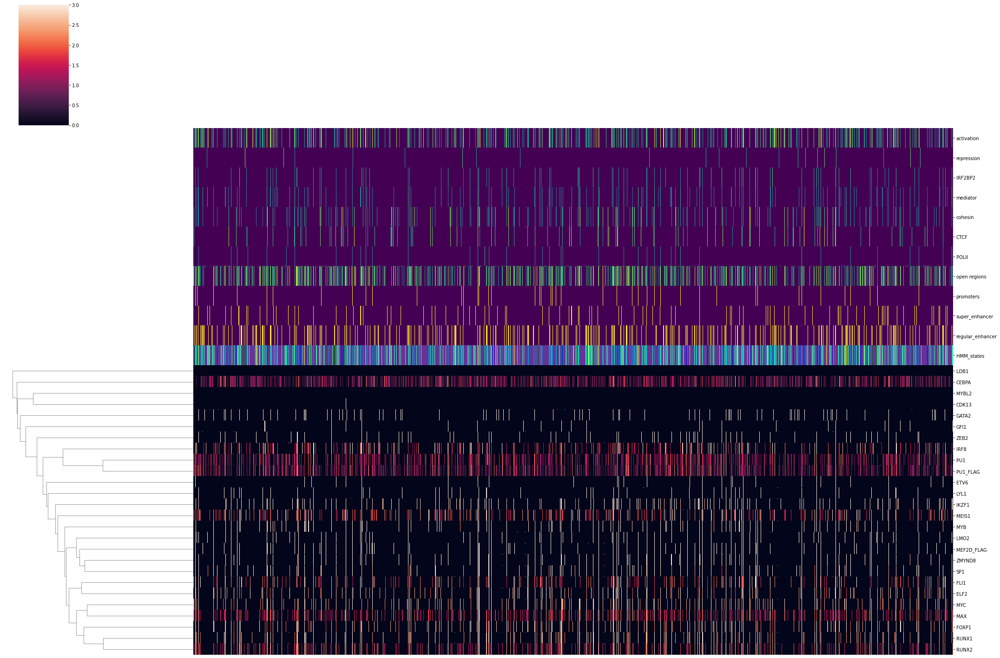

In [171]:
fig = sns.clustermap(np.log2(1.01+merged[merged.columns[8:-12]].loc[rand].T),col_cluster=False, z_score=0, vmin=0,vmax=3, col_colors = data, figsize=(30,20),xticklabels=False)
fig.ax_col_dendrogram.set_visible(False)
fig.savefig('../temp/clustermap_cobinding_scaled_marks.pdf')
plt.show()

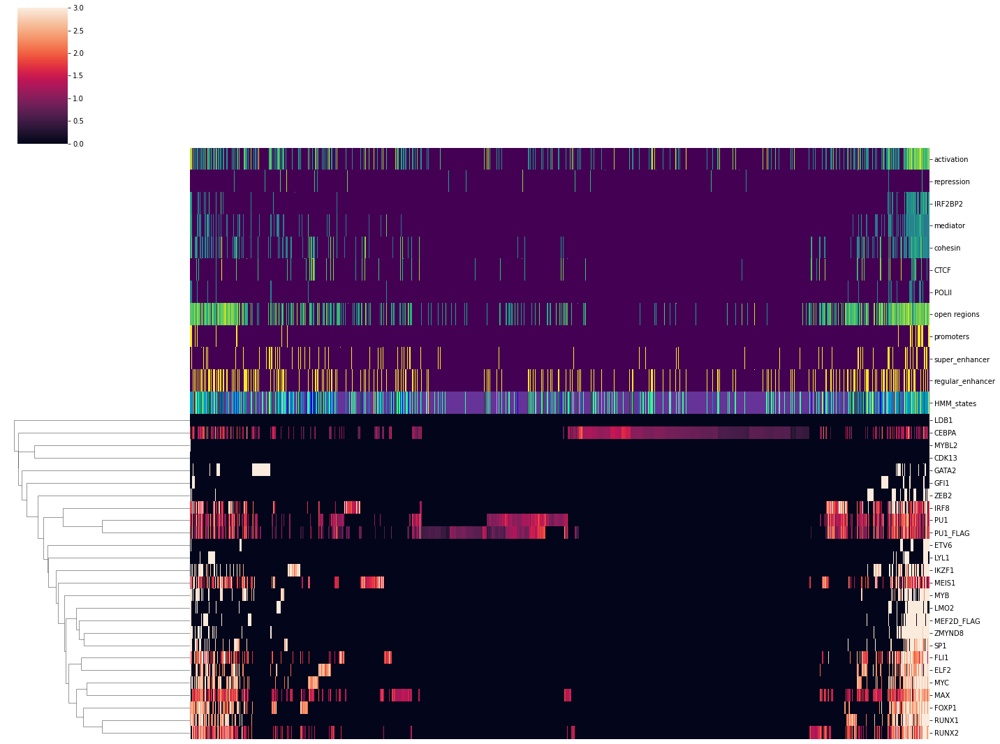

In [170]:
fig = sns.clustermap(np.log2(1.01+merged[merged.columns[8:-12]].loc[rand].T), vmin=0,vmax=3,figsize=(20,15),z_score=0,col_colors=data, xticklabels=False)
fig.ax_col_dendrogram.set_visible(False)
fig.savefig('../temp/clustermap_cobinding_scaled_marks.pdf')
plt.show()

## clustering

I have tried gaussian mixtures and Agglomerative clustering algorithm. Only the second can create a hierarchical clustering.

It seems that gaussian mixture makes more sense given the data we have, for now, is more "homogeneous". 

**I am still not so happy with the clustering.** It can be because of the how much importance, outlier values and the high number of noisy values from locations with no peaks.

We can use similar methods to RNAseq to improve this (clamping values, log transform, first round of PCA..)


In [ ]:
labels = DBSCAN(n_components=2, covariance_type='diag').fit_predict(subcor)

In [ ]:
names = np.array([i.split('.')[-4].split('/')[-1] for i in bigwigs])
sort = labels.argsort()
p = helper.plotCorrelationMatrix(data=cor[sort],
                            names=names[sort],
                            colors=labels[sort],
                            title="correlation between TF occupancy",
                            interactive=True)

In [ ]:
show(p)

In [ ]:
p = helper.scatter(TSNE(2,5).fit_transform(subcor),labels=names, colors=labels)

In [ ]:
show(p)

In [ ]:
sns.clustermap(subcor)

## Looking at peak overlap 

How many of peak in A (column) overlaps with peak in B (rows)

in other words:

what is the percentage of B's peaks that are overlaped by A's peaks 

In [239]:
merged[merged.columns[8:]].sum()

ZEB2                9.791522e+04
PU1                 8.320657e+05
MYBL2               2.954344e+03
ZMYND8              1.680816e+05
IKZF1               2.335969e+05
SP1                 3.137599e+05
RUNX1               3.689981e+05
PU1_FLAG            1.959412e+06
LDB1                3.476826e+03
IRF8                1.084504e+06
CDK13               6.596954e+02
GATA2               2.540219e+05
GFI1                6.347511e+04
CEBPA               1.491259e+06
MYC                 2.317540e+05
LMO2                1.186369e+05
RUNX2               7.357505e+05
FOXP1               3.074798e+05
MYB                 2.162326e+05
ETV6                6.700642e+04
MAX                 4.929492e+05
MEIS1               6.107451e+05
FLI1                7.584027e+05
LYL1                1.087278e+05
MEF2D_FLAG          1.133790e+05
ELF2                4.600765e+05
activation          6.682423e+05
repression          3.724429e+04
IRF2BP2             8.982705e+04
MED1                1.653259e+05
SMC1      

In [ ]:
data = pd.DataFrame(stats.zscore(0.01+merged[merged.columns[8:]]).T, columns=merged.index, index=merged.columns[8:])
link = linkage(data[:-11])
col = data[-11:]
col = col[[co for co in col.columns if co not in col.index.tolist()]]
for val in col.columns:
    col[val] = [viridis(v) for v in col[val]]
fig = sns.clustermap(np.corrcoef(data.iloc[:-11])[data.columns[np.concatenate((leaves_list(link),[26,27,28,29,30,31,32,33,34,35,36]))]], row_linkage=link, col_colors=col.T, col_cluster=False)
fig.ax_col_dendrogram.set_visible(False)
fig.savefig('../results/cobinding/correlation_with_annotation.pdf')
plt.show()

In [7]:
overlap, correlation,_ = chiphelper.computePairwiseOverlap(merged, norm=True,enrichment=False)

/home/jeremie/.local/lib/python3.8/site-packages/scipy/stats/stats.py:2419: RuntimeWarning: invalid value encountered in true_divide
  return (a - mns) / sstd


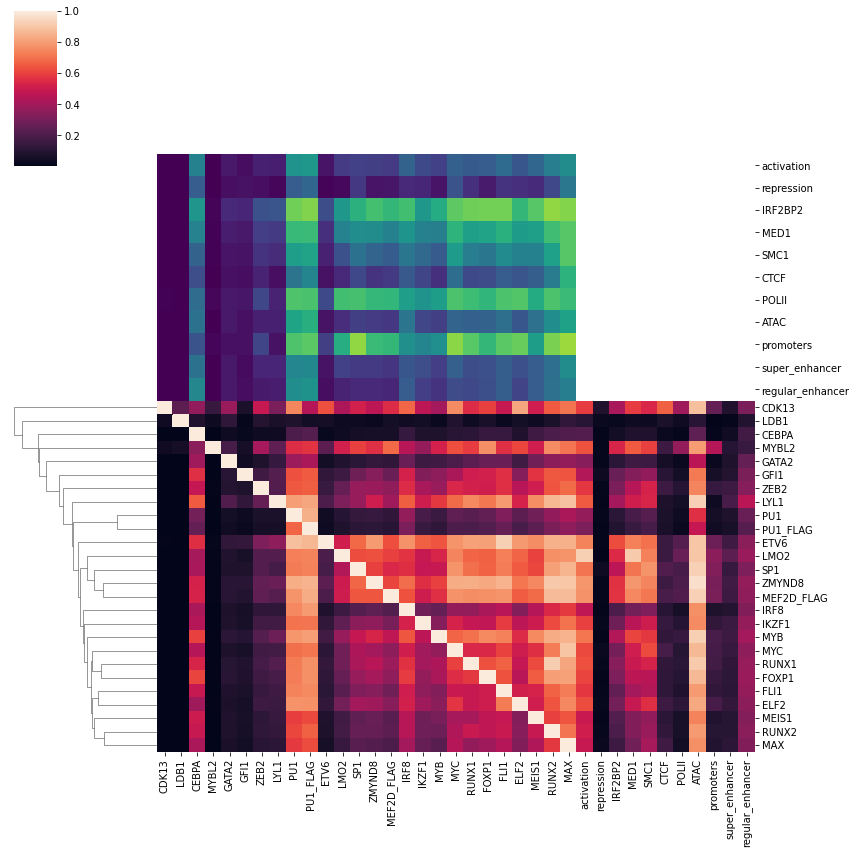

In [20]:
data = pd.DataFrame(data=overlap,index=merged.columns[8:], columns=merged.columns[8:])
link = linkage(data.iloc[:-11]) # D being the measurement
col = data[-11:]
col = col[[co for co in col.columns if co not in col.index.tolist()]]
for val in col.columns:
    a = [viridis(v) for v in col[val]]
    col[val] = a
fig = sns.clustermap(data.iloc[:-11][data.columns[np.concatenate((leaves_list(link),[26,27,28,29,30,31,32,33,34,35,36]))]], row_linkage=link, col_colors=col.T, col_cluster=False,figsize=(12,12))
fig.ax_col_dendrogram.set_visible(False)
fig.savefig('../results/cobinding/overlap.pdf')
plt.show()

## data on the experiments

In [193]:
pd.concat([merged[merged.columns[8:]].astype(bool).sum(0),
           merged[merged.columns[8:]].max(),
           merged[merged.columns[8:]].replace(0, np.NaN).mean(),
          merged[merged.columns[8:]].replace(0, np.NaN).var()],axis=1).rename(columns={0:'sum',1:'max',2:'mean',3:'std'})

,sum,max,mean,std
ZEB2,14840,105.835243,6.598060,26.193602
PU1,132026,39.307407,6.302286,11.779725
MYBL2,352,35.384420,8.393023,18.988820
ZMYND8,22763,45.176055,7.383982,12.719919
IKZF1,35402,75.841090,6.598409,12.622733
SP1,25642,101.007463,12.236169,126.036058
RUNX1,42088,60.824327,8.767299,26.120400
PU1_FLAG,165175,64.507190,11.862644,110.706303
LDB1,569,30.134750,6.110416,5.419185
IRF8,64621,150.599790,16.782527,460.609597


## Correlation only on overlaps 

on the overlaps given above

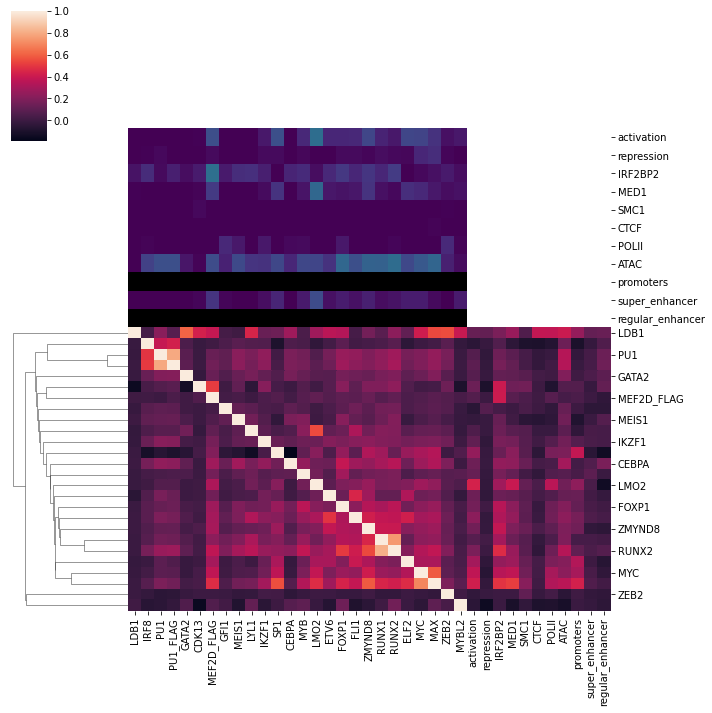

In [21]:
data = pd.DataFrame(data=correlation,index=merged.columns[8:], columns=merged.columns[8:])
link = linkage(data.iloc[:-11]) # D being the measurement
col = data.iloc[-11:]
col = col[[co for co in col.columns if co not in col.index.tolist()]]
for val in col.columns:
    a = [viridis(v) for v in col[val]]
    col[val] = a
fig = sns.clustermap(data.iloc[:-11][data.columns[np.concatenate((leaves_list(link),[26,27,28,29,30,31,32,33,34,35,36]))]], row_linkage=link, col_colors=col.T, col_cluster=False)
fig.ax_col_dendrogram.set_visible(False)
fig.savefig("../results/cobinding/correlation_onoverlap.pdf")
plt.show()

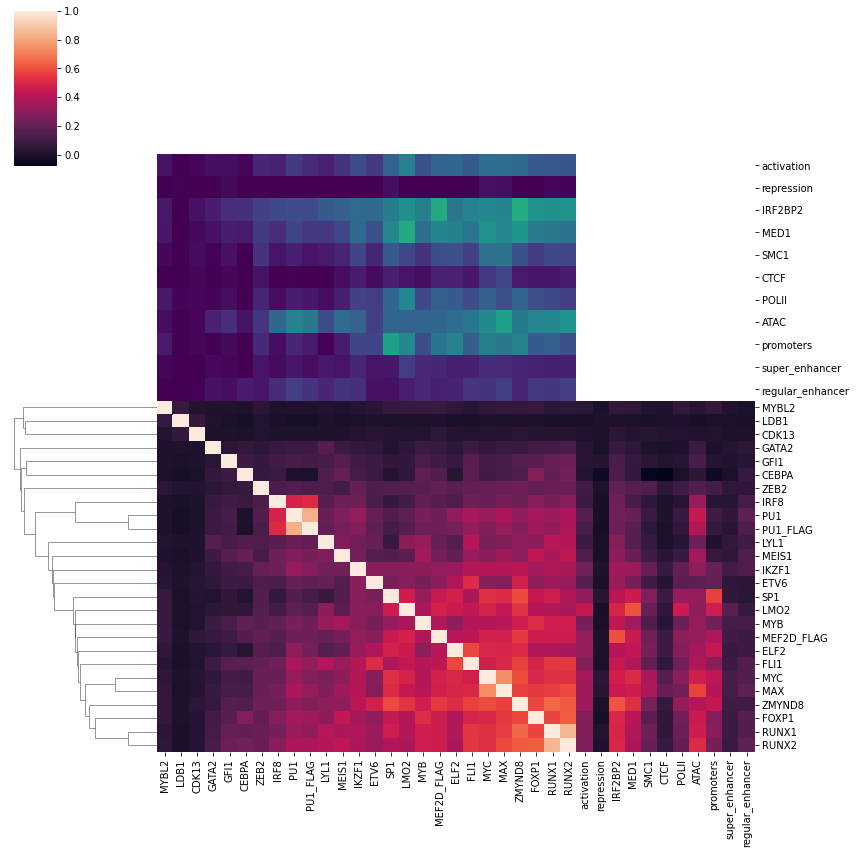

In [26]:
data = pd.DataFrame(data=np.corrcoef(stats.zscore(merged[merged.columns[8:]]).T), index=merged.columns[8:], columns=merged.columns[8:])
link = linkage(data.iloc[:-11]) # D being the measurement
col = data.iloc[-11:]
col = col[[co for co in col.columns if co not in col.index.tolist()]]
for val in col.columns:
    a = [viridis(v) for v in col[val]]
    col[val] = a
fig = sns.clustermap(data.iloc[:-11][data.columns[np.concatenate((leaves_list(link),[26,27,28,29,30,31,32,33,34,35,36]))]], row_linkage=link, col_colors=col.T, col_cluster=False,figsize=(12,12))
fig.ax_col_dendrogram.set_visible(False)
fig.savefig("../results/cobinding/correlation_onoverlap.pdf")
plt.show()

## get percentage data between TF and other:
        superenhancer, regular, promoter, HMM states*8, cohesin, mediator
promoter
superenhancer
cohesin
mediator
TFs

In [205]:
dat  = {}
for val in merged.columns[8:-12].tolist() + ['activation', 'repression', 'IRF2BP2',
    'ATAC', 'MED1', 'SMC1', 'CTCF', 'promoters', 'super_enhancer']:
    w = merged[merged[val]!=0]
    dat[val] = []
    for i in range(1,9):
        dat[val].append(len(w[w['HMM_states']==i])/len(w))
    for i in ['regular_enhancer','MED1','SMC1','CTCF','promoters','super_enhancer']:
        dat[val].append(len(w[w[i]!=0])/len(w))
dat = pd.DataFrame(data=dat,index= ['state_'+ str(i) for i in range(1,9)] + ['regular_enhancer','mediator','cohesin','CTCF','promoters','superenhancer']).T

In [211]:
from matplotlib.ticker import FuncFormatter
# just overlap here

(array([ 0.5,  1.5,  2.5,  3.5,  4.5,  5.5,  6.5,  7.5,  8.5,  9.5, 10.5,
        11.5, 12.5, 13.5]),
 <a list of 14 Text major ticklabel objects>)

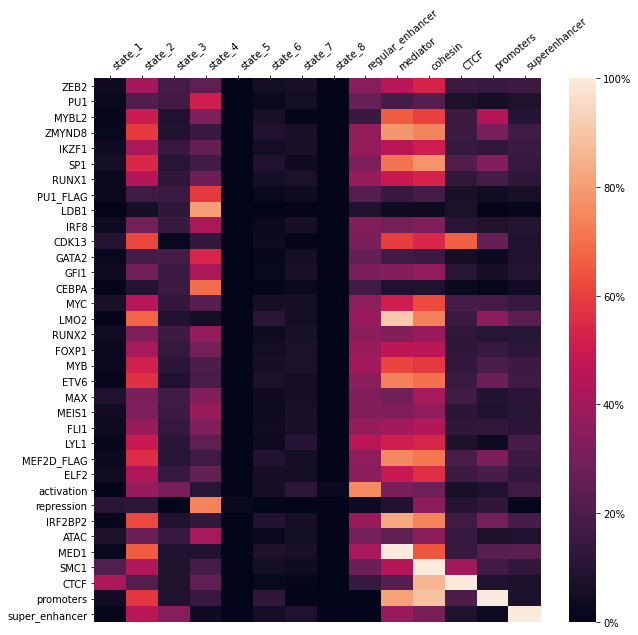

In [223]:
ig, ax = plt.subplots(figsize=(10,10)) 
ax = sns.heatmap(dat,ax=ax)
ax.xaxis.set_ticks_position('top')
cbar = ax.collections[0].colorbar
cbar.set_ticks([0, .2, .4, .6,.8,1.0])
cbar.set_ticklabels(['0%', '20%', '40%', '60%', '80%', '100%'])
plt.xticks(rotation=40,ha='left')
fig.savefig("../results/cobinding/percentage_overlap.pdf")

## Enrichment

In [7]:
for i in range(1,9):
    merged['state_'+str(i)] = (merged.HMM_states==i).astype(float)
merged = merged.drop(columns=['HMM_states'])

In [12]:
overlap, _, enrichment  = chiphelper.computePairwiseOverlap(merged, norm=False,docorrelation=False)

In [15]:
enrichment = enrichment.replace(-np.inf,-100)

In [16]:
enrichment

,ZEB2,PU1,MYBL2,ZMYND8,IKZF1,SP1,RUNX1,PU1_FLAG,LDB1,IRF8,...,super_enhancer,regular_enhancer,state_1,state_2,state_3,state_4,state_5,state_6,state_7,state_8
ZEB2,1.000000,0.982361,3.479981,2.771181,2.235034,2.556744,2.312019,0.685611,1.388578,1.783833,...,1.498066,0.893040,0.385889,1.828532,0.100631,-1.345782,0.828766,1.720653,1.184751,-0.415287
PU1,0.982361,1.000000,0.761522,1.356144,1.098385,1.138377,1.140556,1.039720,-2.054188,1.197333,...,0.479156,0.561018,-0.241137,0.850097,0.046001,-0.307995,0.134939,0.797363,0.754995,-0.402960
MYBL2,3.479981,0.761522,1.000000,3.319497,2.079155,3.238974,2.503513,0.481851,5.326918,1.490443,...,0.813233,-0.267248,-1.147076,2.125004,-1.031633,-0.995134,-100.000000,2.152139,-1.752868,-0.226969
ZMYND8,2.771181,1.356144,3.319497,1.000000,2.669083,3.413455,3.003902,1.053775,-0.922518,2.111047,...,1.597127,1.022078,-0.598279,2.354416,-0.918033,-2.068429,0.533494,2.503109,1.139051,-1.514020
IKZF1,2.235034,1.098385,2.079155,2.669083,1.000000,2.452684,2.204231,0.786755,-0.839766,1.708463,...,1.430582,1.035824,0.435390,1.869376,-0.195766,-1.266785,1.097988,1.750429,1.285601,-0.689256
SP1,2.556744,1.138377,3.238974,3.413455,2.452684,1.000000,2.732920,0.843712,-1.011874,1.797521,...,1.385904,0.813633,0.785075,2.235791,-0.688925,-1.905467,2.169031,2.483446,0.557529,-1.165831
RUNX1,2.312019,1.140556,2.503513,3.003902,2.204231,2.732920,1.000000,0.902134,-1.504382,1.819868,...,1.158657,1.058338,-0.045389,1.938879,-0.426622,-1.203710,0.572776,1.845179,1.308338,-1.574070
PU1_FLAG,0.685611,1.039720,0.481851,1.053775,0.786755,0.843712,0.902134,1.000000,-3.114326,0.953145,...,0.179207,0.313255,-0.302234,0.529498,-0.133040,-0.106986,-0.647666,0.505080,0.480581,-0.595362
LDB1,1.388578,-2.054188,5.326918,-0.922518,-0.839766,-1.011874,-1.504382,-3.114326,1.000000,-1.871437,...,-2.008903,-0.987582,-2.576895,-1.177474,-0.453185,0.340708,-100.000000,-3.064276,-2.445721,0.402106
IRF8,1.783833,1.197333,1.490443,2.111047,1.708463,1.797521,1.819868,0.953145,-1.871437,1.000000,...,0.741095,0.854759,0.121848,1.358173,-0.167915,-0.582044,-0.386855,1.054468,1.117376,-0.895504


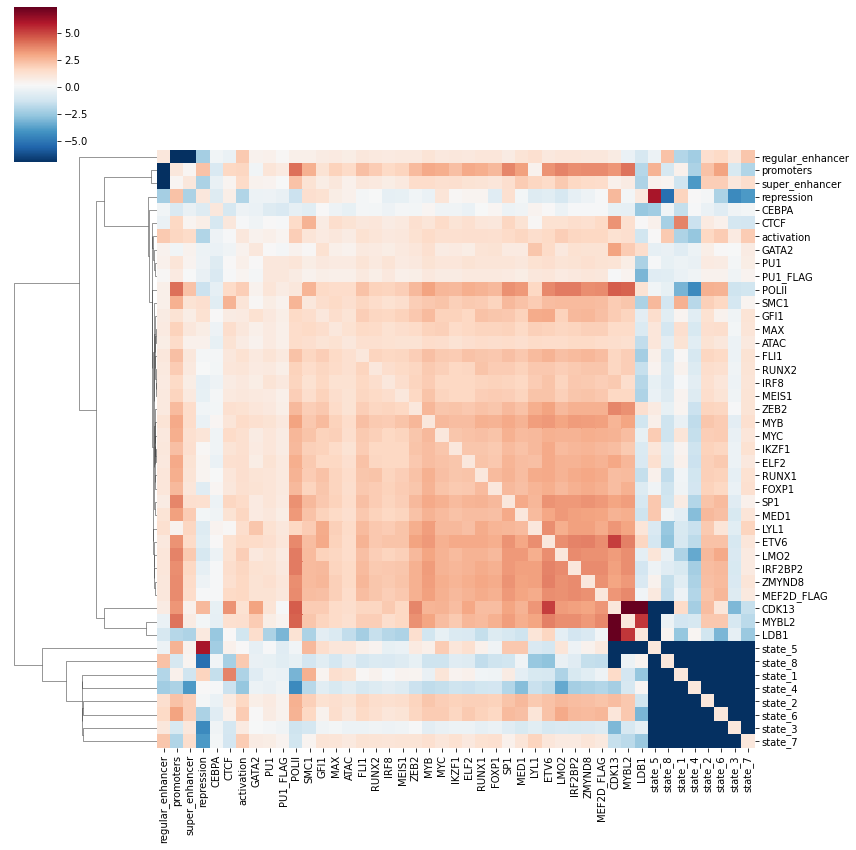

In [20]:
fig = sns.clustermap(enrichment,figsize=(12,12), vmin=-7, cmap='RdBu_r')
fig.ax_col_dendrogram.set_visible(False)
fig.savefig("../results/cobinding/enrichment_all.pdf")
plt.show()

## TODO

### plots during merge

- plot a histogram (bincount) of the signal for each peaks:
    - peaks in A, B
    - unique peaks in A, B
    - peaks in merged version (avg)
    - scatter plot matrix of signal correlation between 1to1 for all
- print average size in unique vs overlap peaks
- ratios of unique peaks to total peaks for each TF

### plots after merge

- create a correlation plot on 1to1 overlap only.
- histogram of number of peaks per amount of TF cobound
- create a correlation matrix only on A's peakset
- create a normalized overlap matrix (given the number of peaks and total peakset, what is the expected overlap and how far away are we from it) z-score norm
- create a clustermap over peaks



### improving merge

- analyse only when peak is supported by two replicates
- remove GSE1 and CDK13 from cobinding matrix
- do quantile normalization over the signals (after setting up the zeroes)
- removing bad chips:
    - look, when badchip only does not correlate with anything else..
- do log2+1 transform

  
### peak enrichment
- **use chromHMM
    - use the Chipseq data we have (RNApol2, CTCF...)
- filter weird enrichments (not in H3k27ac? in H4me3..)
- make super enhancer enrichment from superenhancer matrix
- enrichment in promoter super enhancer other enhancers
- **merge the clusters and display enrichment of each (in TF and other marks)


### Next step:

- do cobinding based on gene targeted from ABC-model and merge the same way as before (mean value); merge enrichments as well
- look at data targetting CRC members
- look for enrichment at the gene level (from gene annotations)
- **compute/refine binding patterns
    - use MEME
    - motif enrichment in each merged peak set for each TF. do we see the right motifs to be enriched?
    - motif enrichment in cobinding peak set.
    - use DeepBind
- **look for difference in binding patterns to the litterature (db of binding patterns)
- ** from clusters, what type of binding patterns do we see in MV411?
    - all of them are here?
    - some of them. hypothesis 1: the other come randomly into a TAD. only the bound subset is important. we need to look at the binding of this subset only. because here is the binding code
    - randomly? after analysis of the enrichment of the genesets bound by the same set of TF we don't see much info.. hypothesis 1: 
- look for predictability of RNP expression change based on bound genes
    - do we see genes with opposite effects? 
    - can it be explained by the set of co-bound TFs?
- do dependency/expression prediction from all gene level features
    - look for most explanatory regressors
- repeat the process across all samples with H3K27ac+RNAseq data we have.
    - call mutations from H3k27ac data
    - MEME analysis of likely bound TFs, except if TF is not expressed
    - compute enrichments
    - from same gene assignements, as found on the general consensus peak set, can we find good dependency/expression prediction
- does location
    
### questions:

- how did andrew defined significant peaks?

## clustering cobinding signal

### using DBSCAN

In [ ]:
rand = np.random.choice(merged.index,5000)
viridis = cm.get_cmap('viridis', 256)
data = merged[merged.columns[-12:]]
for val in data.columns[:-4]:
    data[val] =stats.zscore(np.log2(1+data[val]))
    data[val] = (((data[val] -data[val].min())/ (data[val].max()))*256).astype(int)
#print(data['HMM_states'])
data = data.loc[rand]
for val in data.columns:
    a = [viridis(v) for v in data[val]]
    data[val] = a
data['HMM_states'] = [statetocol[i] for i in data['HMM_states']]
data = data.rename(columns={'SMC1':'cohesin','MED1':'mediator','ATAC':'open regions'})

In [4]:
cols = list(merged.columns[8:-4])
cols.remove('PU1')
data = stats.zscore(merged[cols].values)

In [40]:
rand = np.random.choice(merged.index,40000)

In [ ]:
#print(merged.columns[8:-4])
# https://scikit-learn.org/stable/modules/generated/sklearn.cluster.OPTICS.html#sklearn.cluster.OPTICS
groups = OPTICS(min_samples=200,n_jobs=8).fit_predict(data)

In [36]:
set(groups)

{0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19}

In [41]:
#https://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html#sklearn.cluster.KMeans
kmean = KMeans(n_clusters=14,n_jobs=8)
groups = kmean.fit_predict(data)
centroid = kmean.cluster_centers_

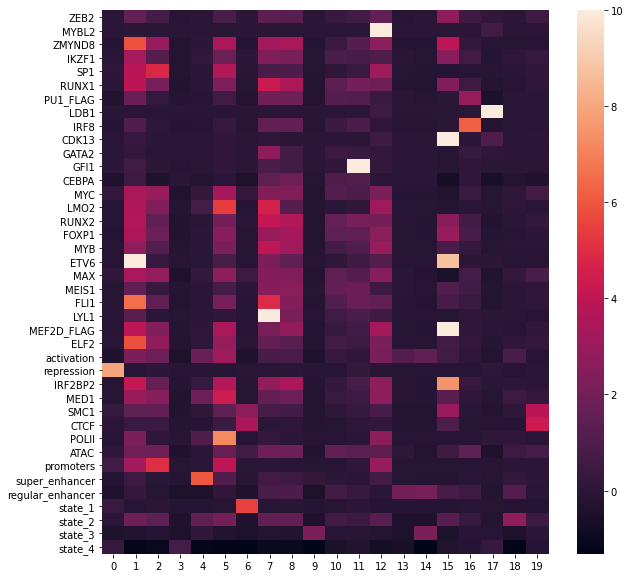

In [45]:
ig, ax = plt.subplots(figsize=(10,10)) 
sns.heatmap(pd.DataFrame(centroid,columns=cols).T,vmax=10,ax=ax)

In [52]:
subgroups = groups[rand]
sorting = np.argsort(subgroups)

viridis = cm.get_cmap('viridis', len(set(groups)))
colors = [viridis(i) for i in subgroups[sorting]]

In [55]:
colors[-400:]

[(0.866013, 0.889868, 0.095953, 1.0),
 (0.866013, 0.889868, 0.095953, 1.0),
 (0.866013, 0.889868, 0.095953, 1.0),
 (0.866013, 0.889868, 0.095953, 1.0),
 (0.866013, 0.889868, 0.095953, 1.0),
 (0.866013, 0.889868, 0.095953, 1.0),
 (0.866013, 0.889868, 0.095953, 1.0),
 (0.866013, 0.889868, 0.095953, 1.0),
 (0.866013, 0.889868, 0.095953, 1.0),
 (0.866013, 0.889868, 0.095953, 1.0),
 (0.866013, 0.889868, 0.095953, 1.0),
 (0.866013, 0.889868, 0.095953, 1.0),
 (0.866013, 0.889868, 0.095953, 1.0),
 (0.866013, 0.889868, 0.095953, 1.0),
 (0.866013, 0.889868, 0.095953, 1.0),
 (0.866013, 0.889868, 0.095953, 1.0),
 (0.866013, 0.889868, 0.095953, 1.0),
 (0.866013, 0.889868, 0.095953, 1.0),
 (0.866013, 0.889868, 0.095953, 1.0),
 (0.866013, 0.889868, 0.095953, 1.0),
 (0.866013, 0.889868, 0.095953, 1.0),
 (0.866013, 0.889868, 0.095953, 1.0),
 (0.866013, 0.889868, 0.095953, 1.0),
 (0.866013, 0.889868, 0.095953, 1.0),
 (0.866013, 0.889868, 0.095953, 1.0),
 (0.866013, 0.889868, 0.095953, 1.0),
 (0.866013, 

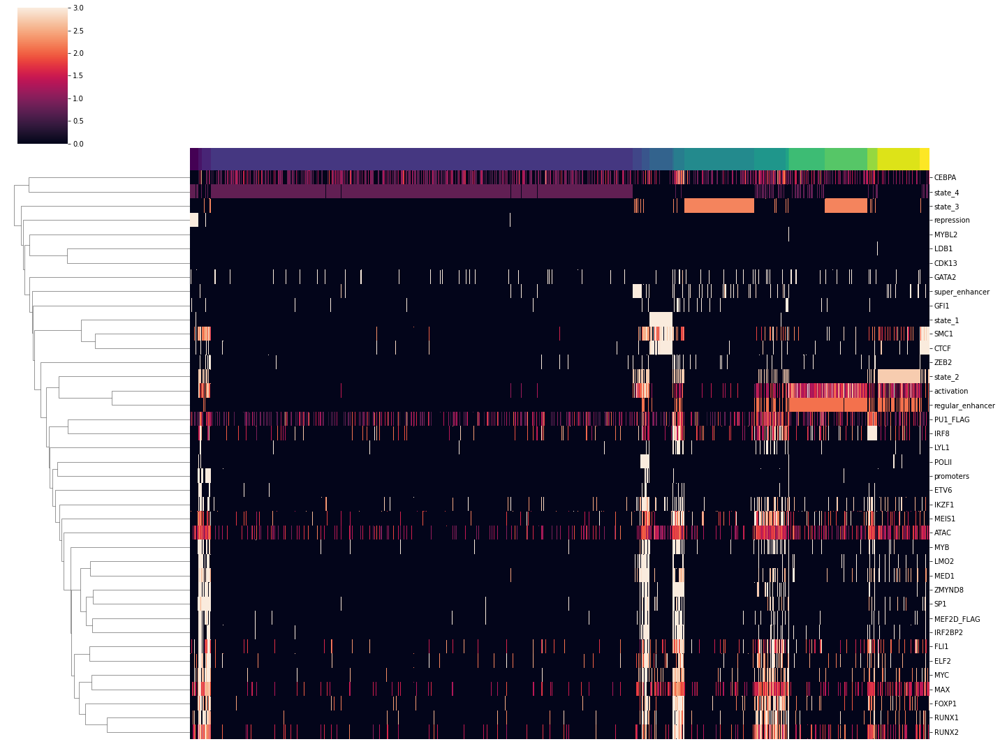

In [56]:
fig = sns.clustermap(np.log2(1.01+merged[cols].iloc[rand].iloc[sorting].T), vmin=0,vmax=3,figsize=(20,15),z_score=0,col_cluster=False,col_colors=colors, xticklabels=False)
fig.ax_col_dendrogram.set_visible(False)
fig.savefig('../temp/clustermap_cobinding_kmeans_clustered.pdf')
plt.show()

### Plot TSNE density map

In [12]:
scaled_data = (data - data.min(0))/data.max(0)

In [45]:
len(rand)

40000

In [ ]:
red_data = TSNE(2,10,verbose=10,n_iter=1500).fit_transform(scaled_data[rand])

[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 40000 samples in 1.471s...
[t-SNE] Computed neighbors for 40000 samples in 32.356s...
[t-SNE] Computed conditional probabilities for sample 1000 / 40000
[t-SNE] Computed conditional probabilities for sample 2000 / 40000
[t-SNE] Computed conditional probabilities for sample 3000 / 40000
[t-SNE] Computed conditional probabilities for sample 4000 / 40000
[t-SNE] Computed conditional probabilities for sample 5000 / 40000
[t-SNE] Computed conditional probabilities for sample 6000 / 40000
[t-SNE] Computed conditional probabilities for sample 7000 / 40000
[t-SNE] Computed conditional probabilities for sample 8000 / 40000
[t-SNE] Computed conditional probabilities for sample 9000 / 40000
[t-SNE] Computed conditional probabilities for sample 10000 / 40000
[t-SNE] Computed conditional probabilities for sample 11000 / 40000
[t-SNE] Computed conditional probabilities for sample 12000 / 40000
[t-SNE] Computed conditional probabilities for sa

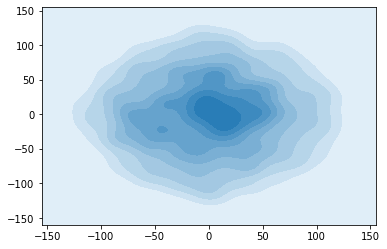

In [42]:
sns.kdeplot(red_data[:,0], red_data[:,1], shade=True)

In [48]:
red_data.shape

(10000, 2)

In [43]:
helper.bigScatter(red_data,binsize=2,showpoint=False)

PermissionError: [Errno 13] Permission denied: '/BigScatter_hex_plot.html'

### Using SOMs

In [232]:
#Import the library
import SimpSOM as sps

#Build a network 20x20 with a weights format taken from the raw_data and activate Periodic Boundary Conditions. 
net = sps.somNet(20,20, data, PBC=True)

#Train the network for 10000 epochs and with initial learning rate of 0.01. 
net.train(0.01, 10000)

#Save the weights to file
net.save('cobinding_SOMweights')

Periodic Boundary Conditions active.
The weights will be initialised randomly.
Training SOM... done! 


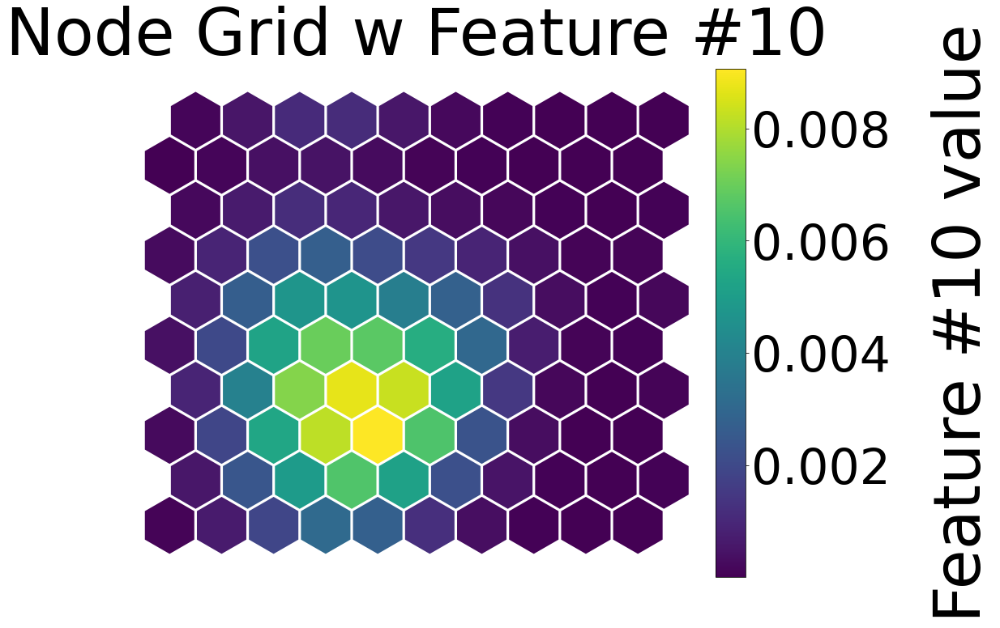

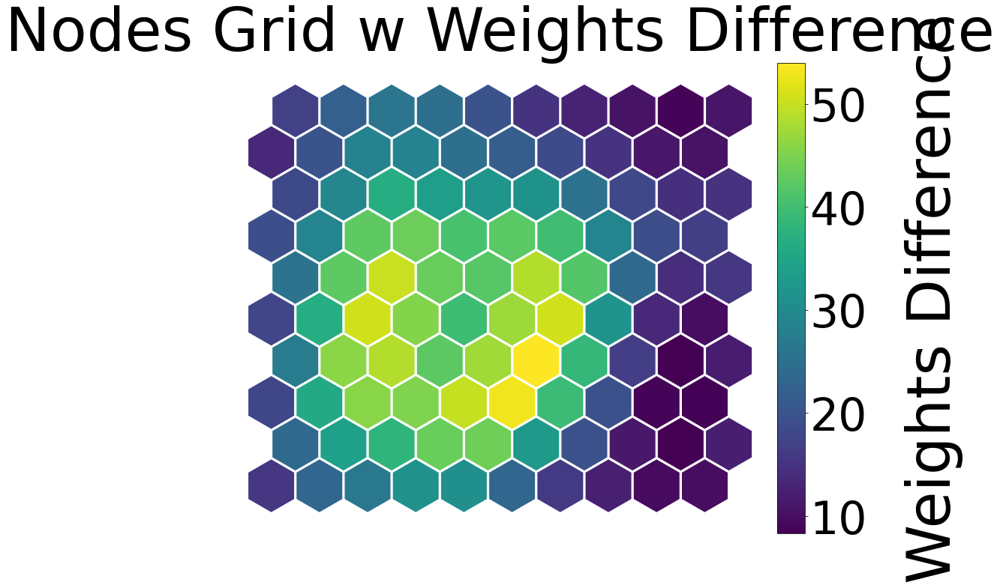

In [241]:
col=9
#Print a map of the network nodes and colour them according to the first feature (column number 0) of the dataset
#and then according to the distance between each node and its neighbours.
print(merged.columns[col])
net.nodes_graph(colnum=col)
net.diff_graph()

In [250]:
#Project the datapoints on the new 2D network map.
net.project(merged[merged.columns[8:]].values[:10])

[[0, 6.9282032302755105],
 [2, 0.0],
 [2, 0.0],
 [3, 6.9282032302755105],
 [8.5, 7.794228634059948],
 [2, 0.0],
 [1, 1.7320508075688776],
 [8.5, 7.794228634059948],
 [9.5, 7.794228634059948],
 [3, 1.7320508075688776]]

<Figure size 432x288 with 0 Axes>

In [ ]:
#Cluster the datapoints according to the Quality Threshold algorithm.
clusts = net.cluster(merged[merged.columns[8:]].values, type='DBSCAN')

## Doing Motif analysis

In [ ]:
## computing motif across the open region of the genome of MV411 from ATACseq with MEME.CentriMo

In [ ]:
## What are the motifs enriched for each cluster groups in the conscensus peak set? using MEME.centrimo (SOM group, DBSCAN group)

In [ ]:
## do we have better correlation if we remove cobinding event that don't have a related motif?

In [6]:
! gff2bed < ../../data/MEME/merged/fimo.gff > ../../data/MEME/merged/fimo.gff.bed

In [18]:
cols = ['ZEB2',
 'MYBL2',
 'ZMYND8',
 'IKZF1',
 'SP1',
 'RUNX1',
 'PU1_FLAG',
 'LDB1',
 'IRF8',
 'CDK13',
 'GATA2',
 'GFI1',
 'CEBPA',
 'MYC',
 'LMO2',
 'RUNX2',
 'FOXP1',
 'MYB',
 'ETV6',
 'MAX',
 'MEIS1',
 'FLI1',
 'LYL1',
 'MEF2D_FLAG',
 'ELF2']
rename = {'MEF2D_FLAG':'MEF2D','MYBL2':'MYBB',"PU1":'SPI1','PU1_FLAG':'SPI1'}
# TODO: find ZEB2, ZMYND8, LMO2, LDB1, CDK13 motifs

for k, val in rename.items():
     if k in cols:
        cols.remove(k)
        cols.append(val)

In [45]:
merged_motif = chiphelper.loadMEMEmotifs("../../data/MEME/merged/fimo.gff.bed", cols)

In [47]:
merged_motif

,chr,start,end,relStart,relEnd,strand,pval,p_val,q_val,tf,motif
0,10,100006094,100006886,405,418,-,46.4,2.3e-05,0.188,ELF2,AGACAGGAAGAGG
1,10,100006094,100006886,405,418,-,57.7,1.7e-06,0.0455,FLI1,AGACAGGAAGAGG
2,10,100006094,100006886,487,499,-,49.2,1.21e-05,0.656,MYB,GGAAGCCGTTGG
3,10,100006094,100006886,592,606,-,50.4,9.11e-06,0.148,RUNX2,TGGATGTGGGTTGG
4,10,100006094,100006886,696,713,-,72.9,5.1e-08,0.00159,SPI1,GAAATGAGGAAGTGAGC
...,...,...,...,...,...,...,...,...,...,...,...
1251596,Y,9991924,9992307,125,137,+,54.3,3.73e-06,0.0739,CEBPA,TGTGGTGCAATA
1251597,Y,9991924,9992307,131,143,-,41.9,6.4e-05,0.801,MEIS1,CTGATGTATTGC
1251598,Y,9991924,9992307,204,216,-,48.6,1.39e-05,0.635,MEIS1,ATGATTTATAAG
1251599,Y,9991924,9992307,266,278,-,44.8,3.3e-05,0.153,CEBPA,TATGGTGCAAGA


In [61]:
atac_motif = chiphelper.loadMEMEmotifs("../../data/MEME/ATAC/fimo.gff.bed", cols)

KeyboardInterrupt: 

In [65]:
merged_motif['end'] = merged_motif['end'].astype(int)
merged_motif['start'] = merged_motif['start'].astype(int)

In [66]:
chiphelper.simpleMergeMotifs([atac_motif,merged_motif])

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different motifs overlapping
found different moti

TypeError: '>' not supported between instances of 'int' and 'str'

In [ ]:
## what enrichment do we have in each group? what enrichment do we have for each ChipSeq?

In [ ]:
## computing predicted motif for each TF from Chip data MEME-Chip

In [ ]:
## comparing with the litterature using MEME.tomtom

In [ ]:
### loading motifs from 

## Assigning genes

### based on closest expressed gene

In [ ]:
chiphelper.AssignToClosestExpressed()

In [ ]:
### recompute cobinding based on this.

In [ ]:
## redo the plots. do we get better plots?/correlations?...

### based on the ABC model

![](images/ABCtitle.png)

They tested a new model based on and validated by CRISPRi-FlowFISH which is basically able to find enhancer mapping to genes. 
They used it to compute their model's Accuracy and found a 70% accuracy compared to less than 50% for closest expressed gene. 

Way to integrate our HiC data (need ATAC-seq like data as well, but openly available) 


![](images/ABCmodel.png)

In [ ]:
Helper.scatter(TSNE(2,5).fit_transform(data.T), labels=zones.columns[11:],colors=labels)

In [ ]:
### recompute cobinding based on this.

In [ ]:
### redo the plots. do we get better looking plots?

In [ ]:
### compare presence of CTCF and transcription of linked RNA

## Predict

In [ ]:
## make a linear model to with marks and cobinding data + cobinding motifs + expression of cobound proteins + expression , can we predict expression/dependenccy?

In [ ]:
## do the same on closest expressed gene

In [ ]:
## do this prediction on each enhancer.what is the best predicting enhancer? do that correlate with ABC model data?

In [ ]:
## do we get, for some gene, better single enhancer prediction?

In [ ]:
## what are the gene sets enriched in each clusters?? (based on TF cobinding or based on TF cobinding + )

## RNP data

In [ ]:
## can we predict RNP data (setting this TF to zero and lookingg at expected RNA change)

In [ ]:
## if we add RNP data, can we increase our model's prediction? (we have expression change and we set all RNPed-TF values to 0) 

In [ ]:
### to predict remaining X% RNA expression
### to predict remaining X TFs RNP
### to predict regular RNA expression

In [ ]:
## same thing with filtering base on motif presence (actual DNA binding)
## same thing with closest expressed gene

### Compare data with other labs (H3K27, HiC..)

we need to redo everything for similar normal cell type, getting TFs based on the CRC (find it with CRCmapper or on litterature)